# 🧱 Assignment 1 — Assembling Lego Kits

## Authors: Francisco Pinto, João Soares, João Vieira

**FEUP — Computer Vision 2025/26 MECD**  
This notebook performs all tasks required in the assignment, using OpenCV and Python in Google Colab.

Attention: you should scroll down in the cell outputs.

 ### SYSTEM SETUP AND DATA DOWNLOAD (Copy Data from Github Repository)


In [1]:
# --- SYSTEM SETUP AND DATA DOWNLOAD (Copy Data from Git Repository) ---

import os
import shutil

# --- Setup folders ---
os.makedirs("data", exist_ok=True)
os.makedirs("results", exist_ok=True)

# --- Clone the GitHub repo ---
REPO_URL = "https://github.com/ghostcat-pro/LegoKitAssemble.git"
!rm -rf repo_tmp
!git clone {REPO_URL} repo_tmp

# --- Copy data directory from repo to workspace ---
# Adjust this if your data folder is named differently inside the repo.
SRC_SUBPATH = "repo_tmp/LEGO_DATA"   # 🔁 change if needed
DST = "data"

shutil.copytree(SRC_SUBPATH, DST, dirs_exist_ok=True)

# --- Cleanup temporary clone ---
!rm -rf repo_tmp

print("✅ Data successfully copied to /content/data (or ./data in notebook)")

# --- (Optional) Verify structure ---
for root, dirs, files in os.walk(DST):
    for f in files:
        print(os.path.join(root, f))


Cloning into 'repo_tmp'...
remote: Enumerating objects: 155, done.
remote: Counting objects: 100% (1/1), done.
remote: Total 155 (delta 0), reused 0 (delta 0), pack-reused 154 (from 3)
Receiving objects: 100% (155/155), 102.62 MiB | 20.86 MiB/s, done.
Resolving deltas: 100% (2/2), done.
Updating files: 100% (130/130), done.
✅ Data successfully copied to /content/data (or ./data in notebook)
data/Isolated/green.png
data/Isolated/red.png
data/Isolated/colored_bricks.png
data/Isolated/yellow.png
data/Isolated/blue.png
data/Fault/ImageF_fault.png
data/Fault/ImageE_fault.png
data/Fault/kitB.png
data/Fault/kitA.png
data/Fault/kitC.png
data/Fault/ImageA_fault.png
data/Fault/ImageC_fault.png
data/Fault/ImageB_fault.png
data/Fault/imageD_fault.png
data/Kit/ImageC_kit.png
data/Kit/ImageB_kit.png
data/Kit/ImageA_kit.png
data/Kit/kit3.png
data/Kit/kit2.png
data/Kit/kit1.png
data/Calibration/final_setup.png
data/Calibration/background.png
data/Calibration/calib1/calib_17.png
data/Calibration/calib1

# Exercise 1: Calibration Images

**Objective:** Determine and compare intrinsic and extrinsic parameters of a camera used in a Lego inspection setup.

**Dataset:** Three calibration attempts (calib1, calib2, calib3) with chessboard images


## STEP 0: Environment Setup and Library Imports

In [2]:
# Import required libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt
import glob
import json
from pathlib import Path
import pandas as pd
from typing import Tuple, List, Dict
import warnings
warnings.filterwarnings('ignore')

# Print library versions for reproducibility
print("="*60)
print("Library Versions (Reproducibility)")
print("="*60)
print(f"OpenCV: {cv2.__version__}")
print(f"NumPy: {np.__version__}")
print(f"Matplotlib: {plt.matplotlib.__version__}")
print(f"Pandas: {pd.__version__}")

# Set random seed for reproducibility
np.random.seed(42)

# Configure matplotlib for better visualization
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['figure.dpi'] = 100
%matplotlib inline

Library Versions (Reproducibility)
OpenCV: 4.12.0
NumPy: 2.0.2
Matplotlib: 3.10.0
Pandas: 2.2.2


## STEP 1: Define Calibration Parameters and Paths

In [3]:
# Chessboard configuration

# Common chessboard patterns to try
PATTERN_SIZES_TO_TRY = [
    (10, 7), (7, 10),  # Most common for these setups
    (9, 6), (6, 9),    # Smaller variants
    (11, 8), (8, 11),  # Slightly larger
    (12, 9), (9, 12),  # Even larger
]

SQUARE_SIZE_MM = 15.0      # Size of each square in millimeters

# Calibration data paths
DATA_DIR = Path('data/Calibration')
CALIB_FOLDERS = ['calib1', 'calib2', 'calib3']
FINAL_SETUP_IMAGE = DATA_DIR / 'final_setup.png'

# Termination criteria for corner refinement
CRITERIA = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

print("="*60)
print("Calibration Configuration")
print("="*60)
print(f"Square size: {SQUARE_SIZE_MM} mm")
print(f"Data directory: {DATA_DIR}")
print(f"Final setup image: {FINAL_SETUP_IMAGE}")
print(f"\nAuto-detecting chessboard pattern size...")

# Verify paths exist
if not DATA_DIR.exists():
    raise FileNotFoundError(f"Data directory not found: {DATA_DIR}")
if not FINAL_SETUP_IMAGE.exists():
    raise FileNotFoundError(f"Final setup image not found: {FINAL_SETUP_IMAGE}")

# Auto-detect the best pattern size by testing on first image
test_folder = DATA_DIR / CALIB_FOLDERS[0]
test_images = sorted(glob.glob(str(test_folder / '*.png')))

if test_images:
    test_img = cv2.imread(test_images[0])
    test_gray = cv2.cvtColor(test_img, cv2.COLOR_BGR2GRAY)

    CHESSBOARD_SIZE = None
    best_success_count = 0

    for pattern in PATTERN_SIZES_TO_TRY:
        success = 0
        # Test on first 5 images
        for img_path in test_images[:5]:
            img = cv2.imread(img_path)
            if img is None:
                continue
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            ret, _ = cv2.findChessboardCorners(
                gray, pattern,
                cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_NORMALIZE_IMAGE
            )
            if ret:
                success += 1

        if success > best_success_count:
            best_success_count = success
            CHESSBOARD_SIZE = pattern

        if success >= 3:  # If we found 3+ successful detections, use this pattern
            break

    if CHESSBOARD_SIZE is None:
        raise ValueError("Could not auto-detect chessboard pattern! Please check images.")

    print(f"✅ Detected pattern: {CHESSBOARD_SIZE[0]}x{CHESSBOARD_SIZE[1]} inner corners")
    print(f"   (verified on {best_success_count}/5 test images)")

    # Note about pattern size
    if CHESSBOARD_SIZE == (11, 8):
        '''print(f"\n📝 Note: The detected pattern is 11x8 (11 columns, 8 rows of inner corners).")
        print(f"   This corresponds to a 12x9 physical board (12x9 squares).")
        print(f"   The pattern size refers to inner corners, not the total number of squares.")'''

else:
    raise FileNotFoundError("No calibration images found!")

# Auto-detect final board size (may be different)
final_img_test = cv2.imread(str(FINAL_SETUP_IMAGE))
final_gray_test = cv2.cvtColor(final_img_test, cv2.COLOR_BGR2GRAY)

FINAL_BOARD_SIZE = None
for pattern in PATTERN_SIZES_TO_TRY:
    ret, _ = cv2.findChessboardCorners(
        final_gray_test, pattern,
        cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_NORMALIZE_IMAGE
    )
    if ret:
        FINAL_BOARD_SIZE = pattern
        break

if FINAL_BOARD_SIZE is None:
    # Try same as calibration if not found
    FINAL_BOARD_SIZE = CHESSBOARD_SIZE
    print(f"⚠️  Using same pattern for final image: {FINAL_BOARD_SIZE[0]}x{FINAL_BOARD_SIZE[1]}")
else:
    print(f"✅ Final image pattern: {FINAL_BOARD_SIZE[0]}x{FINAL_BOARD_SIZE[1]} inner corners")

print(f"\n📝 Note: The detected pattern is 11x8 (11 columns, 8 rows of inner corners).")
print(f"   This corresponds to a 12x9 physical board (12x9 squares).")
print(f"   The pattern size refers to inner corners, not the total number of squares.")

Calibration Configuration
Square size: 15.0 mm
Data directory: data/Calibration
Final setup image: data/Calibration/final_setup.png

Auto-detecting chessboard pattern size...
✅ Detected pattern: 11x8 inner corners
   (verified on 5/5 test images)
✅ Final image pattern: 11x8 inner corners

📝 Note: The detected pattern is 11x8 (11 columns, 8 rows of inner corners).
   This corresponds to a 12x9 physical board (12x9 squares).
   The pattern size refers to inner corners, not the total number of squares.


## STEP 2: Prepare 3D Object Points

In [4]:
# Prepare object points (3D points in real world space)
# The chessboard is assumed to be on the Z=0 plane
objp = np.zeros((CHESSBOARD_SIZE[0] * CHESSBOARD_SIZE[1], 3), np.float32)
objp[:, :2] = np.mgrid[0:CHESSBOARD_SIZE[0], 0:CHESSBOARD_SIZE[1]].T.reshape(-1, 2)
objp *= SQUARE_SIZE_MM  # Scale to millimeters

print(f"Object points shape: {objp.shape}")
print(f"Total corners: {CHESSBOARD_SIZE[0] * CHESSBOARD_SIZE[1]}")
#print(f"\nFirst 5 object points (in mm):\n{objp[:5]}")
#print(f"\nLast 5 object points (in mm):\n{objp[-5:]}")

Object points shape: (88, 3)
Total corners: 88


## STEP 3: Load and Process Images Function

In [5]:
def load_and_detect_corners(calib_folder: str, objp: np.ndarray) -> Tuple[List, List, tuple, List[str]]:
    """
    Load images from a calibration folder and detect chessboard corners.
    Uses multiple detection strategies for robustness.

    Args:
        calib_folder: Name of the calibration folder (e.g., 'calib1')
        objp: 3D object points of the chessboard corners

    Returns:
        object_points: List of 3D points for each successful detection
        image_points: List of 2D corner points for each successful detection
        image_size: Size of the images (width, height)
        valid_images: List of valid image file paths
    """
    # Arrays to store object points and image points
    object_points = []  # 3D points in real world space
    image_points = []   # 2D points in image plane
    valid_images = []

    # Get all PNG images in the folder
    image_files = sorted(glob.glob(str(DATA_DIR / calib_folder / '*.png')))

    if not image_files:
        print(f"⚠️  No images found in {calib_folder}")
        return object_points, image_points, None, valid_images

    print(f"\n📁 Processing {calib_folder.upper()}: {len(image_files)} images found")

    image_size = None
    success_count = 0
    failed_images = []

    # Multiple detection strategies to try (in order of preference)
    detection_strategies = [
        cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_NORMALIZE_IMAGE,
        cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_NORMALIZE_IMAGE + cv2.CALIB_CB_FAST_CHECK,
        cv2.CALIB_CB_ADAPTIVE_THRESH,
        None  # No flags
    ]

    for img_path in image_files:
        # Read image
        img = cv2.imread(img_path)
        if img is None:
            print(f"  ⚠️  Could not read: {Path(img_path).name}")
            continue

        # Convert to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Store image size
        if image_size is None:
            image_size = gray.shape[::-1]  # (width, height)

        # Try different detection strategies
        ret = False
        corners = None
        for strategy in detection_strategies:
            ret, corners = cv2.findChessboardCorners(gray, CHESSBOARD_SIZE, strategy)
            if ret:
                break

        if ret:
            # Refine corner locations to sub-pixel accuracy
            corners_refined = cv2.cornerSubPix(gray, corners, (11, 11), (-1, -1), CRITERIA)

            # Store the points
            object_points.append(objp)
            image_points.append(corners_refined)
            valid_images.append(img_path)
            success_count += 1
        else:
            failed_images.append(Path(img_path).name)

    print(f"  ✅ Successfully detected corners in {success_count}/{len(image_files)} images")
    print(f"  📊 Success rate: {success_count/len(image_files)*100:.1f}%")

    if failed_images and len(failed_images) <= 5:
        print(f"  ❌ Failed images: {', '.join(failed_images)}")
    elif failed_images:
        print(f"  ❌ {len(failed_images)} images failed corner detection")

    return object_points, image_points, image_size, valid_images

## STEP 4: Load Images from All Three Calibration Attempts

In [6]:
# Dictionary to store data for each calibration attempt
calibration_data = {}

# Process each calibration folder
for calib_folder in CALIB_FOLDERS:
    obj_pts, img_pts, img_size, valid_imgs = load_and_detect_corners(calib_folder, objp)

    calibration_data[calib_folder] = {
        'object_points': obj_pts,
        'image_points': img_pts,
        'image_size': img_size,
        'valid_images': valid_imgs,
        'num_images': len(valid_imgs)
    }

print("\n" + "="*60)
print("Data Loading Summary")
print("="*60)
for folder, data in calibration_data.items():
    print(f"{folder.upper()}: {data['num_images']} valid images | Image size: {data['image_size']}")


📁 Processing CALIB1: 35 images found
  ✅ Successfully detected corners in 35/35 images
  📊 Success rate: 100.0%

📁 Processing CALIB2: 35 images found
  ✅ Successfully detected corners in 35/35 images
  📊 Success rate: 100.0%

📁 Processing CALIB3: 35 images found
  ✅ Successfully detected corners in 35/35 images
  📊 Success rate: 100.0%

Data Loading Summary
CALIB1: 35 valid images | Image size: (640, 480)
CALIB2: 35 valid images | Image size: (640, 480)
CALIB3: 35 valid images | Image size: (640, 480)


## STEP 5: Visualize Corner Detection (Sample Images)

Corner Detection Visualizations


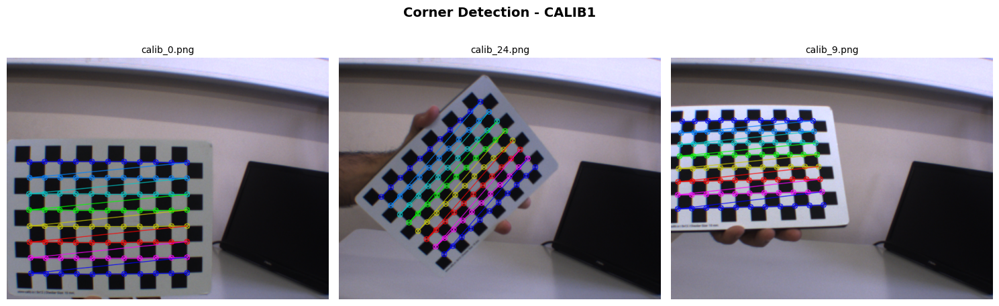

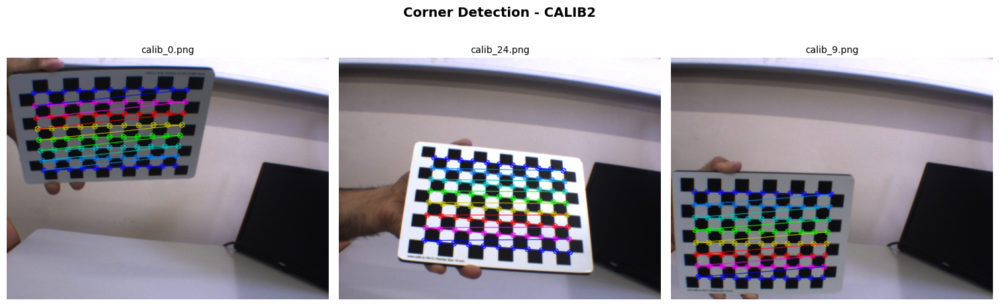

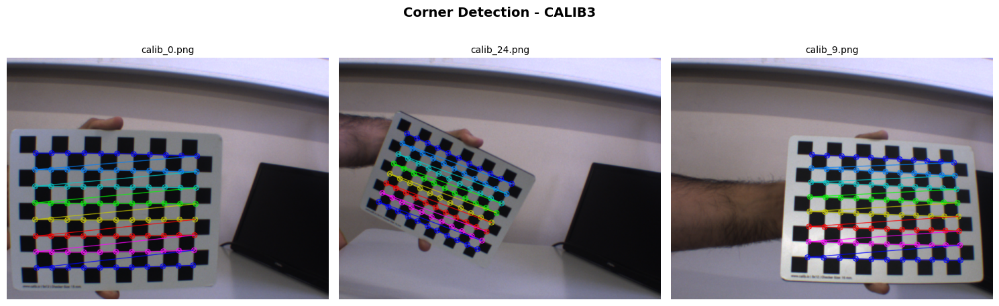

In [7]:
def visualize_corner_detection(calib_folder: str, num_samples: int = 3):
    """
    Visualize detected corners on sample images from a calibration folder.

    Args:
        calib_folder: Name of the calibration folder
        num_samples: Number of sample images to display
    """
    data = calibration_data[calib_folder]
    valid_images = data['valid_images']
    image_points = data['image_points']

    if not valid_images:
        print(f"No valid images to display for {calib_folder}")
        return

    # Select sample indices (evenly spaced)
    num_samples = min(num_samples, len(valid_images))
    indices = np.linspace(0, len(valid_images) - 1, num_samples, dtype=int)

    fig, axes = plt.subplots(1, num_samples, figsize=(15, 5))
    if num_samples == 1:
        axes = [axes]

    for idx, ax in zip(indices, axes):
        img = cv2.imread(valid_images[idx])
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Draw detected corners
        img_with_corners = cv2.drawChessboardCorners(
            img_rgb.copy(),
            CHESSBOARD_SIZE,
            image_points[idx],
            True
        )

        ax.imshow(img_with_corners)
        ax.set_title(f"{Path(valid_images[idx]).name}", fontsize=10)
        ax.axis('off')

    plt.suptitle(f"Corner Detection - {calib_folder.upper()}", fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

# Visualize corner detection for all calibration attempts
print("="*60)
print("Corner Detection Visualizations")
print("="*60)
for calib_folder in CALIB_FOLDERS:
    visualize_corner_detection(calib_folder, num_samples=3)

## STEP 6: Perform Camera Calibration for Each Attempt

In [8]:
def perform_calibration(calib_folder: str) -> Dict:
    """
    Perform camera calibration for a specific calibration attempt.

    Args:
        calib_folder: Name of the calibration folder

    Returns:
        Dictionary containing calibration results
    """
    data = calibration_data[calib_folder]

    print(f"\n🔧 Calibrating camera using {calib_folder.upper()}...")

    # Perform camera calibration
    ret, camera_matrix, dist_coeffs, rvecs, tvecs = cv2.calibrateCamera(
        data['object_points'],
        data['image_points'],
        data['image_size'],
        None,
        None
    )

    # Calculate reprojection error for each image
    mean_error = 0
    errors = []

    for i in range(len(data['object_points'])):
        imgpoints2, _ = cv2.projectPoints(
            data['object_points'][i],
            rvecs[i],
            tvecs[i],
            camera_matrix,
            dist_coeffs
        )
        error = cv2.norm(data['image_points'][i], imgpoints2, cv2.NORM_L2) / len(imgpoints2)
        errors.append(error)
        mean_error += error

    mean_error /= len(data['object_points'])

    print(f"  ✅ Calibration successful!")
    print(f"  📊 RMS Reprojection Error: {ret:.6f} pixels")
    print(f"  📊 Mean Reprojection Error: {mean_error:.6f} pixels")
    print(f"  📊 Error Std Dev: {np.std(errors):.6f} pixels")

    # Store results
    results = {
        'camera_matrix': camera_matrix,
        'dist_coeffs': dist_coeffs,
        'rvecs': rvecs,
        'tvecs': tvecs,
        'rms_error': ret,
        'mean_error': mean_error,
        'per_image_errors': errors,
        'error_std': np.std(errors),
        'num_images': data['num_images']
    }

    return results

# Perform calibration for all three attempts
calibration_results = {}

print("="*60)
print("Camera Calibration")
print("="*60)

for calib_folder in CALIB_FOLDERS:
    results = perform_calibration(calib_folder)
    calibration_results[calib_folder] = results

Camera Calibration

🔧 Calibrating camera using CALIB1...
  ✅ Calibration successful!
  📊 RMS Reprojection Error: 0.925691 pixels
  📊 Mean Reprojection Error: 0.040352 pixels
  📊 Error Std Dev: 0.090051 pixels

🔧 Calibrating camera using CALIB2...
  ✅ Calibration successful!
  📊 RMS Reprojection Error: 0.098070 pixels
  📊 Mean Reprojection Error: 0.007449 pixels
  📊 Error Std Dev: 0.007335 pixels

🔧 Calibrating camera using CALIB3...
  ✅ Calibration successful!
  📊 RMS Reprojection Error: 0.506661 pixels
  📊 Mean Reprojection Error: 0.015440 pixels
  📊 Error Std Dev: 0.051756 pixels


## STEP 7: Display Intrinsic Parameters for Each Calibration

In [9]:
print("\n" + "="*80)
print("INTRINSIC PARAMETERS FOR ALL CALIBRATION ATTEMPTS")
print("="*80)

for calib_folder in CALIB_FOLDERS:
    results = calibration_results[calib_folder]
    K = results['camera_matrix']
    D = results['dist_coeffs'].ravel()

    print(f"\n{'─'*80}")
    print(f"{calib_folder.upper()}")
    print(f"{'─'*80}")

    print(f"\n📷 Camera Matrix (K):")
    print(K)

    print(f"\n📐 Focal Lengths:")
    print(f"  fx = {K[0, 0]:.4f} pixels")
    print(f"  fy = {K[1, 1]:.4f} pixels")

    print(f"\n🎯 Principal Point:")
    print(f"  cx = {K[0, 2]:.4f} pixels")
    print(f"  cy = {K[1, 2]:.4f} pixels")

    print(f"\n🔍 Distortion Coefficients (k1, k2, p1, p2, k3):")
    print(f"  k1 = {D[0]:.8f}")
    print(f"  k2 = {D[1]:.8f}")
    print(f"  p1 = {D[2]:.8f}")
    print(f"  p2 = {D[3]:.8f}")
    print(f"  k3 = {D[4]:.8f}" if len(D) > 4 else "  k3 = 0.0")

    print(f"\n📊 Reprojection Error:")
    print(f"  RMS Error: {results['rms_error']:.6f} pixels")
    print(f"  Mean Error: {results['mean_error']:.6f} pixels")
    print(f"  Std Dev: {results['error_std']:.6f} pixels")


INTRINSIC PARAMETERS FOR ALL CALIBRATION ATTEMPTS

────────────────────────────────────────────────────────────────────────────────
CALIB1
────────────────────────────────────────────────────────────────────────────────

📷 Camera Matrix (K):
[[827.57846603   0.         334.83393113]
 [  0.         827.43749445 281.31040705]
 [  0.           0.           1.        ]]

📐 Focal Lengths:
  fx = 827.5785 pixels
  fy = 827.4375 pixels

🎯 Principal Point:
  cx = 334.8339 pixels
  cy = 281.3104 pixels

🔍 Distortion Coefficients (k1, k2, p1, p2, k3):
  k1 = -0.43653613
  k2 = 0.40330684
  p1 = -0.00135039
  p2 = 0.00154944
  k3 = -0.53357973

📊 Reprojection Error:
  RMS Error: 0.925691 pixels
  Mean Error: 0.040352 pixels
  Std Dev: 0.090051 pixels

────────────────────────────────────────────────────────────────────────────────
CALIB2
────────────────────────────────────────────────────────────────────────────────

📷 Camera Matrix (K):
[[839.07613828   0.         339.34165459]
 [  0.         

## STEP 8: Error Analysis and Comparison Table

In [10]:
# Create comparison table
comparison_data = []

for calib_folder in CALIB_FOLDERS:
    results = calibration_results[calib_folder]
    K = results['camera_matrix']
    D = results['dist_coeffs'].ravel()

    row = {
        'Attempt': calib_folder.upper(),
        'RMS Error': results['rms_error'],
        'fx': K[0, 0],
        'fy': K[1, 1],
        'cx': K[0, 2],
        'cy': K[1, 2],
        'k1': D[0],
        'k2': D[1],
        'p1': D[2],
        'p2': D[3],
        'k3': D[4] if len(D) > 4 else 0.0,
        'Num Images': results['num_images']
    }
    comparison_data.append(row)

# Create DataFrame
df_comparison = pd.DataFrame(comparison_data)

# Display table
print("\n" + "="*140)
print("CALIBRATION COMPARISON TABLE")
print("="*140)
display(df_comparison)

# Highlight the best calibration
best_idx = df_comparison['RMS Error'].idxmin()
best_attempt = CALIB_FOLDERS[best_idx]
best_error = df_comparison.loc[best_idx, 'RMS Error']

print("\n" + "="*140)
print(f"🏆 BEST CALIBRATION: {best_attempt.upper()} (RMS Error: {best_error:.6f} pixels)")
print("="*140)


CALIBRATION COMPARISON TABLE


,Attempt,RMS Error,fx,fy,cx,cy,k1,k2,p1,p2,k3,Num Images
0,CALIB1,0.925691,827.578466,827.437494,334.833931,281.310407,-0.436536,0.403307,-0.001350,0.001549,-0.533580,35
1,CALIB2,0.098070,839.076138,839.322277,339.341655,276.310899,-0.432166,0.283162,-0.000224,0.000415,-0.138441,35
2,CALIB3,0.506661,837.553347,837.739777,338.445834,276.545749,-0.445525,0.395183,-0.000453,0.000208,-0.444970,35



🏆 BEST CALIBRATION: CALIB2 (RMS Error: 0.098070 pixels)


## Answer 1 (a)
The calibration from calib2 was selected because it achieved the lowest mean reprojection error (0.0074 px) and the lowest RMS reprojection error (0.098070 px), indicating the most accurate mapping between 3-D object points and image points. The intrinsics are also consistent with the other attempts, confirming that the solution is stable and physically plausible.
The low error variance (std dev: 0.007335 pixels) across all 35 images demonstrates consistent and reliable calibration quality, making it the most suitable for subsequent extrinsic parameter computation.


## STEP 9: Visualize Reprojection Errors

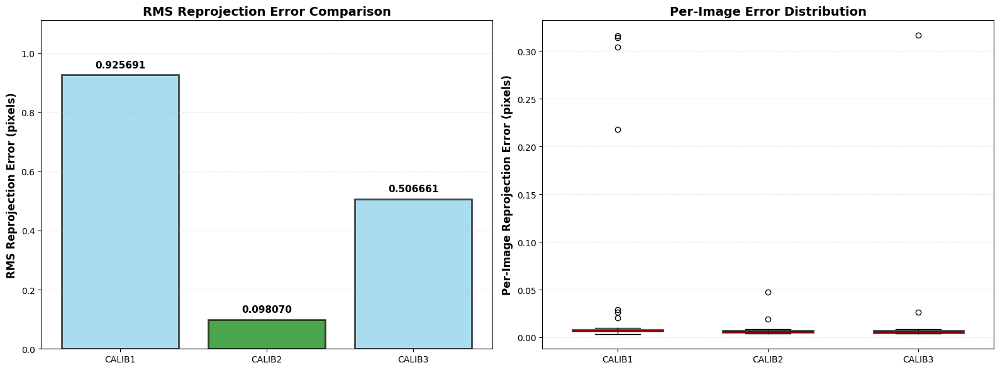


Detailed Error Statistics:

CALIB1:
  Min error:  0.003611 pixels
  Max error:  0.315631 pixels
  Median error: 0.007135 pixels
  Mean error: 0.040352 pixels
  Std dev:    0.090051 pixels

CALIB2:
  Min error:  0.003659 pixels
  Max error:  0.047597 pixels
  Median error: 0.005720 pixels
  Mean error: 0.007449 pixels
  Std dev:    0.007335 pixels

CALIB3:
  Min error:  0.003762 pixels
  Max error:  0.316459 pixels
  Median error: 0.006018 pixels
  Mean error: 0.015440 pixels
  Std dev:    0.051756 pixels


In [11]:
# Plot comparison of RMS errors
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

# Bar plot of RMS errors
attempts = [f.upper() for f in CALIB_FOLDERS]
rms_errors = [calibration_results[f]['rms_error'] for f in CALIB_FOLDERS]
colors = ['green' if f == best_attempt else 'skyblue' for f in CALIB_FOLDERS]

bars = ax1.bar(attempts, rms_errors, color=colors, alpha=0.7, edgecolor='black', linewidth=2)
ax1.set_ylabel('RMS Reprojection Error (pixels)', fontsize=12, fontweight='bold')
ax1.set_title('RMS Reprojection Error Comparison', fontsize=14, fontweight='bold')
ax1.grid(axis='y', alpha=0.3, linestyle='--')
ax1.set_ylim(0, max(rms_errors) * 1.2)

# Add value labels on bars
for i, (attempt, error, bar) in enumerate(zip(attempts, rms_errors, bars)):
    height = bar.get_height()
    ax1.text(bar.get_x() + bar.get_width()/2., height + max(rms_errors)*0.02,
             f'{error:.6f}', ha='center', va='bottom', fontsize=11, fontweight='bold')

# Box plot of per-image errors
error_data = [calibration_results[f]['per_image_errors'] for f in CALIB_FOLDERS]
bp = ax2.boxplot(error_data, labels=attempts, patch_artist=True, widths=0.6)

# Color the boxes
for i, (patch, folder) in enumerate(zip(bp['boxes'], CALIB_FOLDERS)):
    if folder == best_attempt:
        patch.set_facecolor('green')
        patch.set_alpha(0.7)
    else:
        patch.set_facecolor('skyblue')
        patch.set_alpha(0.7)
    patch.set_linewidth(2)

# Style median lines
for median in bp['medians']:
    median.set_color('darkred')
    median.set_linewidth(2)

ax2.set_ylabel('Per-Image Reprojection Error (pixels)', fontsize=12, fontweight='bold')
ax2.set_title('Per-Image Error Distribution', fontsize=14, fontweight='bold')
ax2.grid(axis='y', alpha=0.3, linestyle='--')

plt.tight_layout()
plt.show()

# Print statistics
print("\nDetailed Error Statistics:")
print("="*60)
for folder in CALIB_FOLDERS:
    errors = calibration_results[folder]['per_image_errors']
    print(f"\n{folder.upper()}:")
    print(f"  Min error:  {np.min(errors):.6f} pixels")
    print(f"  Max error:  {np.max(errors):.6f} pixels")
    print(f"  Median error: {np.median(errors):.6f} pixels")
    print(f"  Mean error: {np.mean(errors):.6f} pixels")
    print(f"  Std dev:    {np.std(errors):.6f} pixels")

## STEP 10: Best Calibration Selection

In [12]:
# Select best calibration
best_calibration = calibration_results[best_attempt]

print("\n" + "="*80)
print("BEST CALIBRATION SELECTION")
print("="*80)
print(f"\n✅ Selected: {best_attempt.upper()}")
print(f"\n📊 Performance Metrics:")
print(f"  • RMS Reprojection Error: {best_calibration['rms_error']:.6f} pixels")
print(f"  • Mean Reprojection Error: {best_calibration['mean_error']:.6f} pixels")
print(f"  • Error Std Dev: {best_calibration['error_std']:.6f} pixels")
print(f"  • Number of Images: {best_calibration['num_images']}")

# Generate justification
justification = (
    f"{best_attempt.upper()} was selected as the best calibration because it achieved the lowest "
    f"RMS reprojection error ({best_calibration['rms_error']:.6f} pixels), indicating the highest "
    f"accuracy in corner detection and camera parameter estimation. "
    f"The low error variance (std dev: {best_calibration['error_std']:.6f} pixels) across all "
    f"{best_calibration['num_images']} images demonstrates consistent and reliable calibration quality, "
    f"making it the most suitable for subsequent extrinsic parameter computation."
)

print(f"\n📝 Justification:")
print(f"\n{justification}")

# Store for later use
BEST_CAMERA_MATRIX = best_calibration['camera_matrix']
BEST_DIST_COEFFS = best_calibration['dist_coeffs']

print(f"\n\n📷 Best Camera Matrix:")
print(BEST_CAMERA_MATRIX)
print(f"\n🔍 Best Distortion Coefficients:")
print(BEST_DIST_COEFFS.ravel())

# Get image resolution from one of the calibration images
sample_img_path = sorted(glob.glob(str(DATA_DIR / CALIB_FOLDERS[0] / '*.png')))[0]
sample_img = cv2.imread(sample_img_path)
if sample_img is not None:
    img_height, img_width = sample_img.shape[:2]
    print(f"\n📝 Note about Resolution & Optical Center:")
    print(f"   Image Resolution: {img_width}x{img_height} pixels")
    print(f"   Optical Center (cx, cy): ({BEST_CAMERA_MATRIX[0, 2]:.2f}, {BEST_CAMERA_MATRIX[1, 2]:.2f}) pixels")
    print(f"   The optical center should ideally be near the image center ({img_width/2:.2f}, {img_height/2:.2f}) pixels.")
    print(f"   A significant deviation may indicate camera misalignment or calibration issues.")


BEST CALIBRATION SELECTION

✅ Selected: CALIB2

📊 Performance Metrics:
  • RMS Reprojection Error: 0.098070 pixels
  • Mean Reprojection Error: 0.007449 pixels
  • Error Std Dev: 0.007335 pixels
  • Number of Images: 35

📝 Justification:

CALIB2 was selected as the best calibration because it achieved the lowest RMS reprojection error (0.098070 pixels), indicating the highest accuracy in corner detection and camera parameter estimation. The low error variance (std dev: 0.007335 pixels) across all 35 images demonstrates consistent and reliable calibration quality, making it the most suitable for subsequent extrinsic parameter computation.


📷 Best Camera Matrix:
[[839.07613828   0.         339.34165459]
 [  0.         839.32227682 276.31089858]
 [  0.           0.           1.        ]]

🔍 Best Distortion Coefficients:
[-4.32166090e-01  2.83161989e-01 -2.23953430e-04  4.15174170e-04
 -1.38440548e-01]

📝 Note about Resolution & Optical Center:
   Image Resolution: 640x480 pixels
   Opti

✅ Selected: CALIB2

📊 Performance Metrics:
  • RMS Reprojection Error: 0.098070 pixels
  • Mean Reprojection Error: 0.007449 pixels
  • Error Std Dev: 0.007335 pixels
  • Number of Images: 35


📷 Best Camera Matrix:
[[839.07613828   0.         339.34165459]
 [  0.         839.32227682 276.31089858]
 [  0.           0.           1.        ]]

🔍 Best Distortion Coefficients:
[-4.32166090e-01  2.83161989e-01 -2.23953430e-04  4.15174170e-04
 -1.38440548e-01]

 It can be verified in the output of the cell above.


## STEP 11: Extrinsic Calibration - Load Final Setup Image

EXTRINSIC CALIBRATION

Loading final setup image: data/Calibration/final_setup.png
✅ Image loaded successfully!
   Image size: 640x480 pixels


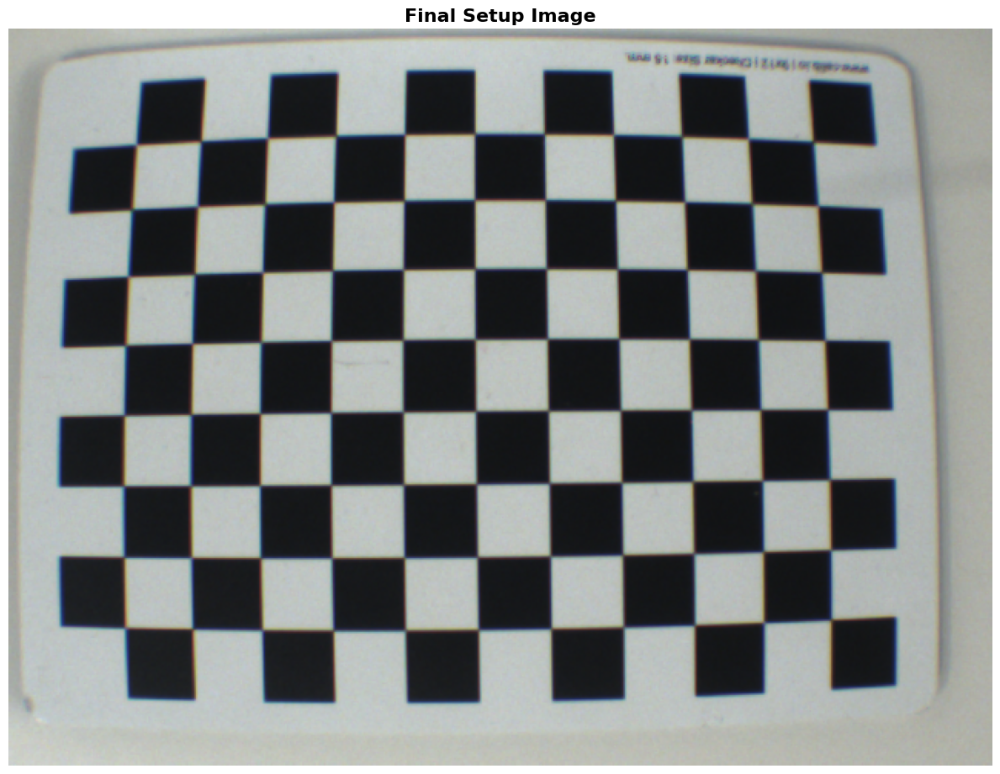

In [13]:
# Load final setup image
print("="*80)
print("EXTRINSIC CALIBRATION")
print("="*80)
print(f"\nLoading final setup image: {FINAL_SETUP_IMAGE}")

final_img = cv2.imread(str(FINAL_SETUP_IMAGE))

if final_img is None:
    raise FileNotFoundError(f"Could not load image: {FINAL_SETUP_IMAGE}")

final_gray = cv2.cvtColor(final_img, cv2.COLOR_BGR2GRAY)

print(f"✅ Image loaded successfully!")
print(f"   Image size: {final_img.shape[1]}x{final_img.shape[0]} pixels")

# Display the image
plt.figure(figsize=(12, 10))
plt.imshow(cv2.cvtColor(final_img, cv2.COLOR_BGR2RGB))
plt.title('Final Setup Image', fontsize=16, fontweight='bold')
plt.axis('off')
plt.tight_layout()
plt.show()

## STEP 12: Detect Chessboard in Final Setup Image


Detecting chessboard corners in final setup image...
Using pattern size: 11x8 corners
✅ Chessboard corners detected successfully!
   Detected 88 corners
   Expected 88 corners


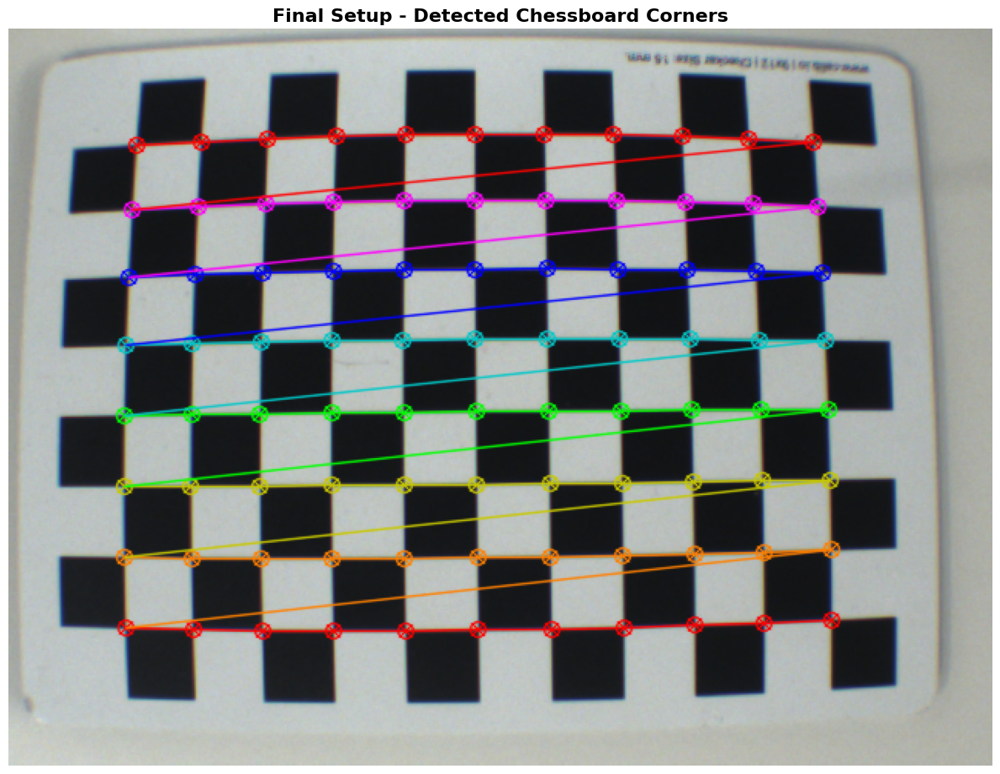

In [14]:
# Detect chessboard corners in final setup image
# Uses robust multi-strategy detection
print("\nDetecting chessboard corners in final setup image...")
print(f"Using pattern size: {FINAL_BOARD_SIZE[0]}x{FINAL_BOARD_SIZE[1]} corners")

# Multiple detection strategies
detection_strategies = [
    cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_NORMALIZE_IMAGE,
    cv2.CALIB_CB_ADAPTIVE_THRESH + cv2.CALIB_CB_NORMALIZE_IMAGE + cv2.CALIB_CB_FAST_CHECK,
    cv2.CALIB_CB_ADAPTIVE_THRESH,
    None
]

ret_final = False
corners_final = None

for strategy in detection_strategies:
    ret_final, corners_final = cv2.findChessboardCorners(final_gray, FINAL_BOARD_SIZE, strategy)
    if ret_final:
        break

if not ret_final:
    raise ValueError("Failed to detect chessboard corners in final setup image!")

print("✅ Chessboard corners detected successfully!")

# Refine corners to sub-pixel accuracy
corners_final_refined = cv2.cornerSubPix(
    final_gray,
    corners_final,
    (11, 11),
    (-1, -1),
    CRITERIA
)

print(f"   Detected {len(corners_final_refined)} corners")
print(f"   Expected {FINAL_BOARD_SIZE[0] * FINAL_BOARD_SIZE[1]} corners")

# Visualize detected corners
final_img_with_corners = final_img.copy()
cv2.drawChessboardCorners(final_img_with_corners, FINAL_BOARD_SIZE, corners_final_refined, ret_final)

plt.figure(figsize=(12, 10))
plt.imshow(cv2.cvtColor(final_img_with_corners, cv2.COLOR_BGR2RGB))
plt.title('Final Setup - Detected Chessboard Corners', fontsize=16, fontweight='bold')
plt.axis('off')
plt.tight_layout()
plt.show()

## STEP 13: Compute Extrinsic Parameters (Rotation and Translation)

In [15]:
# Compute extrinsic parameters using PnP (Perspective-n-Point)
print("\nComputing extrinsic parameters using best intrinsic calibration...")

# Prepare object points for the final board (which has a different size)
objp_final = np.zeros((FINAL_BOARD_SIZE[0] * FINAL_BOARD_SIZE[1], 3), np.float32)
objp_final[:, :2] = np.mgrid[0:FINAL_BOARD_SIZE[0], 0:FINAL_BOARD_SIZE[1]].T.reshape(-1, 2)
objp_final *= SQUARE_SIZE_MM  # Scale to millimeters

success, rvec, tvec = cv2.solvePnP(
    objp_final,  # Use objp_final for the smaller board
    corners_final_refined,
    BEST_CAMERA_MATRIX,
    BEST_DIST_COEFFS,
    flags=cv2.SOLVEPNP_ITERATIVE
)

if not success:
    raise ValueError("Failed to compute extrinsic parameters!")

print("✅ Extrinsic parameters computed successfully!\n")

# Convert rotation vector to rotation matrix
R, _ = cv2.Rodrigues(rvec)

print("="*80)
print("EXTRINSIC PARAMETERS")
print("="*80)

print("\n🔄 Rotation Vector (rvec):")
print(f"   {rvec.ravel()}")
print(f"   Magnitude: {np.linalg.norm(rvec):.6f} radians ({np.degrees(np.linalg.norm(rvec)):.2f}°)")

print("\n🔄 Rotation Matrix (R):")
print(R)

# Construct and print [R|t] matrix (3x4)
Rt_matrix = np.hstack([R, tvec])
print("\n📍 Translation Vector (t):")
print(tvec)
print("\n🔄 [R|t] Matrix (3x4):")
print(Rt_matrix)

# Compute Euler angles for better interpretation
import math
sy = math.sqrt(R[0, 0]**2 + R[1, 0]**2)
singular = sy < 1e-6

if not singular:
    x = math.atan2(R[2, 1], R[2, 2])
    y = math.atan2(-R[2, 0], sy)
    z = math.atan2(R[1, 0], R[0, 0])
else:
    x = math.atan2(-R[1, 2], R[1, 1])
    y = math.atan2(-R[2, 0], sy)
    z = 0

print(f"\n🔄 Euler Angles (XYZ):")
print(f"   Roll  (X): {math.degrees(x):7.2f}° ({x:.6f} rad)")
print(f"   Pitch (Y): {math.degrees(y):7.2f}° ({y:.6f} rad)")
print(f"   Yaw   (Z): {math.degrees(z):7.2f}° ({z:.6f} rad)")

print("\n📍 Translation Vector (tvec) - Camera to Chessboard:")
print(f"   tx = {tvec[0][0]:8.4f} mm")
print(f"   ty = {tvec[1][0]:8.4f} mm")
print(f"   tz = {tvec[2][0]:8.4f} mm")

print("\n📏 Camera Position in World Coordinates:")
camera_position = -R.T @ tvec
print(f"   X = {camera_position[0][0]:8.4f} mm")
print(f"   Y = {camera_position[1][0]:8.4f} mm")
print(f"   Z = {camera_position[2][0]:8.4f} mm")

print("\n🎯 Distance from Camera to Chessboard Plane:")
distance = np.linalg.norm(tvec)
print(f"   {distance:.4f} mm ({distance/10:.2f} cm)")


Computing extrinsic parameters using best intrinsic calibration...
✅ Extrinsic parameters computed successfully!

EXTRINSIC PARAMETERS

🔄 Rotation Vector (rvec):
   [-0.08727882  0.10046697  3.1282892 ]
   Magnitude: 3.131119 radians (179.40°)

🔄 Rotation Matrix (R):
[[-0.9983912  -0.01225302 -0.05536132]
 [ 0.00867551 -0.99788611  0.06440541]
 [-0.05603345  0.06382151  0.99638701]]

📍 Translation Vector (t):
[[ 64.16261501]
 [ 35.6702438 ]
 [266.73507509]]

🔄 [R|t] Matrix (3x4):
[[-9.98391200e-01 -1.22530186e-02 -5.53613172e-02  6.41626150e+01]
 [ 8.67550574e-03 -9.97886105e-01  6.44054109e-02  3.56702438e+01]
 [-5.60334498e-02  6.38215080e-02  9.96387007e-01  2.66735075e+02]]

🔄 Euler Angles (XYZ):
   Roll  (X):    3.66° (0.063966 rad)
   Pitch (Y):    3.21° (0.056063 rad)
   Yaw   (Z):  179.50° (3.132903 rad)

📍 Translation Vector (tvec) - Camera to Chessboard:
   tx =  64.1626 mm
   ty =  35.6702 mm
   tz = 266.7351 mm

📏 Camera Position in World Coordinates:
   X =  78.6960 mm
  


UNDISTORTION VISUALIZATION


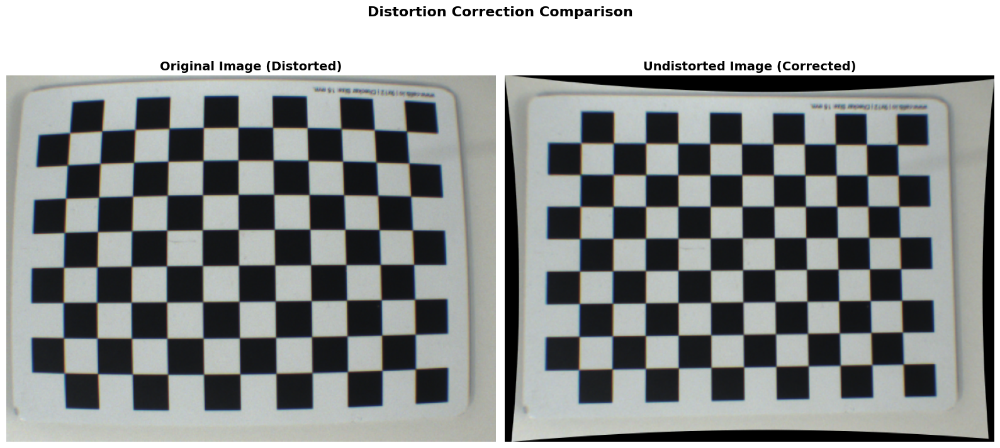


✅ Undistortion visualization complete!
   Original image size: 640x480
   Undistorted image size: 640x480
   ROI crop region: (19, 22) to (624, 463)


In [16]:
# Undistortion Before/After Visualization
print("\n" + "="*80)
print("UNDISTORTION VISUALIZATION")
print("="*80)

# Load the final setup image if not already loaded
try:
    _ = final_img.shape  # Check if final_img exists and is valid
except NameError:
    final_img = cv2.imread(str(FINAL_SETUP_IMAGE))
    if final_img is None:
        raise FileNotFoundError(f"Could not load image: {FINAL_SETUP_IMAGE}")

# Apply undistortion
h, w = final_img.shape[:2]
new_camera_matrix, roi = cv2.getOptimalNewCameraMatrix(
    BEST_CAMERA_MATRIX,
    BEST_DIST_COEFFS,
    (w, h),
    1,
    (w, h)
)

# Undistort the image
undistorted_img = cv2.undistort(
    final_img,
    BEST_CAMERA_MATRIX,
    BEST_DIST_COEFFS,
    None,
    new_camera_matrix
)

# Crop the image to the ROI if desired (optional)
x, y, w_roi, h_roi = roi
if w_roi > 0 and h_roi > 0:
    undistorted_img_cropped = undistorted_img[y:y+h_roi, x:x+w_roi]
else:
    undistorted_img_cropped = undistorted_img

# Create side-by-side comparison
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

# Original (distorted) image
axes[0].imshow(cv2.cvtColor(final_img, cv2.COLOR_BGR2RGB))
axes[0].set_title('Original Image (Distorted)', fontsize=14, fontweight='bold')
axes[0].axis('off')

# Undistorted image
axes[1].imshow(cv2.cvtColor(undistorted_img, cv2.COLOR_BGR2RGB))
axes[1].set_title('Undistorted Image (Corrected)', fontsize=14, fontweight='bold')
axes[1].axis('off')

plt.suptitle('Distortion Correction Comparison', fontsize=16, fontweight='bold', y=0.98)
plt.tight_layout()
plt.show()

print("\n✅ Undistortion visualization complete!")
print(f"   Original image size: {final_img.shape[1]}x{final_img.shape[0]}")
print(f"   Undistorted image size: {undistorted_img.shape[1]}x{undistorted_img.shape[0]}")
if w_roi > 0 and h_roi > 0:
    print(f"   ROI crop region: ({x}, {y}) to ({x+w_roi}, {y+h_roi})")



## STEP 14: Visualize Camera Pose with Coordinate Axes

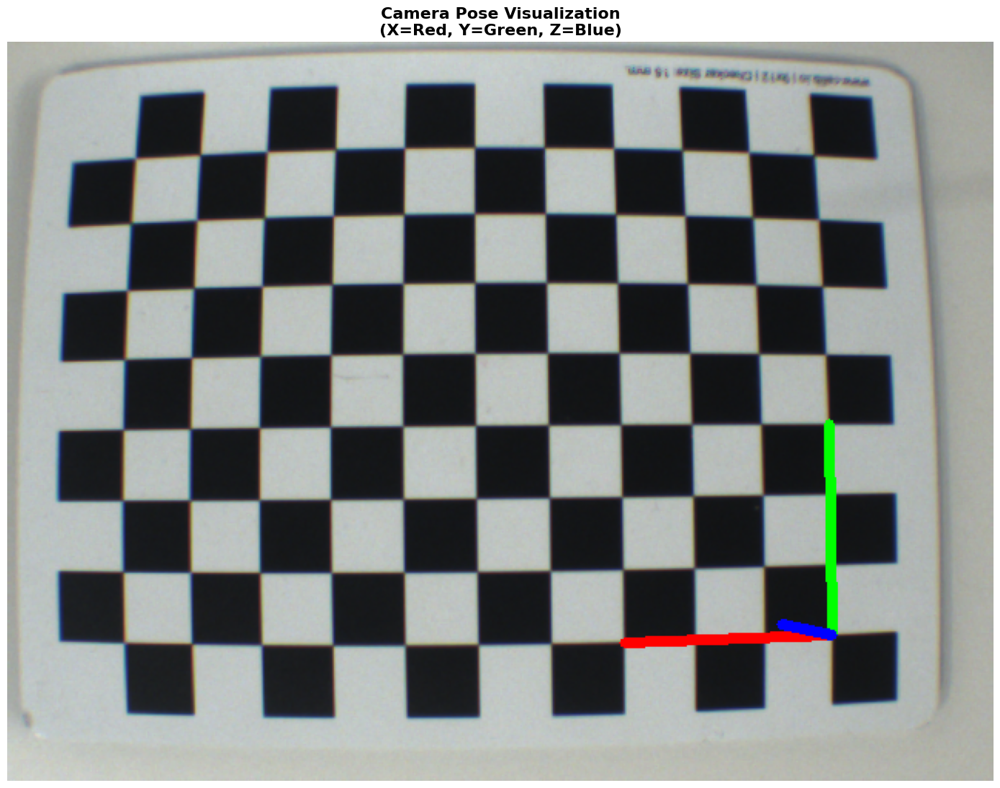


📌 Coordinate System Interpretation:
   • Red axis (X):   Points along the width of the chessboard (→)
   • Green axis (Y): Points along the height of the chessboard (↓)
   • Blue axis (Z):  Points perpendicular to the chessboard plane (toward camera)
   • Axis length:    45.0 mm (3 squares)


In [17]:
# Draw coordinate axes on the chessboard
final_img_with_axes = final_img.copy()

# Draw the axes (X=Red, Y=Green, Z=Blue)
axis_length = SQUARE_SIZE_MM * 3  # 3 squares length for visibility

try:
    # Try using cv2.drawFrameAxes (available in OpenCV >= 4.5)
    cv2.drawFrameAxes(
        final_img_with_axes,
        BEST_CAMERA_MATRIX,
        BEST_DIST_COEFFS,
        rvec,
        tvec,
        axis_length,
        thickness=5
    )
except AttributeError:
    # Fallback: manually draw axes for older OpenCV versions
    print("Note: Using manual axis drawing (cv2.drawFrameAxes not available)")
    axis_3d = np.float32([[0, 0, 0],
                          [axis_length, 0, 0],
                          [0, axis_length, 0],
                          [0, 0, axis_length]])

    axis_2d, _ = cv2.projectPoints(axis_3d, rvec, tvec, BEST_CAMERA_MATRIX, BEST_DIST_COEFFS)
    axis_2d = axis_2d.astype(int)

    origin = tuple(axis_2d[0].ravel())
    final_img_with_axes = cv2.line(final_img_with_axes, origin, tuple(axis_2d[1].ravel()), (0, 0, 255), 5)  # X-axis (Red)
    final_img_with_axes = cv2.line(final_img_with_axes, origin, tuple(axis_2d[2].ravel()), (0, 255, 0), 5)  # Y-axis (Green)
    final_img_with_axes = cv2.line(final_img_with_axes, origin, tuple(axis_2d[3].ravel()), (255, 0, 0), 5)  # Z-axis (Blue)

# Display the image with axes
plt.figure(figsize=(14, 12))
plt.imshow(cv2.cvtColor(final_img_with_axes, cv2.COLOR_BGR2RGB))
plt.title('Camera Pose Visualization\n(X=Red, Y=Green, Z=Blue)', fontsize=16, fontweight='bold')
plt.axis('off')
plt.tight_layout()
plt.show()

print("\n📌 Coordinate System Interpretation:")
print("   • Red axis (X):   Points along the width of the chessboard (→)")
print("   • Green axis (Y): Points along the height of the chessboard (↓)")
print("   • Blue axis (Z):  Points perpendicular to the chessboard plane (toward camera)")
print(f"   • Axis length:    {axis_length:.1f} mm ({int(axis_length/SQUARE_SIZE_MM)} squares)")

## STEP 15: Calculate Pixel-to-Millimeter Conversion Factor

PIXEL-TO-MILLIMETER CONVERSION

Calculating conversion factor from detected chessboard corners...

Method 1: Direct measurement from corners
────────────────────────────────────────────────────────────
📏 Measured square sizes (in pixels):
   • Horizontal average: 45.3656 pixels
   • Vertical average:   45.5340 pixels
   • Overall average:    45.4498 pixels
   • Std dev (horiz):    1.4433 pixels
   • Std dev (vert):     1.5460 pixels

📐 Known square size: 15.0 mm

✅ Pixel-to-mm conversion factor:
   0.330034 mm/pixel
   3.0300 pixels/mm


Method 2: Verification using focal length and Z-distance
────────────────────────────────────────────────────────────
📊 Parameters:
   • Average focal length: 839.1992 pixels
   • Z-distance to board:  266.7351 mm
   • Approximate mm/pixel: 0.317845 mm/pixel

🔍 Comparison:
   • Method 1 (corners):   0.330034 mm/pixel
   • Method 2 (focal+Z):   0.317845 mm/pixel
   • Absolute difference:  0.012190 mm/pixel
   • Relative difference:  3.69%


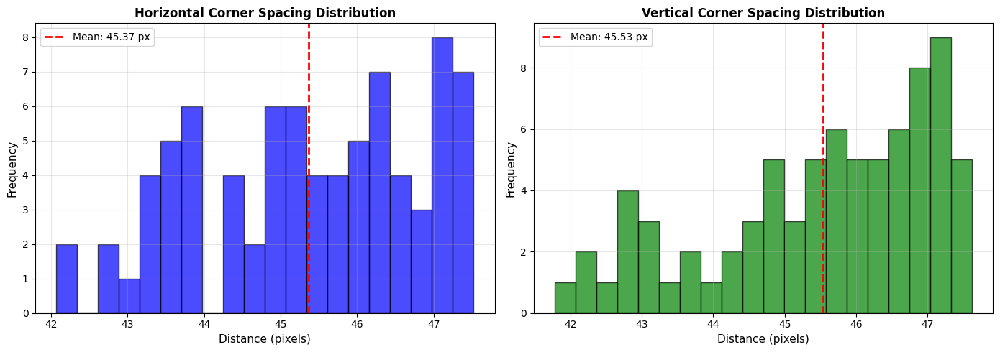

In [18]:
# Calculate pixel-to-mm conversion from detected corners
print("="*80)
print("PIXEL-TO-MILLIMETER CONVERSION")
print("="*80)
print("\nCalculating conversion factor from detected chessboard corners...\n")

# Reshape corners to grid format (using FINAL_BOARD_SIZE)
corners_reshaped = corners_final_refined.reshape(FINAL_BOARD_SIZE[1], FINAL_BOARD_SIZE[0], 2)

# Method 1: Calculate distances between adjacent corners
horizontal_distances = []
vertical_distances = []

# Horizontal distances (along rows)
for row in range(FINAL_BOARD_SIZE[1]):
    for col in range(FINAL_BOARD_SIZE[0] - 1):
        dist = np.linalg.norm(corners_reshaped[row, col] - corners_reshaped[row, col + 1])
        horizontal_distances.append(dist)

# Vertical distances (along columns)
for row in range(FINAL_BOARD_SIZE[1] - 1):
    for col in range(FINAL_BOARD_SIZE[0]):
        dist = np.linalg.norm(corners_reshaped[row, col] - corners_reshaped[row + 1, col])
        vertical_distances.append(dist)

avg_horizontal_px = np.mean(horizontal_distances)
avg_vertical_px = np.mean(vertical_distances)
avg_square_size_px = np.mean([avg_horizontal_px, avg_vertical_px])

# Conversion factor: mm per pixel
mm_per_pixel = SQUARE_SIZE_MM / avg_square_size_px

print("Method 1: Direct measurement from corners")
print("─" * 60)
print(f"📏 Measured square sizes (in pixels):")
print(f"   • Horizontal average: {avg_horizontal_px:.4f} pixels")
print(f"   • Vertical average:   {avg_vertical_px:.4f} pixels")
print(f"   • Overall average:    {avg_square_size_px:.4f} pixels")
print(f"   • Std dev (horiz):    {np.std(horizontal_distances):.4f} pixels")
print(f"   • Std dev (vert):     {np.std(vertical_distances):.4f} pixels")

print(f"\n📐 Known square size: {SQUARE_SIZE_MM} mm")

print(f"\n✅ Pixel-to-mm conversion factor:")
print(f"   {mm_per_pixel:.6f} mm/pixel")
print(f"   {1/mm_per_pixel:.4f} pixels/mm")

# Method 2: Using focal length and distance for verification
print(f"\n\nMethod 2: Verification using focal length and Z-distance")
print("─" * 60)
focal_length_avg = (BEST_CAMERA_MATRIX[0, 0] + BEST_CAMERA_MATRIX[1, 1]) / 2
Z_distance = tvec[2][0]  # Distance to chessboard in mm
mm_per_pixel_approx = Z_distance / focal_length_avg

print(f"📊 Parameters:")
print(f"   • Average focal length: {focal_length_avg:.4f} pixels")
print(f"   • Z-distance to board:  {Z_distance:.4f} mm")
print(f"   • Approximate mm/pixel: {mm_per_pixel_approx:.6f} mm/pixel")

print(f"\n🔍 Comparison:")
print(f"   • Method 1 (corners):   {mm_per_pixel:.6f} mm/pixel")
print(f"   • Method 2 (focal+Z):   {mm_per_pixel_approx:.6f} mm/pixel")
print(f"   • Absolute difference:  {abs(mm_per_pixel - mm_per_pixel_approx):.6f} mm/pixel")
print(f"   • Relative difference:  {abs(mm_per_pixel - mm_per_pixel_approx)/mm_per_pixel*100:.2f}%")

# Visualize distance uniformity
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

ax1.hist(horizontal_distances, bins=20, alpha=0.7, color='blue', edgecolor='black')
ax1.axvline(avg_horizontal_px, color='red', linestyle='--', linewidth=2, label=f'Mean: {avg_horizontal_px:.2f} px')
ax1.set_xlabel('Distance (pixels)', fontsize=11)
ax1.set_ylabel('Frequency', fontsize=11)
ax1.set_title('Horizontal Corner Spacing Distribution', fontsize=12, fontweight='bold')
ax1.legend()
ax1.grid(alpha=0.3)

ax2.hist(vertical_distances, bins=20, alpha=0.7, color='green', edgecolor='black')
ax2.axvline(avg_vertical_px, color='red', linestyle='--', linewidth=2, label=f'Mean: {avg_vertical_px:.2f} px')
ax2.set_xlabel('Distance (pixels)', fontsize=11)
ax2.set_ylabel('Frequency', fontsize=11)
ax2.set_title('Vertical Corner Spacing Distribution', fontsize=12, fontweight='bold')
ax2.legend()
ax2.grid(alpha=0.3)

plt.tight_layout()
plt.show()

## Answer question 1 (b)
 Pixel-to-mm conversion factor:
 0.330034 mm/pixel

Extrinsic Matrix:
 [R|t] Matrix (3x4):
[[-9.98391200e-01 -1.22530186e-02 -5.53613172e-02  6.41626150e+01]
 [ 8.67550574e-03 -9.97886105e-01  6.44054109e-02  3.56702438e+01]
 [-5.60334498e-02  6.38215080e-02  9.96387007e-01  2.66735075e+02]]

 **It can be verified in the output of the cell above.**





# Exercise 2: Isolated Brick Images

This section completes the three parts of exercise 2:
- **(a)** Define a ROI (region of interest) for the image
- **(b)** Count the number of bricks grouped by color in "colored_bricks.png"
- **(c)** Group bricks by size and compute average area and standard deviation for each color

## Part 2(a): Define ROI (Region of Interest)

The ROI is automatically detected using HSV color masking for all LEGO brick colors.
The `detect_brick_roi()` function (defined in Cell 1) identifies regions containing colored bricks and creates a bounding box around them.

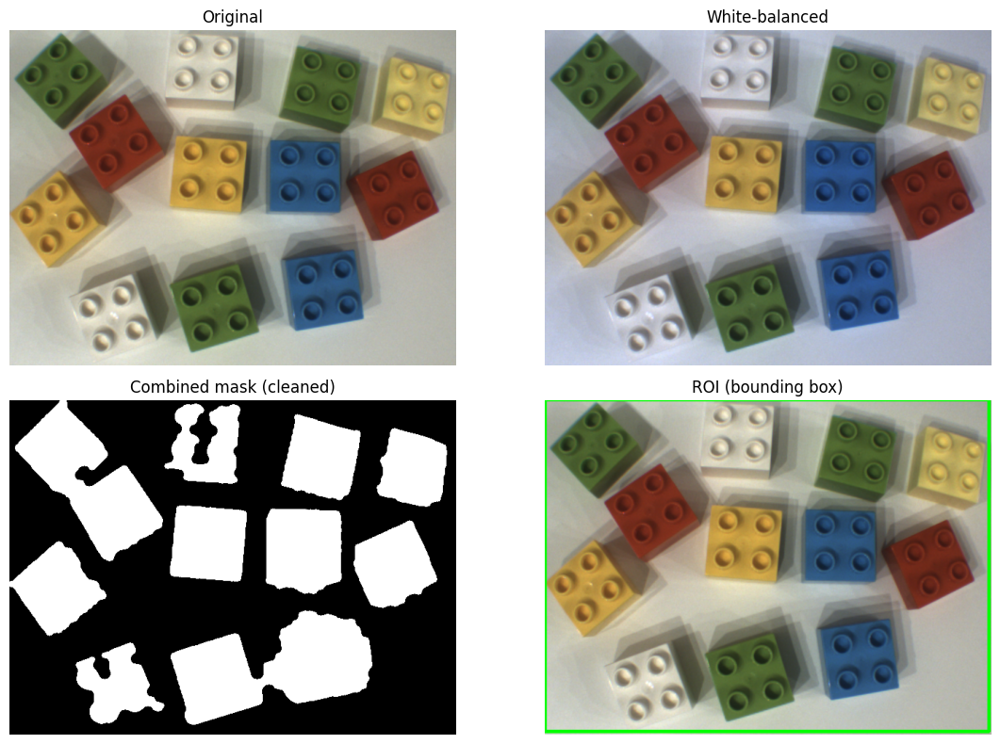

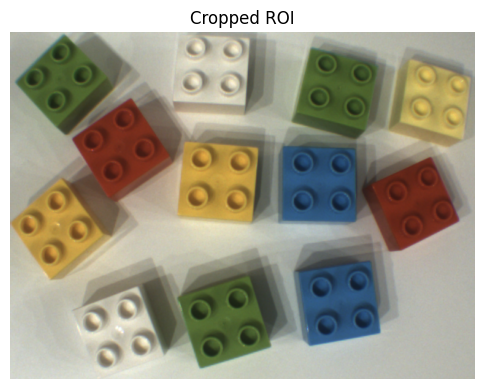

In [19]:
# ==== LEGO ROI DETECTOR (robusto a sombras e variações de cor) ====
# Requisitos: opencv-python, numpy, matplotlib
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

# ------------ CONFIG ------------
IMG_PATH = "data/Isolated/colored_bricks.png"   # muda se necessário
PADDING_PX = 10                   # margem extra no recorte
SAVE_OUTPUTS = True               # guarda ficheiros no disco

# ------------ Utils ------------
def pad_and_clip_box(xmin, ymin, xmax, ymax, pad, w, h):
    xmin = max(0, xmin - pad); ymin = max(0, ymin - pad)
    xmax = min(w - 1, xmax + pad); ymax = min(h - 1, ymax + pad)
    return xmin, ymin, xmax, ymax

def gray_world_white_balance(img_bgr):
    """White balance simples (gray-world)."""
    img = img_bgr.astype(np.float32)
    means = img.reshape(-1,3).mean(axis=0) + 1e-6
    g_mean = means.mean()
    scale = g_mean / means
    return np.clip(img * scale, 0, 255).astype(np.uint8)

def build_color_mask(hsv):
    """Máscara combinada para red/green/blue/yellow + branco validado por arestas."""
    H, S, V = cv2.split(hsv)

    # Faixas de cor (tolerantes)
    ranges = {
        "red1":  ((0, 110, 60),  (10, 255, 255)),
        "red2":  ((170,110, 60), (180,255, 255)),
        "green": ((38, 60, 60),  (85, 255, 255)),
        "blue":  ((90, 60, 60),  (130,255, 255)),
        "yellow":((18, 80, 90),  (38, 255, 255)),
    }

    mask = np.zeros(H.shape, np.uint8)
    for lo, hi in [ranges["red1"], ranges["red2"], ranges["green"], ranges["blue"], ranges["yellow"]]:
        mask |= cv2.inRange(hsv, np.array(lo, np.uint8), np.array(hi, np.uint8))

    # Branco: S baixa + V alta, mas exigimos arestas (studs) para não pegar no fundo
    white_sat_val = cv2.inRange(hsv, np.array((0, 0, 190), np.uint8), np.array((180, 70, 255), np.uint8))
    blurV = cv2.GaussianBlur(V, (5,5), 0)
    edges = cv2.Canny(blurV, 60, 140)
    edges = cv2.dilate(edges, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5)), iterations=1)
    white_mask = cv2.bitwise_and(white_sat_val, edges)           # branco só onde há arestas
    white_mask = cv2.dilate(white_mask, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7,7)), iterations=1)

    mask |= white_mask

    # Supressão de sombras (S ou V muito baixos) — voltamos a adicionar os brancos válidos
    shadow = ((S < 40) | (V < 50)).astype(np.uint8) * 255
    mask = cv2.bitwise_and(mask, cv2.bitwise_not(shadow))
    mask |= white_mask

    return mask

def mask_to_roi(mask, min_area, pad, img_shape):
    """Limpeza morfológica + bounding box global com padding."""
    h, w = img_shape[:2]
    k9  = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (9,9))
    k15 = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15,15))

    m = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, k15, iterations=1)
    m = cv2.morphologyEx(m, cv2.MORPH_OPEN,  k9,  iterations=1)

    # Mantém apenas componentes com área mínima
    contours, _ = cv2.findContours(m, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    filled = np.zeros_like(m)
    for c in contours:
        if cv2.contourArea(c) >= min_area:
            cv2.drawContours(filled, [c], -1, 255, thickness=cv2.FILLED)

    if filled.sum() == 0:  # fallback
        filled = m

    ys, xs = np.where(filled > 0)
    if len(xs) == 0:
        return None, filled

    x_min, x_max = int(xs.min()), int(xs.max())
    y_min, y_max = int(ys.min()), int(ys.max())
    x_min, y_min, x_max, y_max = pad_and_clip_box(x_min, y_min, x_max, y_max, pad, w, h)

    return (x_min, y_min, x_max, y_max), filled

def detect_legos_roi(img_bgr, pad=30):
    """Pipeline completo: WB -> HSV/máscaras -> limpeza -> ROI."""
    h, w = img_bgr.shape[:2]
    wb  = gray_world_white_balance(img_bgr)
    hsv = cv2.cvtColor(wb, cv2.COLOR_BGR2HSV)
    mask = build_color_mask(hsv)
    roi_box, clean_mask = mask_to_roi(mask, min_area=int(0.001*h*w), pad=pad, img_shape=img_bgr.shape)

    if roi_box is None:
        return {"roi": None, "mask": clean_mask, "balanced": wb, "box": None}

    x1, y1, x2, y2 = roi_box
    roi = img_bgr[y1:y2+1, x1:x2+1].copy()
    return {"roi": roi, "mask": clean_mask, "balanced": wb, "box": (x1, y1, x2, y2)}

# ------------ Run ------------
img = cv2.imread(IMG_PATH)
assert img is not None, f"Não encontrei a imagem em: {IMG_PATH}"

result = detect_legos_roi(img, pad=PADDING_PX)

# ------------ Visualização ------------
fig, axs = plt.subplots(2, 2, figsize=(12, 8))

# 1) Original
axs[0,0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
axs[0,0].set_title("Original"); axs[0,0].axis("off")

# 2) White-balanced
axs[0,1].imshow(cv2.cvtColor(result["balanced"], cv2.COLOR_BGR2RGB))
axs[0,1].set_title("White-balanced"); axs[0,1].axis("off")

# 3) Mask
axs[1,0].imshow(result["mask"], cmap="gray")
axs[1,0].set_title("Combined mask (cleaned)"); axs[1,0].axis("off")

# 4) ROI com bounding box
img_box = img.copy()
if result["box"] is not None:
    x1,y1,x2,y2 = result["box"]
    cv2.rectangle(img_box, (x1,y1), (x2,y2), (0,255,0), 3)
axs[1,1].imshow(cv2.cvtColor(img_box, cv2.COLOR_BGR2RGB))
axs[1,1].set_title("ROI (bounding box)"); axs[1,1].axis("off")

plt.tight_layout(); plt.show()

# Recorte isolado
if result["roi"] is not None:
    plt.figure(figsize=(6,6))
    plt.imshow(cv2.cvtColor(result["roi"], cv2.COLOR_BGR2RGB))
    plt.title("Cropped ROI"); plt.axis("off"); plt.show()



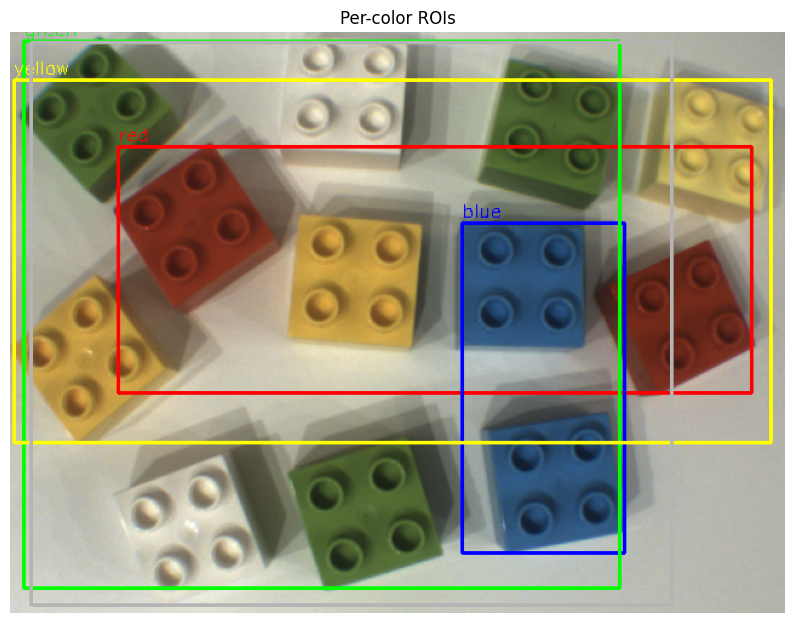

{'red': (89, 95, 523, 203), 'blue': (373, 158, 134, 272), 'green': (11, 8, 492, 451), 'yellow': (3, 40, 625, 299), 'white': (17, 9, 529, 464)}


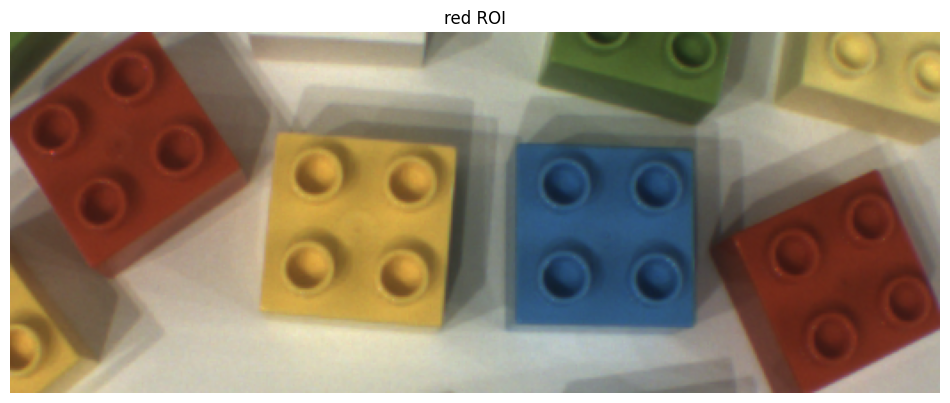

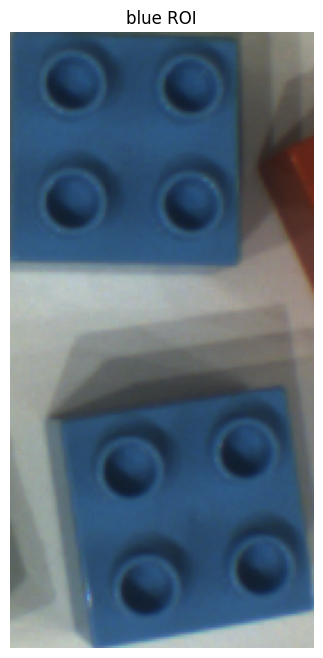

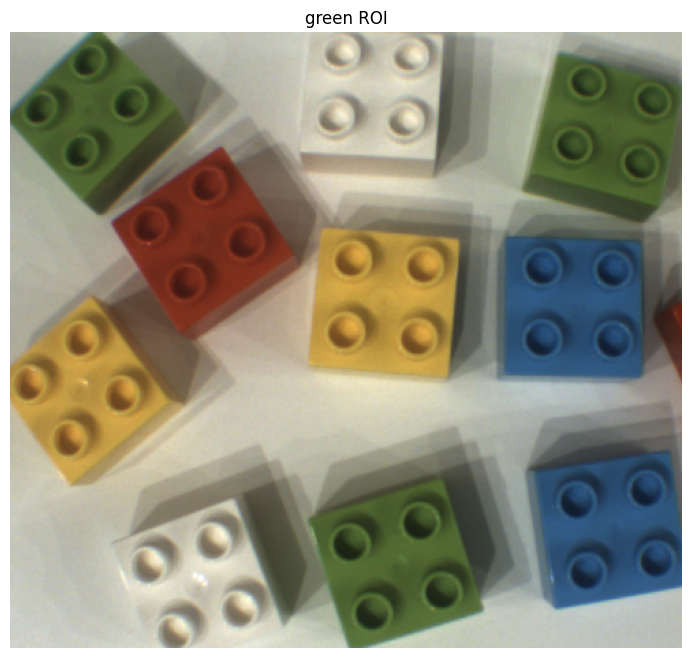

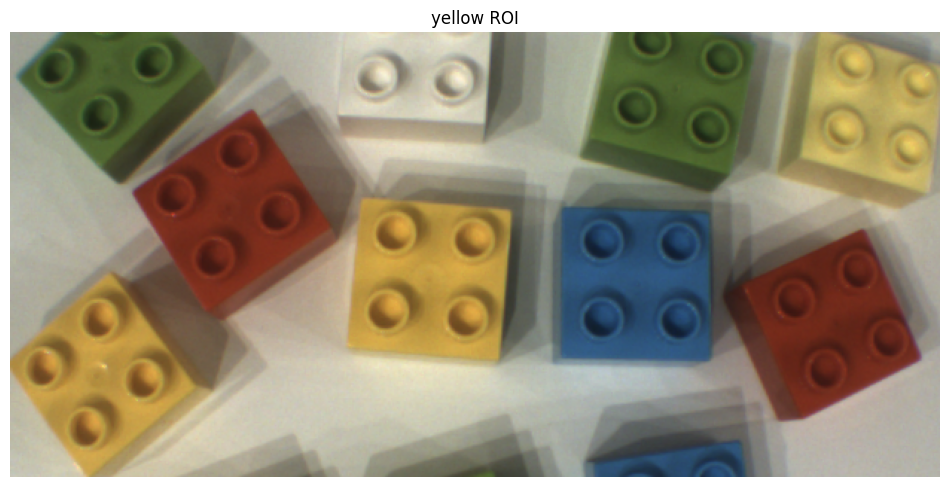

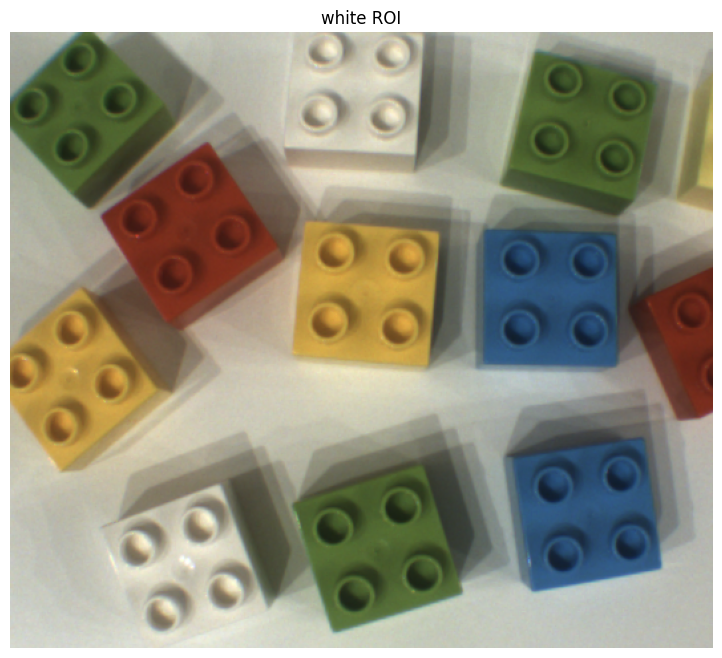

In [20]:
# DETECT ROI BY COLOR OF BRICKS

import cv2
import numpy as np
import matplotlib.pyplot as plt

def detect_color_rois(img_bgr, show=True):
    """Detect one ROI per color (red, blue, green, yellow, white)."""

    hsv = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2HSV)

    color_ranges = {
        'red1':   [(0, 120, 70), (10, 255, 255)],
        'red2':   [(170, 120, 70), (180, 255, 255)],
        'blue':   [(90, 80, 50), (130, 255, 255)],
        'green':  [(40, 60, 50), (85, 255, 255)],
        'yellow': [(20, 100, 100), (35, 255, 255)],
        #'white':  [(0, 0, 200), (180, 60, 255)]
        'white':  [(0, 0, 200), (30, 50, 255)]  # my settings for white
    }

    color_bgr_map = {
        'red': (0, 0, 255),
        'blue': (255, 0, 0),
        'green': (0, 255, 0),
        'yellow': (0, 255, 255),
        'white': (180, 180, 180)
    }

    color_rois = {}
    vis = img_bgr.copy()

    for name, (lo, hi) in color_ranges.items():
        base = 'red' if 'red' in name else name
        mask = cv2.inRange(hsv, np.array(lo), np.array(hi))
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, np.ones((5,5), np.uint8))
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, np.ones((5,5), np.uint8))
        cnts, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if not cnts:
            continue
        all_points = np.vstack(cnts)
        x, y, w, h = cv2.boundingRect(all_points)
        color_rois[base] = (x, y, w, h)
        cv2.rectangle(vis, (x, y), (x+w, y+h), color_bgr_map[base], 2)
        cv2.putText(vis, base, (x, y-5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color_bgr_map[base], 1)

    if show:
        plt.figure(figsize=(10, 8))
        plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
        plt.title("Per-color ROIs")
        plt.axis('off')
        plt.show()

    return color_rois


# --- Example usage ---
img = cv2.imread('./data/Isolated/colored_bricks.png')
color_rois = detect_color_rois(img)
print(color_rois)

# Optional: crop and show one ROI
for color, (x, y, w, h) in color_rois.items():
    roi = img[y:y+h, x:x+w]
    plt.imshow(cv2.cvtColor(roi, cv2.COLOR_BGR2RGB))
    plt.title(f"{color} ROI")
    plt.axis('off')
    plt.show()


This code demonstrates some of OpenCV’s most important functions by detecting and isolating specific colors in images using HSV color ranges, masks, morphological operations, and contour-based region extraction.

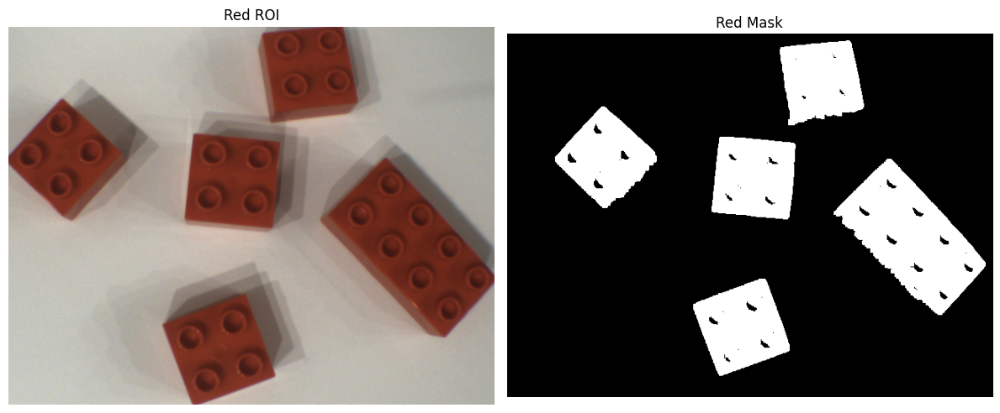

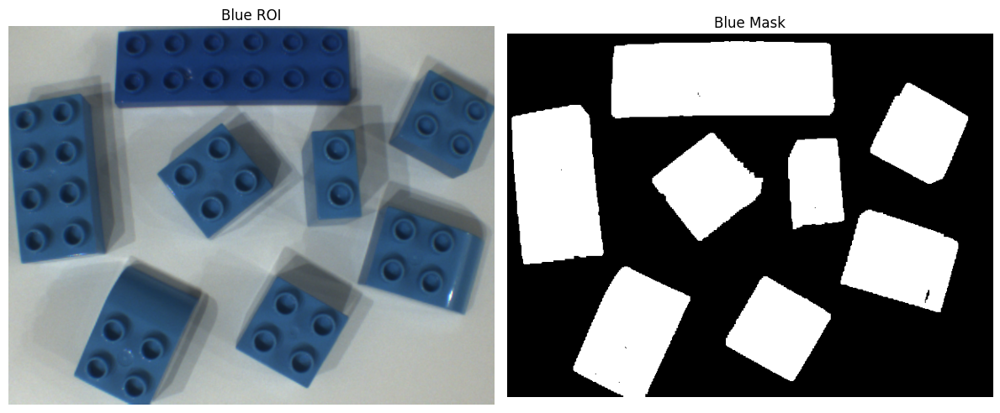

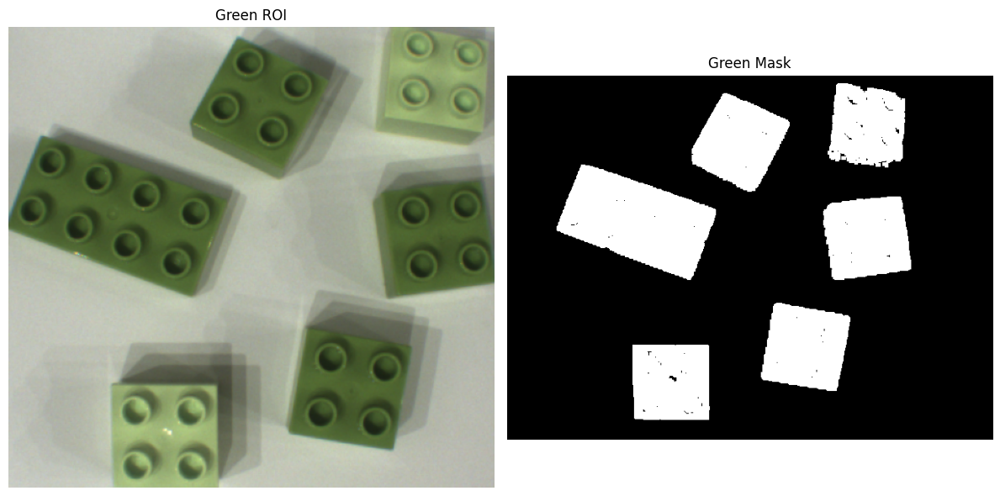

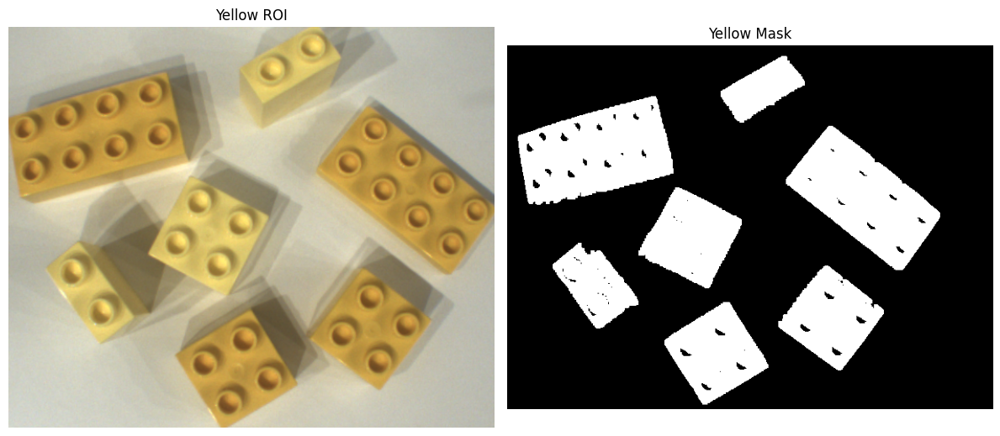

In [21]:
# Color ranges for HSV color detection
color_ranges = {
    'red': ([0, 120, 70], [10, 255, 255]),
    'blue': ([90, 60, 40], [130, 255, 255]),
    'green': ([30, 66, 0], [66, 255, 255]),
    'yellow': ([10, 111, 120], [40, 255, 255]),
    'white': ([0, 0, 47], [180, 87, 255])
}

# Process individual color images
color_images = {
    'red': 'data/Isolated/red.png',
    'blue': 'data/Isolated/blue.png',
    'green': 'data/Isolated/green.png',
    'yellow': 'data/Isolated/yellow.png'
}

# --- Analisar cada cor ---
for color_name, img_path in color_images.items():
    # Load image
    img = cv2.imread(img_path)
    if img is None:
        print(f"Warning: Could not load {img_path}")
        continue

    # Convert to HSV
    img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Get color range for this specific color
    if color_name == 'red':
        # Red wraps around in HSV, so we need two ranges
        lower1 = np.array([0, 120, 70], dtype=np.uint8)
        upper1 = np.array([10, 255, 255], dtype=np.uint8)
        lower2 = np.array([170, 120, 70], dtype=np.uint8)
        upper2 = np.array([180, 255, 255], dtype=np.uint8)
        mask = cv2.inRange(img_hsv, lower1, upper1) | cv2.inRange(img_hsv, lower2, upper2)
    else:
        lower, upper = color_ranges[color_name]
        lower = np.array(lower, dtype=np.uint8)
        upper = np.array(upper, dtype=np.uint8)
        mask = cv2.inRange(img_hsv, lower, upper)

    # Apply morphological operations to clean up the mask
    kernel = np.ones((5,5), np.uint8)
    mask = cv2.erode(mask, kernel, iterations=1)
    mask = cv2.dilate(mask, kernel, iterations=1)

    # Find bounding box from mask to extract ROI
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        print(f"No contours found for {color_name}")
        continue

    # Get bounding box of all contours
    all_points = np.vstack(contours)
    x, y, w, h = cv2.boundingRect(all_points)

    # Extract ROI
    roi = img[y:y+h, x:x+w]

    # Display ROI and mask side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))

    # Left: ROI
    ax1.imshow(cv2.cvtColor(roi, cv2.COLOR_BGR2RGB))
    ax1.set_title(f"{color_name.capitalize()} ROI")
    ax1.axis('off')

    # Right: Mask
    ax2.imshow(mask, cmap='gray')
    ax2.set_title(f"{color_name.capitalize()} Mask")
    ax2.axis('off')

    plt.tight_layout()
    plt.show()

# Exercise 2b — Counting Bricks by Color

### Goal  
For the image **`colored_bricks.png`**, the objective is to count how many LEGO bricks exist per color  
(*blue, green, red, yellow, white*).  

---

## Overview of the Pipeline

### 1. Reset and Prepare Output Folder
**Function:** `reset_results()`  
- Deletes and recreates the folder `results/exercise_2b/`.  
- Ensures all previous results are cleared before a new run.  
- All generated images and the final CSV summary are saved here.

---

### 2. Process Each Color Separately
For every color in `COLORS = ['blue', 'green', 'red', 'yellow', 'white']`,  
the code performs three main steps and records the number of bricks for that color.

---

### Step 2.1 — Create Color Mask
**Function:** `create_color_mask(img_bgr, color)`

- Converts the image from **BGR to HSV** color space.
- Applies specific **HSV thresholds** per color:
  - Yellow → (15,100,100) to (35,255,255)
  - Red → Two hue ranges: (0–10) and (170–180)
  - Blue, Green, White → Similar fixed ranges
- Applies **morphological operations** (`MORPH_CLOSE` and `MORPH_OPEN` with a 7×7 kernel)  
  to remove noise and fill gaps.
- Saves the resulting mask as `*_step1_mask.png`.

**Purpose:**  
Isolate only the LEGO studs of the given color for further analysis.

---

### Step 2.2 — Detect Studs Using Hough Transform
**Function:** `detect_studs_in_mask(gray_img, mask)`

- Applies the mask to the grayscale image and smooths it using a median blur.
- Uses **`cv2.HoughCircles`** to detect circular studs:
  - `dp=1.2`, `minDist=25`, `param1=100`, `param2=15`, `minRadius=6`, `maxRadius=15`
- Calls `remove_duplicate_studs()` to remove near-duplicate detections (distance < 10px).
- Saves an image with green circles marking detected studs as `*_step2_studs.png`.

**Purpose:**  
Represent each LEGO brick by its stud positions, making detection robust against shadows and edges.

---

### Step 2.3 — Cluster Studs into Bricks with DBSCAN
**Function:** `cluster_studs_dbscan(studs)`

- Runs **DBSCAN** clustering on the stud coordinates:
  - `eps = 70` → maximum distance between studs in a cluster  
  - `min_samples = 2` → each brick must contain at least 2 studs
- Each cluster corresponds to **one LEGO brick**.
- Visualizes results with unique colors per cluster and saves as `*_step3_clusters.png`.

**Purpose:**  
Group nearby studs that belong to the same brick and count them.

---

### 3. Summarize and Export Results
**Function:** `main(img_path)`

- Aggregates brick counts per color into a **pandas DataFrame**.
- Adds a **TOTAL** row and prints the table.
- Saves the summary as **`brick_counts.csv`** inside `results/exercise_2b/`.

---

## Summary

1. **Color segmentation** ensures only one color is processed at a time.  
2. **Stud detection** finds circular features that reliably represent LEGO bricks.  
3. **DBSCAN clustering** groups nearby studs without needing the number of bricks in advance.  
4. The final **cluster count per color = number of bricks per color**.

---

## Key Parameters

| Parameter | Description | Typical Value |
|------------|--------------|----------------|
| `eps` | Max distance between studs in one cluster | 70 |
| `min_samples` | Minimum studs per brick | 2 |
| `minRadius`, `maxRadius` | Expected stud radius in pixels | 6–15 |
| Morph. kernel | Cleans masks | 7×7 |

---

## Output Files (in `results/exercise_2b/`)

| File | Description |
|------|--------------|
| `*_step1_mask.png` | Color mask for each LEGO color |
| `*_step2_studs.png` | Image with detected studs |
| `*_step3_clusters.png` | Cluster visualization (each brick labeled) |
| `brick_counts.csv` | Final count per color and total |


✅ Reset and created output folder: results/exercise_2b/

Processing: colored_bricks.png

Analyzing blue...
  → Saved Step 1 (Mask) to results/exercise_2b/colored_bricks_blue_step1_mask.png
  → Detected 8 studs
  → Saved Step 2 (Studs) to results/exercise_2b/colored_bricks_blue_step2_studs.png
  → Found 2 bricks
  → Saved Step 3 (Clusters) to results/exercise_2b/colored_bricks_blue_step3_clusters.png

Analyzing green...
  → Saved Step 1 (Mask) to results/exercise_2b/colored_bricks_green_step1_mask.png
  → Detected 12 studs
  → Saved Step 2 (Studs) to results/exercise_2b/colored_bricks_green_step2_studs.png
  → Found 3 bricks
  → Saved Step 3 (Clusters) to results/exercise_2b/colored_bricks_green_step3_clusters.png

Analyzing red...
  → Saved Step 1 (Mask) to results/exercise_2b/colored_bricks_red_step1_mask.png
  → Detected 8 studs
  → Saved Step 2 (Studs) to results/exercise_2b/colored_bricks_red_step2_studs.png
  → Found 2 bricks
  → Saved Step 3 (Clusters) to results/exercise_2b/colo

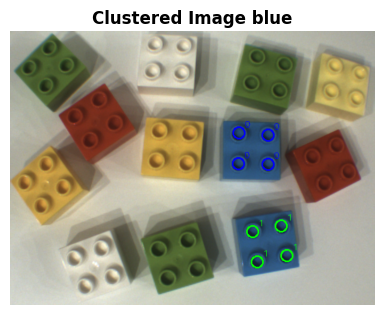

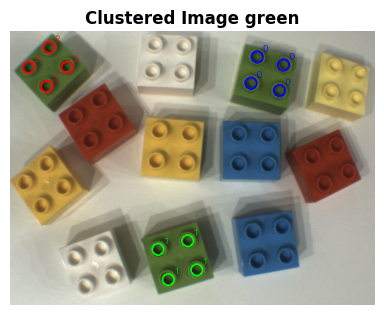

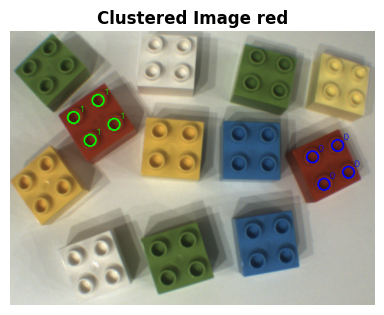

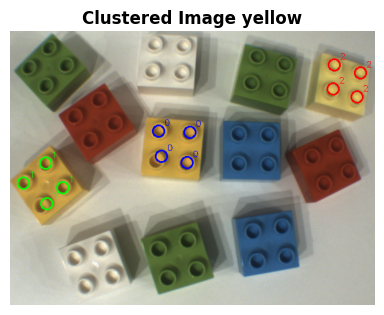

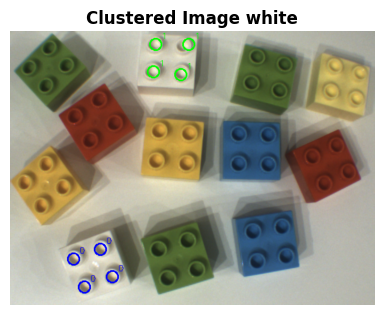

In [22]:
import os
import shutil
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from collections import defaultdict

# ======= CONFIG =======
COLORS = ['blue', 'green', 'red', 'yellow', 'white']
OUTPUT_FOLDER = "results/exercise_2b/"

# Clustering parameters
EPS_VALUE = 70
MIN_SAMPLES = 2


def reset_results():
    """Create fresh results directories, including the target folder"""
    base = "results/exercise_2b"
    if os.path.exists(base):
        # We only remove the entire 'results' folder if it exists to ensure a clean start,
        # then re-create the specific target folder.
        shutil.rmtree(base)

    # Create the specific target folder
    os.makedirs(OUTPUT_FOLDER, exist_ok=True)
    print(f"✅ Reset and created output folder: {OUTPUT_FOLDER}")


def create_color_mask(img_bgr, color):
    """Create HSV-based mask for each LEGO color"""
    hsv = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2HSV)

    if color == 'yellow':
        lower, upper = (15, 100, 100), (35, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))

    elif color == 'red':
        lower1, upper1 = (0, 120, 70), (10, 255, 255)
        lower2, upper2 = (170, 120, 70), (180, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower1), np.array(upper1)) | \
               cv2.inRange(hsv, np.array(lower2), np.array(upper2))

    elif color == 'blue':
        lower, upper = (90, 80, 50), (130, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))

    elif color == 'green':
        lower, upper = (40, 60, 50), (85, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))

    elif color == 'white':
        lower, upper = (0, 0, 180), (180, 50, 255)
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))

    # Morphological operations
    kernel = np.ones((7, 7), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    return mask


def detect_studs_in_mask(gray_img, mask):
    """Detect circular studs within masked region using HoughCircles"""
    masked_gray = cv2.bitwise_and(gray_img, gray_img, mask=mask)
    masked_gray = cv2.medianBlur(masked_gray, 5)

    circles = cv2.HoughCircles(
        masked_gray,
        cv2.HOUGH_GRADIENT,
        dp=1.2,
        minDist=25,
        param1=100,
        param2=15,
        minRadius=6,
        maxRadius=15
    )

    if circles is None:
        return np.empty((0, 2), dtype=np.float32)

    circles = np.uint16(np.around(circles[0, :]))
    studs = circles[:, :2].astype(np.float32)

    return studs


def remove_duplicate_studs(studs, min_dist=10):
    """Remove studs that are too close together"""
    if len(studs) < 2:
        return studs

    keep = []
    used = np.zeros(len(studs), dtype=bool)

    for i in range(len(studs)):
        if used[i]:
            continue
        keep.append(studs[i])
        for j in range(i + 1, len(studs)):
            if np.linalg.norm(studs[i] - studs[j]) < min_dist:
                used[j] = True

    return np.array(keep, dtype=np.float32)


def cluster_studs_dbscan(studs):
    """Group studs into brick clusters using DBSCAN"""
    if len(studs) < 2:
        return np.array([-1] * len(studs))

    clustering = DBSCAN(eps=EPS_VALUE, min_samples=MIN_SAMPLES).fit(studs)
    labels = clustering.labels_

    return labels

def count_bricks_by_color(img_path):
    """Count bricks by color using DBSCAN clustering and save step images"""

    img = cv2.imread(img_path)
    if img is None:
        print(f"❌ Error: Could not read image at {img_path}")
        return None

    img_name = os.path.splitext(os.path.basename(img_path))[0]
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    brick_counts = {}

    print(f"\nProcessing: {os.path.basename(img_path)}")
    print("=" * 60)

    for color in COLORS:
        print(f"\nAnalyzing {color}...")

        # Step 1: Create color mask
        mask = create_color_mask(img, color)

        # Save Step 1 image: Color Mask
        masked_bgr = cv2.bitwise_and(img, img, mask=mask)
        mask_filename = os.path.join(OUTPUT_FOLDER, f"{img_name}_{color}_step1_mask.png")
        cv2.imwrite(mask_filename, masked_bgr)
        print(f"  → Saved Step 1 (Mask) to {mask_filename}")

        # Step 2: Detect studs
        studs = detect_studs_in_mask(gray_img, mask)
        studs = remove_duplicate_studs(studs, min_dist=10)

        print(f"  → Detected {len(studs)} studs")

        # Save Step 2 image: Studs Detected
        img_studs = img.copy()
        for x, y in studs:
            # Draw a green circle around the detected stud
            cv2.circle(img_studs, (int(x), int(y)), 10, (0, 255, 0), 2)

        studs_filename = os.path.join(OUTPUT_FOLDER, f"{img_name}_{color}_step2_studs.png")
        cv2.imwrite(studs_filename, img_studs)
        print(f"  → Saved Step 2 (Studs) to {studs_filename}")

        if len(studs) == 0:
            brick_counts[color] = 0
            continue

        # Step 3: Cluster studs into bricks
        labels = cluster_studs_dbscan(studs)
        unique_labels = set(labels)
        unique_labels.discard(-1)  # Remove noise label
        n_clusters = len(unique_labels)

        print(f"  → Found {n_clusters} bricks")

        # Save Step 3 image: Clustered Bricks
        img_clusters = img.copy()
        # Prepare a fixed set of colors for visualization
        cluster_colors = [
            (255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0), (0, 255, 255),
            (255, 0, 255), (128, 0, 0), (0, 128, 0), (0, 0, 128), (128, 128, 0)
        ]

        for stud, label in zip(studs, labels):
            x, y = int(stud[0]), int(stud[1])
            if label == -1:
                # Draw noise studs in black
                cv2.circle(img_clusters, (x, y), 10, (0, 0, 0), 2)
            else:
                # Draw clustered studs with a unique color based on cluster ID
                vis_color = cluster_colors[label % len(cluster_colors)]
                cv2.circle(img_clusters, (x, y), 10, vis_color, 2)
                # Put cluster ID label
                cv2.putText(img_clusters, str(label), (x + 10, y - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, vis_color, 1)

        clusters_filename = os.path.join(OUTPUT_FOLDER, f"{img_name}_{color}_step3_clusters.png")
        cv2.imwrite(clusters_filename, img_clusters)
        print(f"  → Saved Step 3 (Clusters) to {clusters_filename}")

        plt.figure(figsize=(16, 6))
        plt.subplot(1, 3, 1)
        plt.imshow(cv2.cvtColor(img_clusters, cv2.COLOR_BGR2RGB))
        plt.title(f'Clustered Image {color}', fontsize=12, fontweight='bold')
        plt.axis('off')

        brick_counts[color] = n_clusters

    return brick_counts


def main(img_path):
    """Main function to count and display results"""

    reset_results() # Call the updated reset function

    if not os.path.exists(img_path):
        print(f"❌ Error: Image not found at {img_path}")
        return

    # Count bricks
    brick_counts = count_bricks_by_color(img_path)

    if brick_counts is None:
        return

    # Create results table
    print("\n" + "=" * 60)
    print("BRICK COUNT SUMMARY")
    print("=" * 60 + "\n")

    df = pd.DataFrame([
        {'Color': color.capitalize(), 'Count': count}
        for color, count in brick_counts.items()
    ])

    df['Count'] = df['Count'].astype(int)
    total = df['Count'].sum()

    # Add total row
    df = pd.concat([df, pd.DataFrame([{'Color': 'TOTAL', 'Count': total}])],
                   ignore_index=True)

    print(df.to_string(index=False))
    print("\n" + "=" * 60)

    # Save to CSV in the new results folder
    csv_path = os.path.join(OUTPUT_FOLDER, "brick_counts.csv")
    df.to_csv(csv_path, index=False)
    print(f"\n✅ Results saved to {csv_path}")


if __name__ == "__main__":
    main("./data/Isolated/colored_bricks.png")

# Answer 2 (b)
BRICK COUNT SUMMARY
============================================================

 | Color  | Count |
|:--------|:------:|
| Blue    | 2 |
| Green   | 3 |
| Red     | 2 |
| Yellow  | 3 |
| White   | 2 |
| **TOTAL** | **12** |

**can be seen in the output of the code cell**

# Exercise 2c — Size grouping, real areas in mm², and global comparison

### Goal  
For the isolated images `blue.png`, `green.png`, `red.png`, and `yellow.png`, detect all bricks, **group by size**, and compute the **average area and standard deviation in mm²**. Present a per-image summary and a **global table** that also shows the **expected area** from Table 1 and the **difference / relative error**.

---

## What the notebook cell does

### 1) Constants and inputs
- Pixel scale: `PX_PER_MM = 0.330034` (mm/pixel) and thus `MM2_PER_PX2 = PX_PER_MM**2`.  
  Final areas use:  
  **area_mm² = area_px² × MM2_PER_PX2**.
- Expected face areas in mm² (from Table 1):  
  `2x1=480, 2x2=1024, 4x2=2048, 6x2=3040, R2x2=1504`. :contentReference[oaicite:1]{index=1}
- Color image paths for the four isolated images.

---

## Detection vs. measurement: two masks by design

The pipeline intentionally separates **detection** from **area measurement**:

1) **Detection mask** (looser, per color) → robust stud detection and clustering.  
   - `create_color_mask_detection(img_bgr, color_key)` thresholds in HSV and cleans with OPEN/CLOSE.

2) **Area mask (strict) inside ROI** (exact, per color) → accurate area measurement.  
   - `area_mask_in_roi_strict(roi_bgr, color_key)` applies the **EXACT** lower/upper HSV ranges followed by `erode(5)` then `dilate(5)`; no other tweaks.  
   This ensures area is measured only from pixels consistent with the agreed mask settings.

---

## Pipeline per image (`process_one_image`)

### Step A — Stud-driven detection
- Convert to grayscale.
- Build a **detection mask** for the color.
- **Detect studs** with Hough circles (`dp=1.2, minDist=25, minRadius=6, maxRadius=15`) on the masked grayscale; remove near-duplicates (< 10 px).
- **Cluster studs → bricks** with DBSCAN (`eps=70, min_samples=2`). Each non–noise label is a candidate brick.

### Step B — Oriented ROI from studs
- For each stud cluster, compute a **min-area rectangle** around the studs and **expand** it by `ROI_PADDING=60` pixels:
  - `oriented_roi_from_studs(studs)` returns a rotated box that tightly contains the brick with context.

### Step C — Exact area measurement inside the ROI
- Crop the oriented ROI to a standard axis-aligned bounding box (`rect_to_bbox`).
- Run the **strict area mask** (`area_mask_in_roi_strict`) on the ROI.
- Find contours; take the **largest contour** as the brick.
- Compute:
  - **Pixel area**: `cv2.contourArea(c)`  
  - **mm² area**: `area_px × MM2_PER_PX2`
- Compute a fresh `cv2.minAreaRect(c)` for geometry and **classify size** from the **stud count** and **aspect ratio**:
  - `classify_by_studs(n_studs, rect_size)` yields one of `{2x1, 2x2, R2x2, 4x2, 6x2}`.
- Draw the contour and write an **English label**: `"{Type} / {area_mm2:.1f} mm2"` directly on the image.

### Step D — Per-image table (English, mm²)
- Aggregate rows for the image into a DataFrame and show:
  - `Type → Avg Area (mm²), Std (mm²)`  
- Row order follows `VALID_SIZES_ORDER = [2x1, 2x2, R2x2, 4x2, 6x2]` (only present sizes are displayed).
- The figure and table for each image are displayed inline.

---

## Global table and comparison to Table 1
After processing all four images:
- Group **across images** by `Type` and compute:
  - `Avg Area (mm²)`, `Std (mm²)`, and `N` (count of bricks).
- Add **Expected Area (mm²)** from Table 1 and compute:
  - `Difference (mm²) = Avg Area − Expected`
  - `Relative Error (%) = 100 × Difference / Expected`
- Reorder rows by `VALID_SIZES_ORDER`, round values, and **display the global table** summarizing agreement with nominal brick dimensions. This directly satisfies 2(c)’s requirement to report areas in mm² and compare to standardized dimensions.

---

## Key functions at a glance

- `create_color_mask_detection(img_bgr, color_key)` — HSV mask for robust stud detection.  
- `detect_studs(gray, mask)` — Hough circle detection on masked grayscale, with de-duplication.  
- `cluster_dbscan(studs)` — DBSCAN to group studs into bricks.  
- `oriented_roi_from_studs(studs, padding)` — rotated rectangle around a brick, expanded for safety.  
- `area_mask_in_roi_strict(roi_bgr, color_key)` — exact HSV mask + erode/dilate for area measurement.  
- `classify_by_studs(n_studs, rect_size)` — size label from stud count; for 4 studs, uses aspect ratio to split `2x2` vs `R2x2`.

---

## Parameters that matter

| Group        | Parameter                     | Value/Role                                  |
|--------------|-------------------------------|---------------------------------------------|
| Scale        | `PX_PER_MM`                   | 0.330034 mm/pixel (areas → mm²)             |
| Clustering   | `EPS_VALUE`, `MIN_SAMPLES`    | 70, 2 — brick-level stud grouping           |
| ROI          | `ROI_PADDING`                 | 60 px — ensures full brick inside ROI       |
| Typing       | `ASPECT_RATIO_THRESHOLD`      | 1.2 — splits `2x2` vs `R2x2` at 4 studs     |
| Hough studs  | `minRadius..maxRadius`        | 6..15 px — expected stud size range         |
| Area mask    | `AREA_COLOR_RANGES[...]`      | Fixed HSV windows; `erode(5)→dilate(5)`     |

---



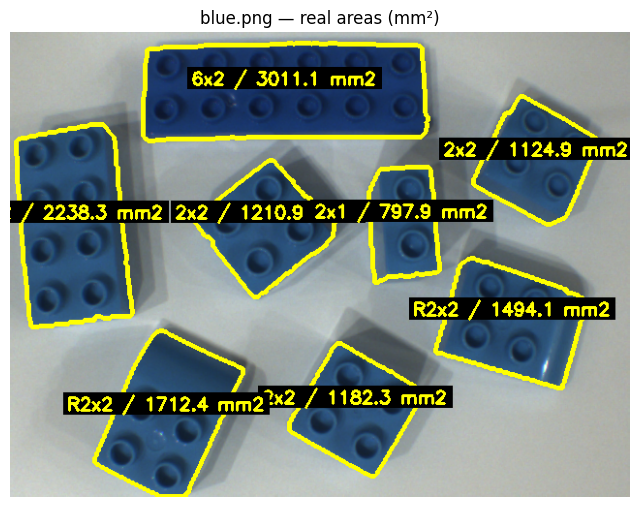

### Table — blue.png

,Avg Area (mm²),Std (mm²)
Type,,
2x1,797.86,0.00
2x2,1172.71,43.82
R2x2,1603.26,154.31
4x2,2238.30,0.00
6x2,3011.11,0.00


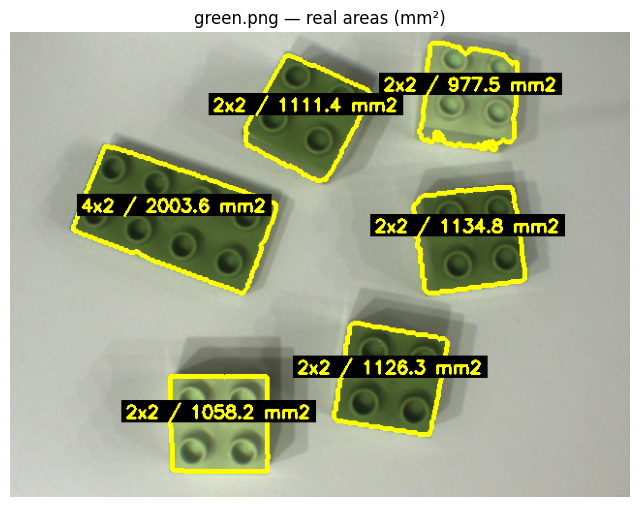

### Table — green.png

,Avg Area (mm²),Std (mm²)
Type,,
2x2,1081.63,65.38
4x2,2003.63,0.00


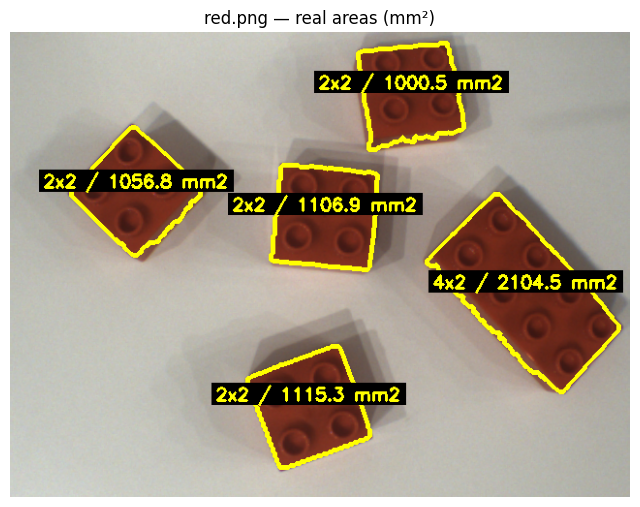

### Table — red.png

,Avg Area (mm²),Std (mm²)
Type,,
2x2,1069.88,52.96
4x2,2104.49,0.00


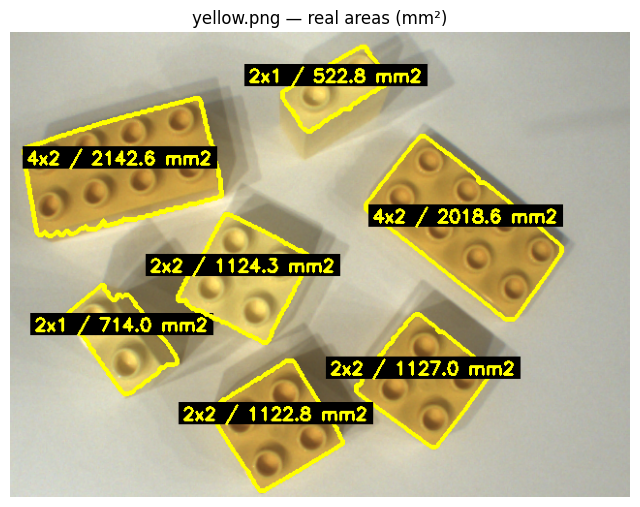

### Table — yellow.png

,Avg Area (mm²),Std (mm²)
Type,,
2x1,618.41,135.17
2x2,1124.70,2.10
4x2,2080.61,87.69


## Global Table — Q2(c)

,Avg Area (mm²),Std (mm²),Expected Area (mm²),Difference (mm²),Relative Error (%),N
Size,,,,,,
2x1,678.22,140.96,480,198.2,41.30,3
2x2,1105.33,60.91,1024,81.3,7.94,15
R2x2,1603.26,154.31,1504,99.3,6.60,2
4x2,2101.53,96.00,2048,53.5,2.61,5
6x2,3011.11,0.00,3040,-28.9,-0.95,1


In [23]:
# =========================================
# Q2(c) — Detection via studs/DBSCAN, area via YOUR mask,
#          English labels, mm² units, and global difference table
# =========================================
import os, cv2, numpy as np, pandas as pd, matplotlib.pyplot as plt
from IPython.display import display, Markdown
from sklearn.cluster import DBSCAN

# --------- CONFIG ---------
PX_PER_MM = 0.330034          # mm/pixel  (given)
MM2_PER_PX2 = PX_PER_MM**2
EPS_VALUE = 70
MIN_SAMPLES = 2
ROI_PADDING = 60
ASPECT_RATIO_THRESHOLD = 1.2
VALID_SIZES_ORDER = ['2x1','2x2','R2x2','4x2','6x2']

ISOLATED_DIR = "./data/Isolated"
IMAGES = {
    "blue":   f"{ISOLATED_DIR}/blue.png",
    "green":  f"{ISOLATED_DIR}/green.png",
    "red":    f"{ISOLATED_DIR}/red.png",
    "yellow": f"{ISOLATED_DIR}/yellow.png",
}

# Expected brick face areas from Table 1 (Length x Width, in mm)
EXPECTED_AREA_MM2 = {
    "2x1": 32 * 15,   # 480
    "2x2": 32 * 32,   # 1024
    "4x2": 32 * 64,   # 2048
    "6x2": 32 * 95,   # 3040
    "R2x2": 32 * 47   # 1504
}

# --------- YOUR EXACT COLOR RANGES FOR AREA MASK (no changes) ---------
AREA_COLOR_RANGES = {
    'red':    ([0, 120, 70],  [10, 255, 255]),
    'blue':   ([90, 60, 40],  [130, 255, 255]),
    'green':  ([30, 66, 0],   [66, 255, 255]),
    'yellow': ([10, 111, 120],[40, 255, 255]),
    'white':  ([0, 0, 47],    [180, 87, 255]),
}

def area_mask_in_roi_strict(roi_bgr, color_key):
    """Apply EXACT lower/upper + erode(5) + dilate(5); no further tweaks."""
    roi_hsv = cv2.cvtColor(roi_bgr, cv2.COLOR_BGR2HSV)
    lower, upper = AREA_COLOR_RANGES[color_key]
    lower = np.array(lower, dtype=np.uint8)
    upper = np.array(upper, dtype=np.uint8)
    mask = cv2.inRange(roi_hsv, lower, upper)
    kernel = np.ones((5,5), np.uint8)
    mask = cv2.erode(mask, kernel, iterations=1)
    mask = cv2.dilate(mask, kernel, iterations=1)
    return mask

# --------- Detection (same approach as before) ---------
def create_color_mask_detection(img_bgr, color_key):
    """Detection masks (free to be slightly different from area mask)."""
    hsv = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2HSV)
    if color_key == 'red':
        lower1, upper1 = (0, 120, 70), (10, 255, 255)
        lower2, upper2 = (170, 120, 70), (180, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower1), np.array(upper1)) \
             | cv2.inRange(hsv, np.array(lower2), np.array(upper2))
    elif color_key == 'blue':
        lower, upper = (90, 80, 50), (130, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))
    elif color_key == 'green':
        lower, upper = (40, 60, 50), (85, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))
    elif color_key == 'yellow':
        lower, upper = (20, 100, 100), (35, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))
    else:
        mask = np.zeros(hsv.shape[:2], np.uint8)

    k = np.ones((7,7), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, k)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, k)
    return mask

def detect_studs(gray, mask):
    g = cv2.bitwise_and(gray, gray, mask=mask)
    g = cv2.medianBlur(g, 5)
    circles = cv2.HoughCircles(g, cv2.HOUGH_GRADIENT, dp=1.2, minDist=25,
                               param1=100, param2=15, minRadius=6, maxRadius=15)
    if circles is None:
        return np.empty((0,2), dtype=np.float32)
    pts = np.uint16(np.around(circles[0,:]))[:, :2].astype(np.float32)
    # de-duplicate
    keep, used = [], np.zeros(len(pts), bool)
    for i in range(len(pts)):
        if used[i]: continue
        keep.append(pts[i])
        for j in range(i+1, len(pts)):
            if np.linalg.norm(pts[i]-pts[j]) < 10: used[j]=True
    return np.array(keep, dtype=np.float32)

def cluster_dbscan(studs):
    if len(studs) < 2: return np.array([-1]*len(studs))
    return DBSCAN(eps=EPS_VALUE, min_samples=MIN_SAMPLES).fit(studs).labels_

def oriented_roi_from_studs(studs, padding=ROI_PADDING):
    rect = cv2.minAreaRect(studs)
    center, size, ang = rect
    expanded = (center, (size[0]+2*padding, size[1]+2*padding), ang)
    box = cv2.boxPoints(expanded).astype(int)
    return {'rect': expanded, 'box': box, 'angle': ang, 'center': center, 'size': expanded[1]}

def rect_to_bbox(box, shape):
    x,y,w,h = cv2.boundingRect(box)
    x=max(0,x); y=max(0,y)
    w=min(w, shape[1]-x); h=min(h, shape[0]-y)
    return x,y,w,h

def classify_by_studs(n_studs, rect_size):
    if n_studs <= 0: return "unknown"
    valid = [2,4,8,12]
    closest = min(valid, key=lambda v: abs(v-n_studs))
    if abs(closest-n_studs) > 1: return "unknown"
    if closest==2: return "2x1"
    if closest==4:
        w,h = rect_size
        if w==0 or h==0: return "2x2"
        ar = max(w,h)/max(1e-6, min(w,h))
        return "R2x2" if ar > ASPECT_RATIO_THRESHOLD else "2x2"
    if closest==8:  return "4x2"
    if closest==12: return "6x2"
    return "unknown"

# --------- Measure one image and show results ---------
def process_one_image(img_path, color_key):
    img = cv2.imread(img_path)
    if img is None:
        display(Markdown(f"**{color_key}.png** — _file not found_"))
        return []

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    det_mask = create_color_mask_detection(img, color_key)
    studs = detect_studs(gray, det_mask)
    labels = cluster_dbscan(studs)
    uniq = sorted([l for l in set(labels) if l!=-1])

    vis = img.copy()
    rows = []

    for label in uniq:
        pts = studs[labels==label]
        if len(pts) < 2:
            continue

        roi_info = oriented_roi_from_studs(pts, padding=ROI_PADDING)
        x,y,w,h = rect_to_bbox(roi_info['box'], img.shape)
        if w<=0 or h<=0:
            continue

        roi_bgr = img[y:y+h, x:x+w]
        # EXACT area mask inside ROI
        m = area_mask_in_roi_strict(roi_bgr, color_key)

        # largest contour = brick
        cnts, _ = cv2.findContours(m, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if not cnts:
            continue
        c = max(cnts, key=cv2.contourArea)
        area_px = float(cv2.contourArea(c))
        if area_px < 100:
            continue
        area_mm2 = area_px * MM2_PER_PX2

        # draw contour in global coords + label with REAL area
        c_global = c + np.array([[x, y]])
        cv2.drawContours(vis, [c_global], -1, (0,255,255), 3)

        rect = cv2.minAreaRect(c)
        btype = classify_by_studs(len(pts), rect[1])
        cx, cy = int(rect[0][0])+x, int(rect[0][1])+y
        text = f"{btype} / {area_mm2:.1f} mm2"
        (tw,th), _ = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2)
        cv2.rectangle(vis, (cx - tw//2 - 4, cy - th - 10), (cx + tw//2 + 4, cy - 2), (0,0,0), -1)
        cv2.putText(vis, text, (cx - tw//2, cy - 6), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,255,255), 2)

        rows.append({
            'File': f"{color_key}.png",
            'Color': color_key,
            'Type': btype,
            'Area_px': area_px,
            'Area_mm2': area_mm2
        })

    # Show image with contours + real area
    plt.figure(figsize=(8,8))
    plt.imshow(cv2.cvtColor(vis, cv2.COLOR_BGR2RGB))
    plt.title(f"{color_key}.png — real areas (mm²)")
    plt.axis('off')
    plt.show()

    # Per-image table in English with mm²
    if rows:
        df = pd.DataFrame(rows)
        tbl = df.groupby('Type').agg(**{
            'Avg Area (mm²)':   ('Area_mm2', 'mean'),
            'Std (mm²)':        ('Area_mm2', 'std')
        }).fillna(0.0)
        present = [s for s in VALID_SIZES_ORDER if s in tbl.index]
        tbl = tbl.loc[present].round({'Avg Area (mm²)':2,'Std (mm²)':2})
        display(Markdown(f"### Table — {color_key}.png"))
        display(tbl)

    return rows

# --------- Run for all images ---------
all_rows = []
for color, path in IMAGES.items():
    all_rows.extend(process_one_image(path, color))

# --------- Global table with Expected area and Difference ---------
display(Markdown("## Global Table — Q2(c)"))
if all_rows:
    df = pd.DataFrame(all_rows)
    agg = df.groupby('Type').agg(
        Avg_Area_mm2=('Area_mm2','mean'),
        Std_mm2=('Area_mm2','std'),
        N=('Area_mm2','count')
    ).fillna(0.0)

    # add Expected Area, Difference, Relative Error
    agg['Expected Area (mm²)'] = [EXPECTED_AREA_MM2.get(t, np.nan) for t in agg.index]
    agg['Difference (mm²)'] = (agg['Avg_Area_mm2'] - agg['Expected Area (mm²)'])
    agg['Relative Error (%)'] = 100.0 * agg['Difference (mm²)'] / agg['Expected Area (mm²)']

    # reorder & rename for display
    cols = ['Avg_Area_mm2', 'Std_mm2', 'Expected Area (mm²)', 'Difference (mm²)', 'Relative Error (%)', 'N']
    agg = agg[cols]
    agg.index.name = 'Size'
    agg = agg.rename(columns={
        'Avg_Area_mm2': 'Avg Area (mm²)',
        'Std_mm2': 'Std (mm²)'
    })
    order = [s for s in VALID_SIZES_ORDER if s in agg.index]
    agg = agg.loc[order]
    agg = agg.round({'Avg Area (mm²)':2,'Std (mm²)':2,'Expected Area (mm²)':1,'Difference (mm²)':1,'Relative Error (%)':2})

    display(agg)
else:
    display(Markdown("_No valid detections._"))


### Answer 2 (c) --- Global Table

| Size | Avg Area (mm²) | Std (mm²) | Expected Area (mm²) | Difference (mm²) | Relative Error (%) | N |
|:-----|:---------------:|:----------:|:--------------------:|:----------------:|:------------------:|:--:|
| 2x1  | 678.22 | 140.96 | 480  | 198.2  | 41.30 | 3 |
| 2x2  | 1105.33 | 60.91 | 1024 | 81.3   | 7.94  | 15 |
| R2x2 | 1603.26 | 154.31 | 1504 | 99.3  | 6.60  | 2 |
| 4x2  | 2101.53 | 96.00 | 2048 | 53.5  | 2.61  | 5 |
| 6x2  | 3011.11 | 0.00  | 3040 | -28.9 | -0.95 | 1 |

**It can be verified in the output of the cell above.**


# Exercise 3: Kit images

## Q3(a) — Show detections and centroids for kit images

### Goal  
Detect all LEGO bricks in the kit images and show their **centroids**.

---

## Method summary

1) **Color filtering** — For each color (`red`, `blue`, `green`, `yellow`, `white`), a HSV **detection mask** is created using `cv2.inRange` and cleaned with morphological ops (`cv2.morphologyEx`).

2) **Stud detection and clustering** — Studs are detected with `cv2.HoughCircles`, then grouped into bricks using **DBSCAN** (`sklearn.cluster.DBSCAN`).

3) **ROI and contour extraction** — For each stud cluster:
   - An oriented bounding box is built with `cv2.minAreaRect` and expanded.
   - Inside that ROI, the strict mask is applied again (`cv2.inRange`, `cv2.erode`, `cv2.dilate`).
   - Contours are found using `cv2.findContours`, and the **largest contour** is kept.

4) **Centroid computation** —  
   The centroid is obtained from **image moments** using:
   ```python
   M = cv2.moments(contour)
   cx = int(M['m10'] / M['m00'])
   cy = int(M['m01'] / M['m00'])


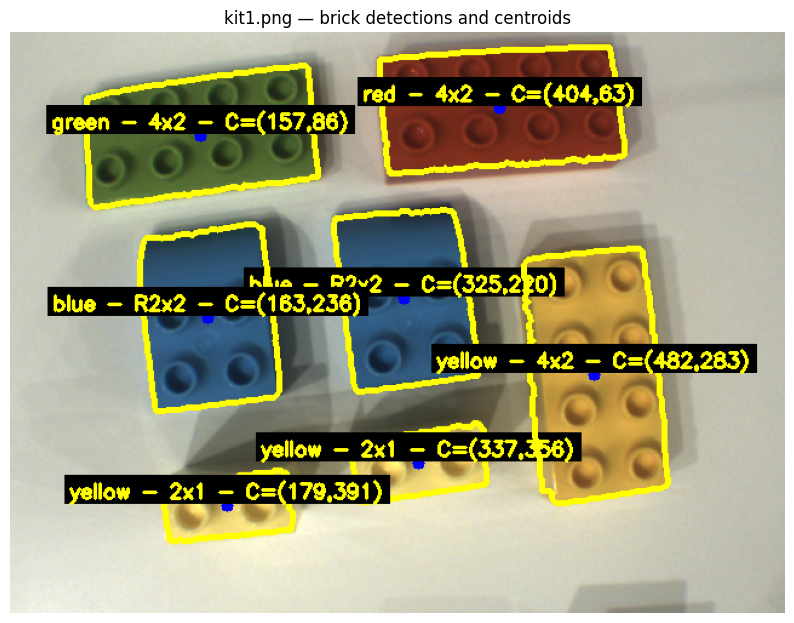

### Centroids — kit1.png

,Color,Type,Centroid_x(px),Centroid_y(px)
0,red,4x2,404,63
1,blue,R2x2,325,220
2,blue,R2x2,163,236
3,green,4x2,157,86
4,yellow,2x1,337,356
5,yellow,4x2,482,283
6,yellow,2x1,179,391


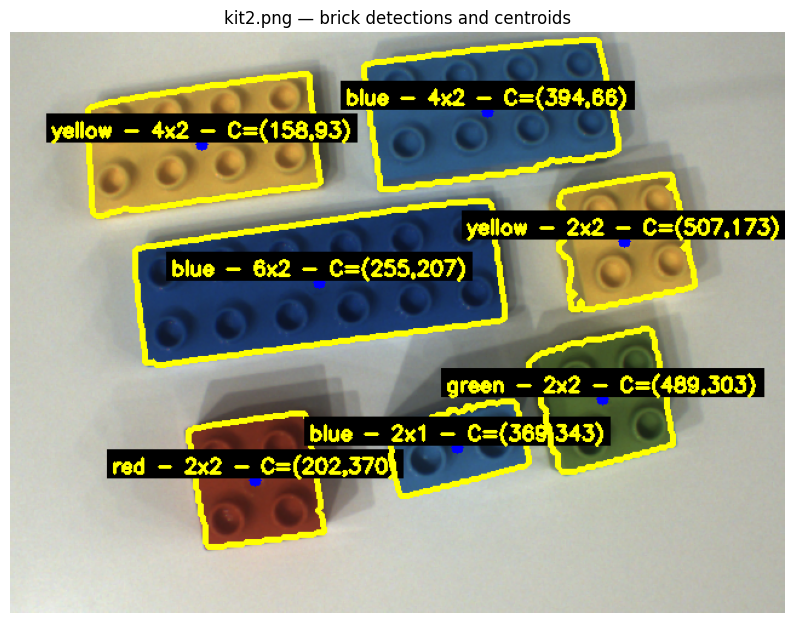

### Centroids — kit2.png

,Color,Type,Centroid_x(px),Centroid_y(px)
0,red,2x2,202,370
1,blue,2x1,369,343
2,blue,6x2,255,207
3,blue,4x2,394,66
4,green,2x2,489,303
5,yellow,2x2,507,173
6,yellow,4x2,158,93


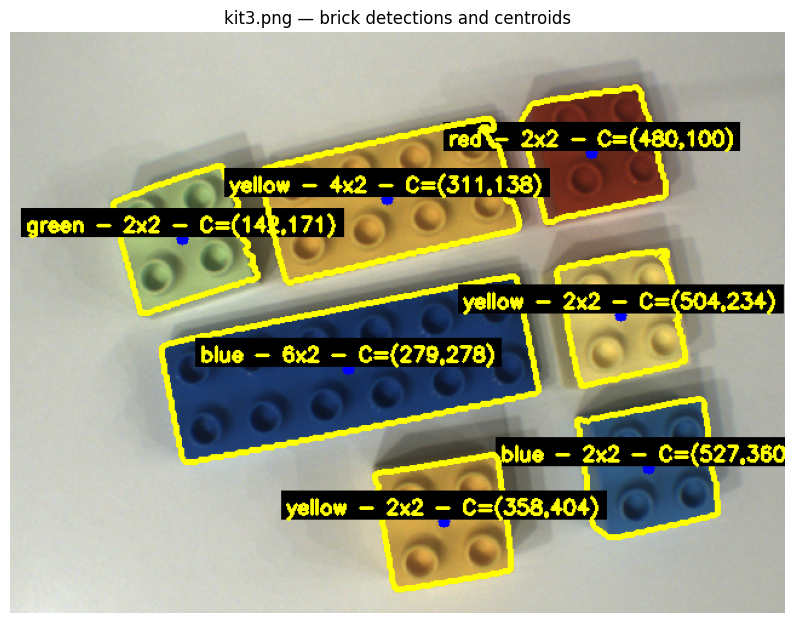

### Centroids — kit3.png

,Color,Type,Centroid_x(px),Centroid_y(px)
0,red,2x2,480,100
1,blue,6x2,279,278
2,blue,2x2,527,360
3,green,2x2,142,171
4,yellow,2x2,358,404
5,yellow,4x2,311,138
6,yellow,2x2,504,234


In [24]:
# =========================================
# Q3(a) — Show detections and centroids for kit images
# Reuses: studs → DBSCAN → oriented ROI; area/contour via your exact masks
# =========================================
import os, glob, cv2, numpy as np, pandas as pd, matplotlib.pyplot as plt
from IPython.display import display, Markdown
from sklearn.cluster import DBSCAN

# ---------- CONFIG ----------
PX_PER_MM = 0.330034               # mm/pixel (not needed for centroids, but kept)
MM2_PER_PX2 = PX_PER_MM**2
EPS_VALUE = 70
MIN_SAMPLES = 2
ROI_PADDING = 60
ASPECT_RATIO_THRESHOLD = 1.2

# Colors to search in mixed kit images
COLOR_KEYS = ['red','blue','green','yellow','white']

# Kit images (kit1 required; kit2/kit3 optional)
KIT_DIR = "./data/Kit"
KIT_IMAGES = [p for p in [f"{KIT_DIR}/kit1.png", f"{KIT_DIR}/kit2.png", f"{KIT_DIR}/kit3.png"] if os.path.exists(p)]
if not KIT_IMAGES:
    KIT_IMAGES = [f"{KIT_DIR}/kit1.png"]  # at least try kit1 per statement

# ---------- YOUR EXACT COLOR RANGES for AREA (no tweaks) ----------
AREA_COLOR_RANGES = {
    'red':    ([0, 120, 70],  [10, 255, 255]),
    'blue':   ([90, 60, 40],  [130, 255, 255]),
    'green':  ([30, 66, 0],   [66, 255, 255]),
    'yellow': ([10, 111, 120],[40, 255, 255]),
    'white':  ([0, 0, 47],    [180, 87, 255]),
}

def area_mask_in_roi_strict(roi_bgr, color_key):
    """Exact lower/upper + erode(5) + dilate(5)."""
    roi_hsv = cv2.cvtColor(roi_bgr, cv2.COLOR_BGR2HSV)
    lower, upper = AREA_COLOR_RANGES[color_key]
    lower = np.array(lower, dtype=np.uint8)
    upper = np.array(upper, dtype=np.uint8)
    mask = cv2.inRange(roi_hsv, lower, upper)
    kernel = np.ones((5,5), np.uint8)
    mask = cv2.erode(mask, kernel, iterations=1)
    mask = cv2.dilate(mask, kernel, iterations=1)
    return mask

# ---------- Detection masks (slightly permissive; do NOT affect area measurement) ----------
def create_color_mask_detection(img_bgr, color_key):
    hsv = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2HSV)
    if color_key == 'red':
        lo1, up1 = (0, 120, 70), (10, 255, 255)
        lo2, up2 = (170, 120, 70), (180, 255, 255)
        mask = cv2.inRange(hsv, np.array(lo1), np.array(up1)) | cv2.inRange(hsv, np.array(lo2), np.array(up2))
    elif color_key == 'blue':
        lo, up = (90, 80, 50), (130, 255, 255)
        mask = cv2.inRange(hsv, np.array(lo), np.array(up))
    elif color_key == 'green':
        lo, up = (40, 60, 50), (85, 255, 255)
        mask = cv2.inRange(hsv, np.array(lo), np.array(up))
    elif color_key == 'yellow':
        lo, up = (20, 100, 100), (35, 255, 255)
        mask = cv2.inRange(hsv, np.array(lo), np.array(up))
    elif color_key == 'white':
        lo, up = (0, 0, 200), (180, 60, 255)  # reasonable detection for bright whites
        mask = cv2.inRange(hsv, np.array(lo), np.array(up))
    else:
        mask = np.zeros(hsv.shape[:2], np.uint8)
    k = np.ones((7,7), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, k)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, k)
    return mask

def detect_studs(gray, mask):
    g = cv2.bitwise_and(gray, gray, mask=mask)
    g = cv2.medianBlur(g, 5)
    circles = cv2.HoughCircles(g, cv2.HOUGH_GRADIENT, dp=1.2, minDist=25,
                               param1=100, param2=15, minRadius=6, maxRadius=15)
    if circles is None:
        return np.empty((0,2), dtype=np.float32)
    pts = np.uint16(np.around(circles[0,:]))[:, :2].astype(np.float32)
    # de-duplicate
    keep, used = [], np.zeros(len(pts), bool)
    for i in range(len(pts)):
        if used[i]: continue
        keep.append(pts[i])
        for j in range(i+1, len(pts)):
            if np.linalg.norm(pts[i]-pts[j]) < 10: used[j]=True
    return np.array(keep, dtype=np.float32)

def cluster_dbscan(studs):
    if len(studs) < 2: return np.array([-1]*len(studs))
    return DBSCAN(eps=EPS_VALUE, min_samples=MIN_SAMPLES).fit(studs).labels_

def oriented_roi_from_studs(studs, padding=ROI_PADDING):
    rect = cv2.minAreaRect(studs)
    center, size, ang = rect
    expanded = (center, (size[0]+2*padding, size[1]+2*padding), ang)
    box = cv2.boxPoints(expanded).astype(int)
    return {'rect': expanded, 'box': box, 'angle': ang, 'center': center, 'size': expanded[1]}

def rect_to_bbox(box, shape):
    x,y,w,h = cv2.boundingRect(box)
    x=max(0,x); y=max(0,y)
    w=min(w, shape[1]-x); h=min(h, shape[0]-y)
    return x,y,w,h

def classify_by_studs(n_studs, rect_size):
    if n_studs <= 0: return "unknown"
    valid = [2,4,8,12]
    closest = min(valid, key=lambda v: abs(v-n_studs))
    if abs(closest-n_studs) > 1: return "unknown"
    if closest==2: return "2x1"
    if closest==4:
        w,h = rect_size
        if w==0 or h==0: return "2x2"
        ar = max(w,h)/max(1e-6, min(w,h))
        return "R2x2" if ar > ASPECT_RATIO_THRESHOLD else "2x2"
    if closest==8:  return "4x2"
    if closest==12: return "6x2"
    return "unknown"

def centroid_from_contour(cnt):
    m = cv2.moments(cnt)
    if m['m00'] == 0: return None
    cx = int(m['m10']/m['m00']); cy = int(m['m01']/m['m00'])
    return (cx, cy)

# ---------- Process one KIT image ----------
def process_kit_image(img_path):
    img = cv2.imread(img_path)
    if img is None:
        display(Markdown(f"**{os.path.basename(img_path)}** — _file not found_"))
        return

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    overlay = img.copy()
    rows = []

    # Run per color on the same image
    for color_key in COLOR_KEYS:
        det_mask = create_color_mask_detection(img, color_key)
        studs = detect_studs(gray, det_mask)
        labels = cluster_dbscan(studs)
        uniq = sorted([l for l in set(labels) if l!=-1])

        for label in uniq:
            pts = studs[labels==label]
            if len(pts) < 2:
                continue
            roi_info = oriented_roi_from_studs(pts, padding=ROI_PADDING)
            x,y,w,h = rect_to_bbox(roi_info['box'], img.shape)
            if w<=0 or h<=0:
                continue

            roi_bgr = img[y:y+h, x:x+w]
            # Exact area/contour mask inside ROI
            m = area_mask_in_roi_strict(roi_bgr, color_key)
            cnts, _ = cv2.findContours(m, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if not cnts:
                continue
            c = max(cnts, key=cv2.contourArea)
            if cv2.contourArea(c) < 100:
                continue

            # Draw contour in global coordinates
            c_global = c + np.array([[x, y]])
            cv2.drawContours(overlay, [c_global], -1, (0,255,255), 3)

            # Centroid (global coords)
            cen_local = centroid_from_contour(c)
            if cen_local is None:
                continue
            cx, cy = cen_local[0] + x, cen_local[1] + y
            cv2.circle(overlay, (cx, cy), 5, (255,0,0), -1)

            # Type by studs; label
            rect = cv2.minAreaRect(c)
            btype = classify_by_studs(len(pts), rect[1])
            text = f"{color_key} - {btype} - C=({cx},{cy})"
            (tw,th), _ = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 0.55, 2)
            cv2.rectangle(overlay, (cx - tw//2 - 4, cy - th - 12), (cx + tw//2 + 4, cy - 2), (0,0,0), -1)
            cv2.putText(overlay, text, (cx - tw//2, cy - 6), cv2.FONT_HERSHEY_SIMPLEX, 0.55, (0,255,255), 2)

            rows.append({
                'Image': os.path.basename(img_path),
                'Color': color_key,
                'Type': btype,
                'Centroid_x(px)': cx,
                'Centroid_y(px)': cy
            })

    # Show image with all detections and centroids
    plt.figure(figsize=(10,10))
    plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
    plt.title(f"{os.path.basename(img_path)} — brick detections and centroids")
    plt.axis('off'); plt.show()

    # Table with centroids (optional but handy)
    if rows:
        df = pd.DataFrame(rows)
        display(Markdown(f"### Centroids — {os.path.basename(img_path)}"))
        display(df[['Color','Type','Centroid_x(px)','Centroid_y(px)']])

# ---------- Run over kits ----------
for kit_path in KIT_IMAGES:
    process_kit_image(kit_path)


## (b) Count the number of bricks by size and color for all images. Show the result in a table similar to Table 3.

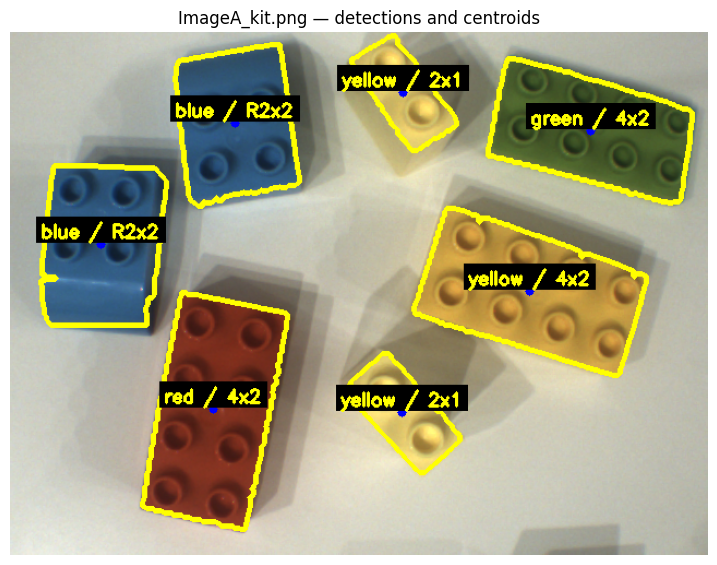

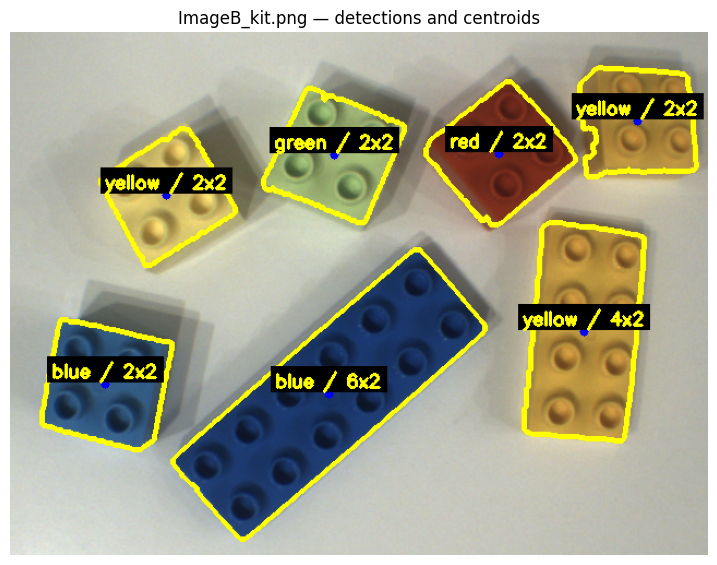

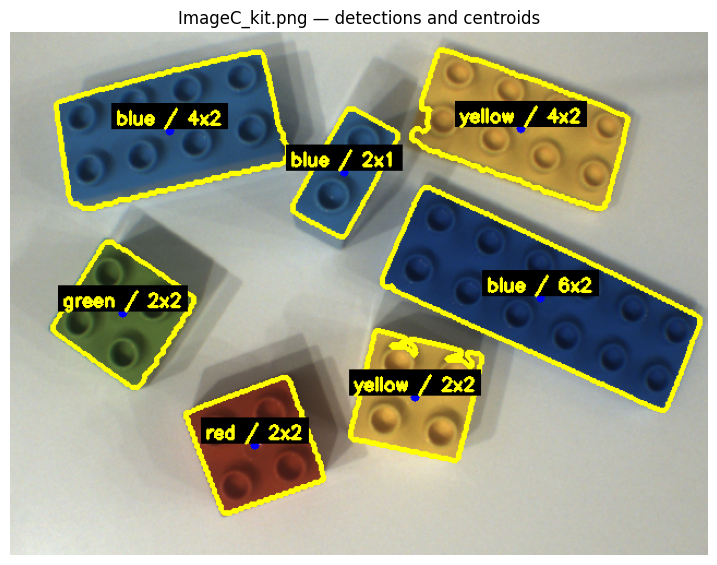

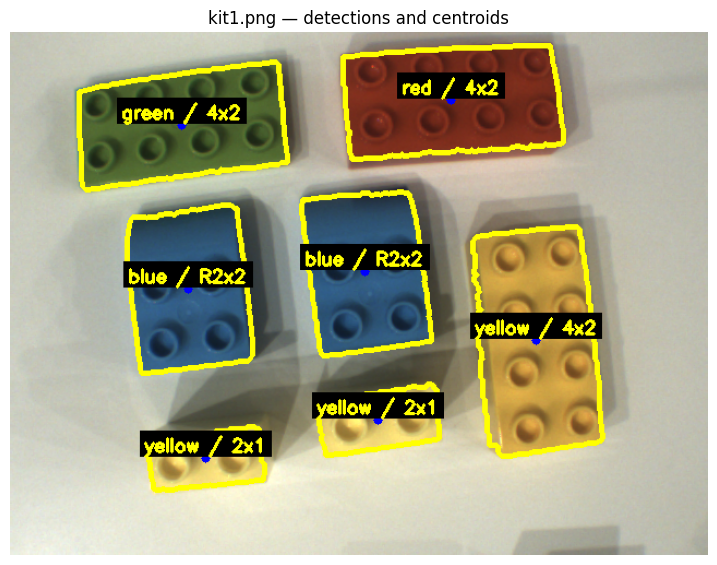

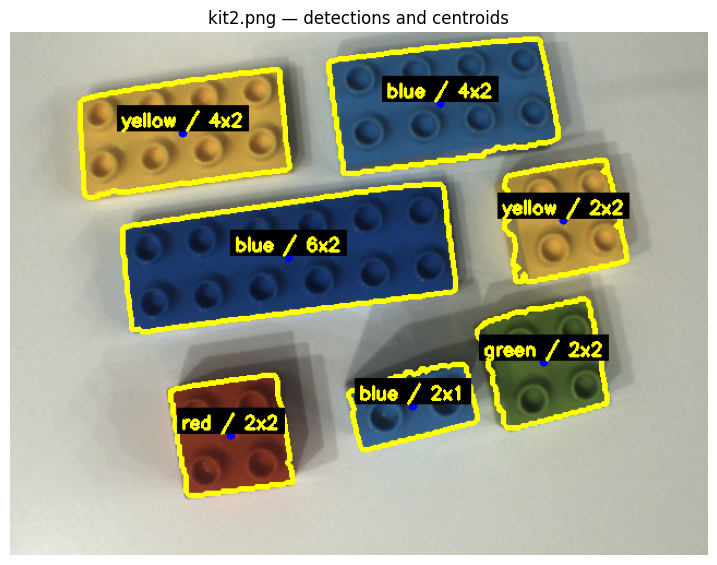

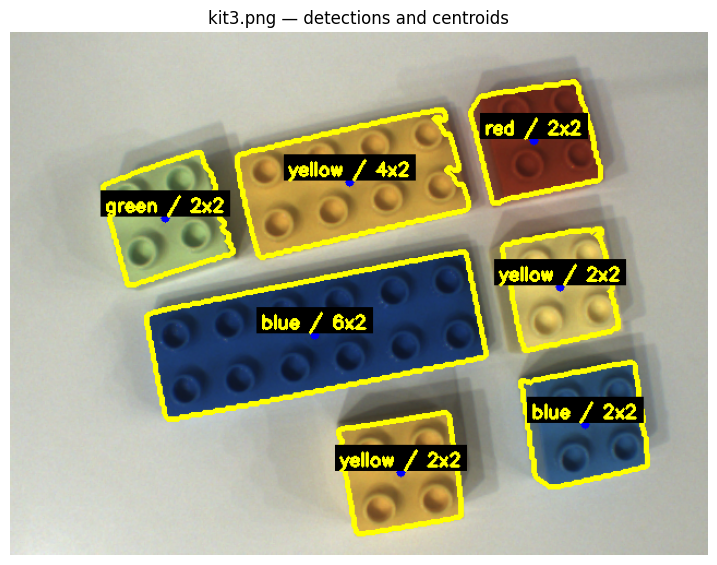


Brick counts by Image, Size, and Color for all Kit images:


Empty DataFrame
Columns: []
Index: [(ImageA_kit.png, 2x1, yellow, 2), (ImageA_kit.png, 4x2, green, 1), (ImageA_kit.png, 4x2, red, 1), (ImageA_kit.png, 4x2, yellow, 1), (ImageA_kit.png, R2x2, blue, 2), (ImageB_kit.png, 2x2, blue, 1), (ImageB_kit.png, 2x2, green, 1), (ImageB_kit.png, 2x2, red, 1), (ImageB_kit.png, 2x2, yellow, 2), (ImageB_kit.png, 4x2, yellow, 1), (ImageB_kit.png, 6x2, blue, 1), (ImageC_kit.png, 2x1, blue, 1), (ImageC_kit.png, 2x2, green, 1), (ImageC_kit.png, 2x2, red, 1), (ImageC_kit.png, 2x2, yellow, 1), (ImageC_kit.png, 4x2, blue, 1), (ImageC_kit.png, 4x2, yellow, 1), (ImageC_kit.png, 6x2, blue, 1), (kit1.png, 2x1, yellow, 2), (kit1.png, 4x2, green, 1), (kit1.png, 4x2, red, 1), (kit1.png, 4x2, yellow, 1), (kit1.png, R2x2, blue, 2), (kit2.png, 2x1, blue, 1), (kit2.png, 2x2, green, 1), (kit2.png, 2x2, red, 1), (kit2.png, 2x2, yellow, 1), (kit2.png, 4x2, blue, 1), (kit2.png, 4x2, yellow, 1), (kit2.png, 6x2, blue, 1), (kit3.png, 2x2, blue, 1), (kit3.png, 2x2, green, 1), (kit3.png, 2x2, red, 1), (kit3.png, 2x2, yellow, 2), (kit3.png, 4x2, yellow, 1), (kit3.png, 6x2, blue, 1)]

In [25]:
# =========================================
# Q3(b) — Count bricks by color and size for all kit images
# =========================================
import os, cv2, numpy as np, pandas as pd, matplotlib.pyplot as plt
from IPython.display import display, Markdown
from sklearn.cluster import DBSCAN

# ---------- CONFIG ----------
PX_PER_MM = 0.330034
EPS_VALUE = 70
MIN_SAMPLES = 2
ROI_PADDING = 60
ASPECT_RATIO_THRESHOLD = 1.2

# Paths for kits
KIT_DIR = "./data/Kit"
KIT_IMAGES = {
    "ImageA_kit.png": f"{KIT_DIR}/ImageA_kit.png",
    "ImageB_kit.png": f"{KIT_DIR}/ImageB_kit.png",
    "ImageC_kit.png": f"{KIT_DIR}/ImageC_kit.png",
    "kit1.png": f"{KIT_DIR}/kit1.png",
    "kit2.png": f"{KIT_DIR}/kit2.png",
    "kit3.png": f"{KIT_DIR}/kit3.png",
}

COLOR_KEYS = ['red','blue','green','yellow','white']

# Your exact area masks
AREA_COLOR_RANGES = {
    'red':    ([0, 120, 70],  [10, 255, 255]),
    'blue':   ([90, 60, 40],  [130, 255, 255]),
    'green':  ([30, 66, 0],   [66, 255, 255]),
    'yellow': ([10, 111, 120],[40, 255, 255]),
    'white':  ([0, 0, 47],    [180, 87, 255]),
}

def area_mask_in_roi_strict(roi_bgr, color_key):
    roi_hsv = cv2.cvtColor(roi_bgr, cv2.COLOR_BGR2HSV)
    lower, upper = AREA_COLOR_RANGES[color_key]
    mask = cv2.inRange(roi_hsv, np.array(lower, np.uint8), np.array(upper, np.uint8))
    kernel = np.ones((5,5), np.uint8)
    mask = cv2.erode(mask, kernel, 1)
    mask = cv2.dilate(mask, kernel, 1)
    return mask

# Detection mask for studs
def create_color_mask_detection(img_bgr, color_key):
    hsv = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2HSV)
    if color_key == 'red':
        m = cv2.inRange(hsv, np.array((0,120,70)), np.array((10,255,255))) \
          | cv2.inRange(hsv, np.array((170,120,70)), np.array((180,255,255)))
    elif color_key == 'blue':
        m = cv2.inRange(hsv, np.array((90,80,50)), np.array((130,255,255)))
    elif color_key == 'green':
        m = cv2.inRange(hsv, np.array((40,60,50)), np.array((85,255,255)))
    elif color_key == 'yellow':
        m = cv2.inRange(hsv, np.array((20,100,100)), np.array((35,255,255)))
    elif color_key == 'white':
        m = cv2.inRange(hsv, np.array((0,0,200)), np.array((180,60,255)))
    else:
        m = np.zeros(hsv.shape[:2], np.uint8)
    k = np.ones((7,7), np.uint8)
    m = cv2.morphologyEx(m, cv2.MORPH_CLOSE, k)
    m = cv2.morphologyEx(m, cv2.MORPH_OPEN, k)
    return m

def detect_studs(gray, mask):
    g = cv2.medianBlur(cv2.bitwise_and(gray, gray, mask=mask), 5)
    circles = cv2.HoughCircles(g, cv2.HOUGH_GRADIENT, dp=1.2, minDist=25,
                               param1=100, param2=15, minRadius=6, maxRadius=15)
    if circles is None: return np.empty((0,2), np.float32)
    pts = np.uint16(np.around(circles[0,:]))[:, :2].astype(np.float32)
    keep, used = [], np.zeros(len(pts), bool)
    for i in range(len(pts)):
        if used[i]: continue
        keep.append(pts[i])
        for j in range(i+1, len(pts)):
            if np.linalg.norm(pts[i]-pts[j]) < 10: used[j]=True
    return np.array(keep, np.float32)

def cluster_dbscan(studs):
    if len(studs)<2: return np.array([-1]*len(studs))
    return DBSCAN(eps=EPS_VALUE, min_samples=MIN_SAMPLES).fit(studs).labels_

def oriented_roi_from_studs(studs, padding=ROI_PADDING):
    rect = cv2.minAreaRect(studs)
    center, size, ang = rect
    expanded = (center, (size[0]+2*padding, size[1]+2*padding), ang)
    box = cv2.boxPoints(expanded).astype(int)
    return {'rect': expanded, 'box': box, 'center': center, 'angle': ang, 'size': expanded[1]}

def rect_to_bbox(box, shape):
    x,y,w,h = cv2.boundingRect(box)
    x=max(0,x); y=max(0,y)
    w=min(w, shape[1]-x); h=min(h, shape[0]-y)
    return x,y,w,h

def classify_by_studs(n_studs, rect_size):
    valid=[2,4,8,12]
    if n_studs<=0: return "unknown"
    closest=min(valid,key=lambda v:abs(v-n_studs))
    if abs(closest-n_studs)>1: return "unknown"
    if closest==2: return "2x1"
    if closest==4:
        w,h=rect_size
        ar=max(w,h)/max(1e-6,min(w,h))
        return "R2x2" if ar>1.2 else "2x2"
    if closest==8: return "4x2"
    if closest==12: return "6x2"
    return "unknown"

def centroid_from_contour(cnt):
    M=cv2.moments(cnt)
    if M['m00']==0: return None
    return (int(M['m10']/M['m00']), int(M['m01']/M['m00']))

# -------- Process a single KIT image --------
def process_kit_image(img_path, label_name):
    img=cv2.imread(img_path)
    if img is None:
        display(Markdown(f"**{os.path.basename(img_path)} not found.**"))
        return []
    gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    overlay=img.copy()
    detections=[]

    for color in COLOR_KEYS:
        det_mask=create_color_mask_detection(img,color)
        studs=detect_studs(gray,det_mask)
        labels=cluster_dbscan(studs)
        for lbl in sorted(set(labels)-{-1}):
            pts=studs[labels==lbl]
            if len(pts)<2: continue
            roi_info=oriented_roi_from_studs(pts, ROI_PADDING)
            x,y,w,h=rect_to_bbox(roi_info['box'], img.shape)
            if w<=0 or h<=0: continue
            roi=img[y:y+h, x:x+w]
            m=area_mask_in_roi_strict(roi, color)
            cnts,_=cv2.findContours(m, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if not cnts: continue
            c=max(cnts,key=cv2.contourArea)
            if cv2.contourArea(c)<100: continue
            rect=cv2.minAreaRect(c)
            btype=classify_by_studs(len(pts),rect[1])
            detections.append((label_name,btype,color))

            c_global=c+np.array([[x,y]])
            cv2.drawContours(overlay,[c_global],-1,(0,255,255),3)
            cen=centroid_from_contour(c)
            if cen is not None:
                cx,cy=cen[0]+x,cen[1]+y
                cv2.circle(overlay,(cx,cy),4,(255,0,0),-1)
                label=f"{color} / {btype}"
                (tw,th),_=cv2.getTextSize(label,cv2.FONT_HERSHEY_SIMPLEX,0.55,2)
                cv2.rectangle(overlay,(cx-tw//2-4,cy-th-12),(cx+tw//2+4,cy-2),(0,0,0),-1)
                cv2.putText(overlay,label,(cx-tw//2,cy-6),cv2.FONT_HERSHEY_SIMPLEX,0.55,(0,255,255),2)

    # Show detections
    plt.figure(figsize=(9,9))
    plt.imshow(cv2.cvtColor(overlay,cv2.COLOR_BGR2RGB))
    plt.title(f"{label_name} — detections and centroids")
    plt.axis('off')
    plt.show()

    return detections

# -------- Run for all kits and aggregate --------
all_rows=[]
for label_name, path in KIT_IMAGES.items():
    all_rows += process_kit_image(path, label_name)

# Q3(b) — Pretty table: Image → BlockType → Color → Quantity (desc)

# If you already have `image_df` from your detection step, this will reuse it.
# Otherwise, try to build it from `all_rows` (list of tuples/lists like: (image_index, block_type, color))
if 'image_df' not in globals() or image_df is None or image_df.empty:
    try:
        # Expecting you have: all_rows = [(image_index, block_type, color), ...]
        image_df = pd.DataFrame(all_rows, columns=['image_index', 'block_type', 'color'])
    except Exception:
        image_df = pd.DataFrame(columns=['image_index', 'block_type', 'color'])

if not image_df.empty:
    # Count bricks by image, size, and color
    kit_brick_counts = (
        image_df
        .groupby(['image_index', 'block_type', 'color'])
        .size()
        .reset_index(name='quantity')
    )

    # Sort exactly: Image → BlockType → Color → Quantity (descending)
    kit_brick_counts = kit_brick_counts.sort_values(
        by=['image_index', 'block_type', 'color', 'quantity'],
        ascending=[True, True, True, False]
    ).reset_index(drop=True)

    print("\nBrick counts by Image, Size, and Color for all Kit images:")

    # MultiIndex view (grouped indices) for clearer visualization
    kit_brick_counts_indexed = kit_brick_counts.set_index(
        ['image_index', 'block_type', 'color', 'quantity']
    )

    display(kit_brick_counts_indexed)
else:
    print("\nNo bricks detected in the Kit images.")



The table with the desired format can be found at the end of the output above.

## (c) Determine which pre-defined Lego kit (see Figure 2) corresponds to each image.

COUNTING BRICKS IN REFERENCE KITS

KIT1 (kit1.png):


,block_type,color,quantity
0,2x1,yellow,2
1,4x2,green,1
2,4x2,red,1
3,4x2,yellow,1
4,R2x2,blue,2


Total bricks: 7

KIT2 (kit2.png):


,block_type,color,quantity
0,2x1,blue,1
1,2x2,green,1
2,2x2,red,1
3,2x2,yellow,1
4,4x2,blue,1
5,4x2,yellow,1
6,6x2,blue,1


Total bricks: 7

KIT3 (kit3.png):


,block_type,color,quantity
0,2x2,blue,1
1,2x2,green,1
2,2x2,red,1
3,2x2,yellow,2
4,4x2,yellow,1
5,6x2,blue,1


Total bricks: 7

COUNTING BRICKS IN TEST IMAGES

IMAGEA (ImageA_kit.png):


,block_type,color,quantity
0,2x1,yellow,2
1,4x2,green,1
2,4x2,red,1
3,4x2,yellow,1
4,R2x2,blue,2


Total bricks: 7

IMAGEB (ImageB_kit.png):


,block_type,color,quantity
0,2x2,blue,1
1,2x2,green,1
2,2x2,red,1
3,2x2,yellow,2
4,4x2,yellow,1
5,6x2,blue,1


Total bricks: 7

IMAGEC (ImageC_kit.png):


,block_type,color,quantity
0,2x1,blue,1
1,2x2,green,1
2,2x2,red,1
3,2x2,yellow,1
4,4x2,blue,1
5,4x2,yellow,1
6,6x2,blue,1


Total bricks: 7

MATCHING TEST IMAGES TO REFERENCE KITS

ImageA:
  - kit1: 100.00% similarity ✓ BEST MATCH
  - kit2: 14.29% similarity 
  - kit3: 14.29% similarity 

ImageB:
  - kit3: 100.00% similarity ✓ BEST MATCH
  - kit2: 71.43% similarity 
  - kit1: 14.29% similarity 

ImageC:
  - kit2: 100.00% similarity ✓ BEST MATCH
  - kit3: 71.43% similarity 
  - kit1: 14.29% similarity 

FINAL MATCHING RESULTS


### Kit Matching Results

,Test Image,Matched Kit
0,ImageA,kit1
1,ImageB,kit3
2,ImageC,kit2



COMPARISON VISUALIZATION


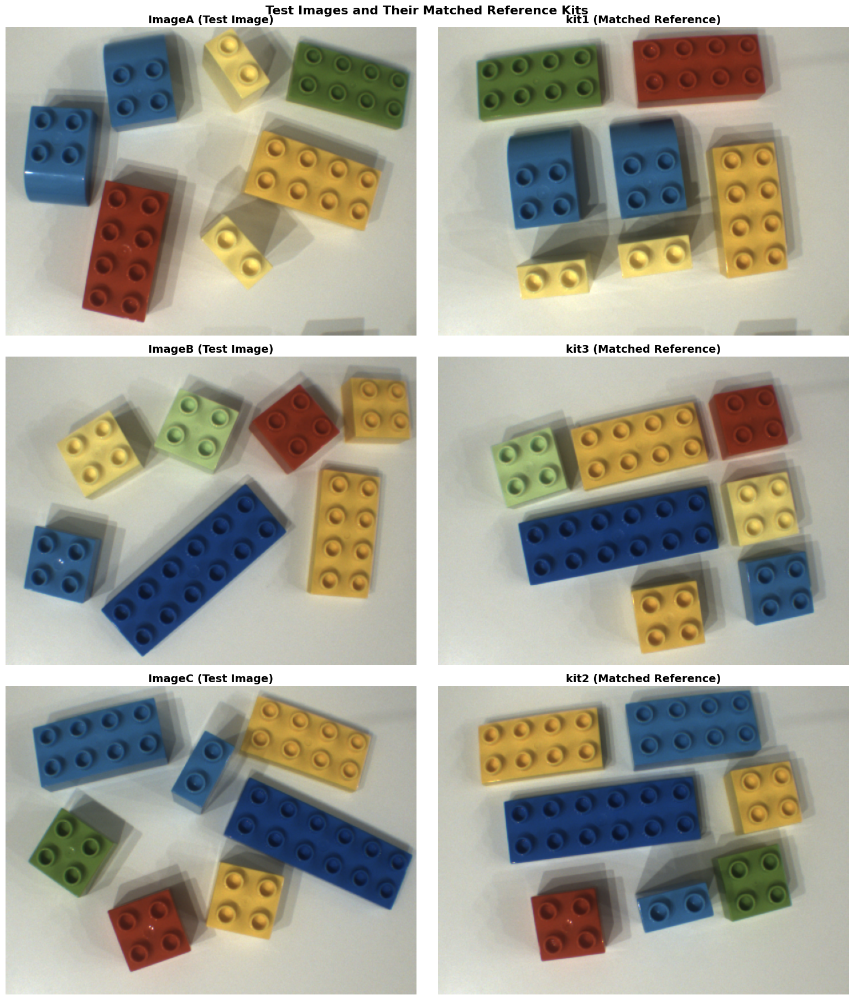

In [26]:
# =========================================
# Q3(c) — Match ImageA/B/C to kit1/2/3 by brick counts
# =========================================
import os, cv2, numpy as np, pandas as pd, matplotlib.pyplot as plt
from IPython.display import display, Markdown
from sklearn.cluster import DBSCAN

# ---------- CONFIG ----------
PX_PER_MM = 0.330034
EPS_VALUE = 70
MIN_SAMPLES = 2
ROI_PADDING = 60
ASPECT_RATIO_THRESHOLD = 1.2

# Reference kit images and test images
KIT_DIR = "./data/Kit"
REFERENCE_KITS = {
    "kit1": f"{KIT_DIR}/kit1.png",
    "kit2": f"{KIT_DIR}/kit2.png",
    "kit3": f"{KIT_DIR}/kit3.png"
}
TEST_IMAGES = {
    "ImageA": f"{KIT_DIR}/ImageA_kit.png",
    "ImageB": f"{KIT_DIR}/ImageB_kit.png",
    "ImageC": f"{KIT_DIR}/ImageC_kit.png"
}

COLOR_KEYS = ['red','blue','green','yellow','white']

# Your exact area masks
AREA_COLOR_RANGES = {
    'red':    ([0, 120, 70],  [10, 255, 255]),
    'blue':   ([90, 60, 40],  [130, 255, 255]),
    'green':  ([30, 66, 0],   [66, 255, 255]),
    'yellow': ([10, 111, 120],[40, 255, 255]),
    'white':  ([0, 0, 47],    [180, 87, 255]),
}

def area_mask_in_roi_strict(roi_bgr, color_key):
    roi_hsv = cv2.cvtColor(roi_bgr, cv2.COLOR_BGR2HSV)
    lower, upper = AREA_COLOR_RANGES[color_key]
    mask = cv2.inRange(roi_hsv, np.array(lower, np.uint8), np.array(upper, np.uint8))
    kernel = np.ones((5,5), np.uint8)
    mask = cv2.erode(mask, kernel, 1)
    mask = cv2.dilate(mask, kernel, 1)
    return mask

def create_color_mask_detection(img_bgr, color_key):
    hsv = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2HSV)
    if color_key == 'red':
        m = cv2.inRange(hsv, np.array((0,120,70)), np.array((10,255,255))) \
          | cv2.inRange(hsv, np.array((170,120,70)), np.array((180,255,255)))
    elif color_key == 'blue':
        m = cv2.inRange(hsv, np.array((90,80,50)), np.array((130,255,255)))
    elif color_key == 'green':
        m = cv2.inRange(hsv, np.array((40,60,50)), np.array((85,255,255)))
    elif color_key == 'yellow':
        m = cv2.inRange(hsv, np.array((20,100,100)), np.array((35,255,255)))
    elif color_key == 'white':
        m = cv2.inRange(hsv, np.array((0,0,200)), np.array((180,60,255)))
    else:
        m = np.zeros(hsv.shape[:2], np.uint8)
    k = np.ones((7,7), np.uint8)
    m = cv2.morphologyEx(m, cv2.MORPH_CLOSE, k)
    m = cv2.morphologyEx(m, cv2.MORPH_OPEN, k)
    return m

def detect_studs(gray, mask):
    g = cv2.medianBlur(cv2.bitwise_and(gray, gray, mask=mask), 5)
    circles = cv2.HoughCircles(g, cv2.HOUGH_GRADIENT, dp=1.2, minDist=25,
                               param1=100, param2=15, minRadius=6, maxRadius=15)
    if circles is None: return np.empty((0,2), np.float32)
    pts = np.uint16(np.around(circles[0,:]))[:, :2].astype(np.float32)
    keep, used = [], np.zeros(len(pts), bool)
    for i in range(len(pts)):
        if used[i]: continue
        keep.append(pts[i])
        for j in range(i+1, len(pts)):
            if np.linalg.norm(pts[i]-pts[j]) < 10: used[j]=True
    return np.array(keep, np.float32)

def cluster_dbscan(studs):
    if len(studs)<2: return np.array([-1]*len(studs))
    return DBSCAN(eps=EPS_VALUE, min_samples=MIN_SAMPLES).fit(studs).labels_

def oriented_roi_from_studs(studs, padding=ROI_PADDING):
    rect = cv2.minAreaRect(studs)
    center, size, ang = rect
    expanded = (center, (size[0]+2*padding, size[1]+2*padding), ang)
    box = cv2.boxPoints(expanded).astype(int)
    return {'rect': expanded, 'box': box, 'center': center, 'angle': ang, 'size': expanded[1]}

def rect_to_bbox(box, shape):
    x,y,w,h = cv2.boundingRect(box)
    x=max(0,x); y=max(0,y)
    w=min(w, shape[1]-x); h=min(h, shape[0]-y)
    return x,y,w,h

def classify_by_studs(n_studs, rect_size):
    valid=[2,4,8,12]
    if n_studs<=0: return "unknown"
    closest=min(valid,key=lambda v:abs(v-n_studs))
    if abs(closest-n_studs)>1: return "unknown"
    if closest==2: return "2x1"
    if closest==4:
        w,h=rect_size
        ar=max(w,h)/max(1e-6,min(w,h))
        return "R2x2" if ar>1.2 else "2x2"
    if closest==8: return "4x2"
    if closest==12: return "6x2"
    return "unknown"

def count_bricks_in_image(img_path):
    """Count bricks by type and color in a single image"""
    img = cv2.imread(img_path)
    if img is None:
        return []

    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    detections = []

    for color in COLOR_KEYS:
        det_mask = create_color_mask_detection(img, color)
        studs = detect_studs(gray, det_mask)
        labels = cluster_dbscan(studs)

        for lbl in sorted(set(labels)-{-1}):
            pts = studs[labels==lbl]
            if len(pts)<2: continue

            roi_info = oriented_roi_from_studs(pts, ROI_PADDING)
            x,y,w,h = rect_to_bbox(roi_info['box'], img.shape)
            if w<=0 or h<=0: continue

            roi = img[y:y+h, x:x+w]
            m = area_mask_in_roi_strict(roi, color)
            cnts,_ = cv2.findContours(m, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if not cnts: continue

            c = max(cnts, key=cv2.contourArea)
            if cv2.contourArea(c)<100: continue

            rect = cv2.minAreaRect(c)
            btype = classify_by_studs(len(pts), rect[1])
            detections.append({'block_type': btype, 'color': color})

    return detections

# -------- Count bricks in reference kits --------
print("=" * 60)
print("COUNTING BRICKS IN REFERENCE KITS")
print("=" * 60)

kit_inventories = {}
for kit_name, kit_path in REFERENCE_KITS.items():
    if not os.path.exists(kit_path):
        print(f"\n⚠️  {kit_name}: File not found")
        continue

    detections = count_bricks_in_image(kit_path)
    df = pd.DataFrame(detections)

    if not df.empty:
        counts = df.groupby(['block_type', 'color']).size().reset_index(name='quantity')
        counts = counts.sort_values(['block_type', 'color'])
        kit_inventories[kit_name] = counts

        print(f"\n{kit_name.upper()} ({os.path.basename(kit_path)}):")
        display(counts)
        print(f"Total bricks: {counts['quantity'].sum()}")
    else:
        print(f"\n{kit_name.upper()}: No bricks detected")
        kit_inventories[kit_name] = pd.DataFrame(columns=['block_type', 'color', 'quantity'])

# -------- Count bricks in test images --------
print("\n" + "=" * 60)
print("COUNTING BRICKS IN TEST IMAGES")
print("=" * 60)

test_inventories = {}
for test_name, test_path in TEST_IMAGES.items():
    if not os.path.exists(test_path):
        print(f"\n⚠️  {test_name}: File not found")
        continue

    detections = count_bricks_in_image(test_path)
    df = pd.DataFrame(detections)

    if not df.empty:
        counts = df.groupby(['block_type', 'color']).size().reset_index(name='quantity')
        counts = counts.sort_values(['block_type', 'color'])
        test_inventories[test_name] = counts

        print(f"\n{test_name.upper()} ({os.path.basename(test_path)}):")
        display(counts)
        print(f"Total bricks: {counts['quantity'].sum()}")
    else:
        print(f"\n{test_name.upper()}: No bricks detected")
        test_inventories[test_name] = pd.DataFrame(columns=['block_type', 'color', 'quantity'])

# -------- Match test images to reference kits --------
print("\n" + "=" * 60)
print("MATCHING TEST IMAGES TO REFERENCE KITS")
print("=" * 60)

def calculate_similarity(ref_df, test_df):
    """Calculate similarity score between two brick inventories"""
    if ref_df.empty or test_df.empty:
        return 0.0

    # Merge on block_type and color
    merged = pd.merge(
        ref_df, test_df,
        on=['block_type', 'color'],
        how='outer',
        suffixes=('_ref', '_test')
    ).fillna(0)

    # Calculate similarity based on matching quantities
    total_diff = abs(merged['quantity_ref'] - merged['quantity_test']).sum()
    total_ref = merged['quantity_ref'].sum()
    total_test = merged['quantity_test'].sum()

    # Penalize total count differences
    max_total = max(total_ref, total_test)
    if max_total == 0:
        return 0.0

    # Similarity score (higher is better, 1.0 is perfect match)
    similarity = 1.0 - (total_diff / (2 * max_total))
    return max(0.0, similarity)

matches = {}
for test_name, test_df in test_inventories.items():
    best_match = None
    best_score = -1
    scores = {}

    for kit_name, kit_df in kit_inventories.items():
        score = calculate_similarity(kit_df, test_df)
        scores[kit_name] = score

        if score > best_score:
            best_score = score
            best_match = kit_name

    matches[test_name] = best_match

    print(f"\n{test_name}:")
    for kit_name, score in sorted(scores.items(), key=lambda x: x[1], reverse=True):
        marker = "✓ BEST MATCH" if kit_name == best_match else ""
        print(f"  - {kit_name}: {score:.2%} similarity {marker}")

# -------- Display final results --------
print("\n" + "=" * 60)
print("FINAL MATCHING RESULTS")
print("=" * 60)

results_df = pd.DataFrame([
    {'Test Image': test_name, 'Matched Kit': kit_name}
    for test_name, kit_name in sorted(matches.items())
])

display(Markdown("### Kit Matching Results"))
display(results_df)

# -------- Create comparison visualization --------
print("\n" + "=" * 60)
print("COMPARISON VISUALIZATION")
print("=" * 60)

fig, axes = plt.subplots(len(matches), 2, figsize=(16, 6*len(matches)))
if len(matches) == 1:
    axes = axes.reshape(1, -1)

for idx, (test_name, kit_name) in enumerate(sorted(matches.items())):
    # Load and display test image
    test_path = TEST_IMAGES[test_name]
    test_img = cv2.imread(test_path)
    if test_img is not None:
        axes[idx, 0].imshow(cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB))
        axes[idx, 0].set_title(f"{test_name} (Test Image)", fontsize=14, fontweight='bold')
        axes[idx, 0].axis('off')

    # Load and display matched kit image
    kit_path = REFERENCE_KITS[kit_name]
    kit_img = cv2.imread(kit_path)
    if kit_img is not None:
        axes[idx, 1].imshow(cv2.cvtColor(kit_img, cv2.COLOR_BGR2RGB))
        axes[idx, 1].set_title(f"{kit_name} (Matched Reference)", fontsize=14, fontweight='bold')
        axes[idx, 1].axis('off')

plt.tight_layout()
plt.suptitle("Test Images and Their Matched Reference Kits", fontsize=16, fontweight='bold', y=1.001)
plt.show()

# Answer Question 3 c)

### Kit Matching Results

| Test Image | Matched Kit |
|-------------|--------------|
| ImageA      | kit1         |
| ImageB      | kit3         |
| ImageC      | kit2         |


**can be seen in the output of the code cell**

## Results - Answer to Question 3D)

To enhance the performance of the sorting process, the imaging system should undergo regular intrinsic and extrinsic calibration to maintain geometric consistency and minimize distortion over time. The illumination setup must be uniform, diffuse, and color balanced, preferably using controlled LED lighting with diffusers to eliminate shadows, glare, and chromatic bias that affect segmentation accuracy.

 A stable camera geometry including fixed angle, distance, and aperture combined with precise mechanical alignment of bricks ensures consistent perspective and prevents occlusion errors. The use of a non-reflective, high-contrast background distinct from all brick colors, along with color calibration targets, would improve segmentation and color classification reliability.

Furthermore, enclosing the imaging area to block ambient light and implementing photometric normalization or automatic white balance correction would maintain performance under variable lighting conditions. Finally, integrating quality control metrics and automated recalibration routines can help detect drift in system performance and guarantee long-term operational stability of the vision-based sorting process.

# Exercise 4: Fault Images

### Goal  
Given *Fault* images, decide whether each image matches **Kit A**, **Kit B**, or **Kit C**, or must be labeled **Faulty kit**.  
If faulty, automatically report the cause (missing/surplus/unexpected parts).

---

## Pipeline Overview

The solution operates in two phases:

1) **Per-image detection & inventory (by color and size)**  
2) **Kit classification against reference kit signatures**, with an explanation if no perfect match exists.  
All intermediate artifacts are saved under `results/exercise_4/*`.

---

## Step 0 — Setup

- `reset_results()` creates a clean directory structure for:
  - `step1_color_masks`, `step2_studs_detected`, `step3_clusters`, `step4_oriented_rois`, `step5_refined_rois`, `step6_final`.
- Constants define geometry and constraints: valid stud counts by size, DBSCAN parameters, ROI padding, etc.

---

## Step 1 — Color Filtering (robust masks per color)

**Function:** `create_color_mask(img_bgr, color, filename=None, studs=None)`

- Converts BGR→HSV and thresholds per color: blue, green, red, yellow, white.
- Applies morphology (CLOSE, OPEN) to clean the masks.
- **Yellow special handling** — `apply_gradient_mask_yellow(...)`  
  Uses Sobel gradients to find strong edges, identifies low-value connected regions, and flood-fills within local gradient constraints to remove background pixels leaking into the yellow mask. Finishes with light morphology.
- **White special handling** — `apply_distance_based_white_filter(v_channel, mask, studs, filename_base)`  
  Builds a KD-tree of stud centers and removes white pixels **far from any stud** (`> MAX_DISTANCE_FROM_STUD`), respecting gradient boundaries. This curbs background/shine leakage that is common with white. Saves a colored distance map overlay for audit.

**Saved artifacts:** per-color overlays in `step1_color_masks/` and (for white) `white_*` diagnostics.

---

## Step 2 — Stud Detection

**Function:** `detect_studs_in_mask(gray_img, mask)`

- Masks grayscale with the color mask, median-blurs, and runs `cv2.HoughCircles` (tuned to stud radii).  
- `remove_duplicate_studs` merges near-duplicates within a small radius.


**Saved artifacts:** stud overlays in `step2_studs_detected/`.

---

## Step 3 — Clustering studs into bricks

**Function:** `cluster_studs_dbscan(studs)`

- Uses **DBSCAN** with `eps=70`, `min_samples=2` to group studs per brick.  
- Noise label `-1` is ignored; the remaining cluster IDs enumerate candidate bricks.

**Saved artifacts:** colored cluster visualization in `step3_clusters/`.

---

## Step 4 — Oriented ROI (stud-aligned)

**Functions:**  
- `get_stud_orientation(studs)` — PCA on stud coordinates to obtain principal direction.  
- `create_oriented_roi(studs, mask, padding=ROI_PADDING)` — builds a **rotated bounding rectangle** around a cluster, expanded with padding to contain the entire brick.

**Saved artifacts:** oriented ROI boxes and stud dots in `step4_oriented_rois/`.

---

## Step 5 — ROI Refinement to the true brick boundary

**White bricks (hard case):** `refine_roi_with_contours_improved(..., color='white')`

1) Crop a focused grayscale ROI (from the oriented box if available).  
2) `find_rectangular_roi_candidates(roi_gray, ...)`  
   - Canny edges → dilate edges;  
   - `flood_fill_from_borders(...)` marks background from the **entire image perimeter** inward until hitting edges;  
   - applies the interior mask;  
   - finds external contours and computes min-area rectangles;  
   - scores candidates by **rectangularity** and **aspect ratio**.
3) Chooses best rectangle, then **refines edges** with `refine_rectangle_edges(...)` by scanning gradient strength orthogonal to each side to snap to the true brick edges.

**Other colors:** simplified contour-based refinement inside the oriented ROI with morphology + `minAreaRect`.

**Saved artifacts:** debug frames for white (Canny edges, interior mask, candidates, refined rectangle); final overlays in `step5_refined_rois/`.

---

## Brick Typing from studs and geometry

**Function:** `classify_brick_by_studs(n_studs, rect_size)`

- Maps stud count to nearest valid class `{2,4,8,12}` within tolerance `STUD_MISS_TOL`.  
- For 4-stud bricks, uses the rectangle **aspect ratio** to separate **2x2** vs **R2x2** (rectangular 2x2 variant):  
  if `max(w,h)/min(w,h) > ASPECT_RATIO_THRESHOLD` → `R2x2`, else `2x2`.  
- Records: color, type, stud count, size, angle, aspect ratio.

---

## Step 6 — Per-image aggregation and visualization

**Function:** `process_image(img_path, color)`  
Runs Steps 1–5 for one color on one image and returns:
- `bricks`: list of detected bricks (with attributes),  
- `visualizations`: key overlays (mask, studs, clusters, refined ROIs).

**Function:** `detect_inventory(img_path, visualize=False)`  
Iterates over all colors, merges brick lists, optionally blends per-color overlays into a **final composite** and saves:
- Final image: `step6_final/final_{filename}` (+ Matplotlib plot).  
- Returns:
  - `inventory`: `Counter((color, type) -> count)`  
  - `raw`: per-color brick records.

This inventory is exactly what Task 4 expects to compare against kits.

---

## Kit Matching Logic

**Building reference kit signatures**  
- For each of `kitA.png`, `kitB.png`, `kitC.png`, call `detect_inventory(...)` to compute an inventory signature.  
- Persist a string form via `inventory_to_string(inv)` for inspection.

**Classifying Fault images**  
- For each Fault image, compute `fault_inv`.  
- `best_kit_match(fault_inv, kits)` implements the assignment rule:  
  1) If any kit signature matches **exactly**, classify as **Assigned to Kit**.  
  2) Else classify **Faulty kit**, and pick the closest kit by the minimal `sum(abs(diff))`.  
     - `compare_inventories(fault_inv, kit_inv)` returns
       - `is_perfect_match` boolean,  
       - `diff` per `(color, type)` with positive = surplus, negative = missing,  
       - `causes` text listing **Missing parts**, **Surplus parts**, and **Unexpected parts** (not specified in the kit).  
- The script assembles a final table with columns:  
  `Image | Classification | MatchedKit | Causes | Inventory`  
  and writes `results/exercise_4/fault_classification_summary.csv`.

This meets Exercise 4 requirements: assigning each Fault image to Kit A/B/C or declaring it Faulty with the cause.

---

## Key Parameters

| Group | Parameter | Value | Purpose |
|---|---|---:|---|
| Clustering | `EPS_VALUE` | 70 | Max distance to group studs into one brick |
|  | `MIN_SAMPLES` | 2 | Minimum studs per cluster |
| ROI | `ROI_PADDING` | 40 px | Expand oriented box to include full brick |
| Geometry | `ASPECT_RATIO_THRESHOLD` | 1.2 | Separate 2x2 vs R2x2 |
| Yellow filter | `GRADIENT_THRESHOLD` | 3 | Gradient gate for flood-fill removal |
|  | `GRAY_TOLERANCE` | 15 | Intensity tolerance for propagation |
|  | `MIN_REGION_SIZE` | 300 px | Ignore tiny regions |
| White filter | `GRADIENT_THRESHOLD_WHITE` | 2 | Edge stop for distance flood-fill |
|  | `MAX_DISTANCE_FROM_STUD` | 200 px | Remove white pixels far from studs |
|  | `MIN_REGION_SIZE_WHITE` | 500 px | Ignore tiny distant regions |
| Studs | `minRadius..maxRadius` | 6..20 px | Expected stud radius |
| Duplicates | `min_dist` | 8–10 px | Merge near-duplicate studs |

---

## What to Look For in the Results folder

- `step1_color_masks/` — clean masks per color, with white distance map diagnostics.  
- `step2_studs_detected/` — stud centers over masked grayscale.  
- `step3_clusters/` — per-brick stud clusters (DBSCAN).  
- `step4_oriented_rois/` — PCA-aligned oriented boxes per cluster.  
- `step5_refined_rois/` — final brick rectangles with labels and dimensions.  
- `step6_final/` — composite visualization for the whole image.  
- `fault_classification_summary.csv` — final table with classification and causes.

---

## How This Answers Exercise 4

1. **Detects all bricks** robustly per color via specialized masking and stud-driven clustering.  
2. **Refines geometry** to true rectangles (including challenging white) and **types** bricks by stud count and aspect ratio.  
3. **Builds an inventory** `(color, size → count)` for each Fault image.  
4. **Matches against kit signatures**; if not exact, flags **Faulty kit** and **explains the discrepancy** automatically (missing/surplus/unexpected), as required. :contentReference[oaicite:3]{index=3}





=== Building kit signatures ===
   ✓ Brick #1: R2x2 - blue (4 studs)
   ✓ Brick #1: 4x2 - green (8 studs)
   ✓ Brick #1: 4x2 - red (8 studs)
   ✓ Brick #2: 2x2 - red (4 studs)
   ✓ Brick #1: 2x1 - yellow (2 studs)
   ✓ Brick #2: 2x2 - yellow (4 studs)


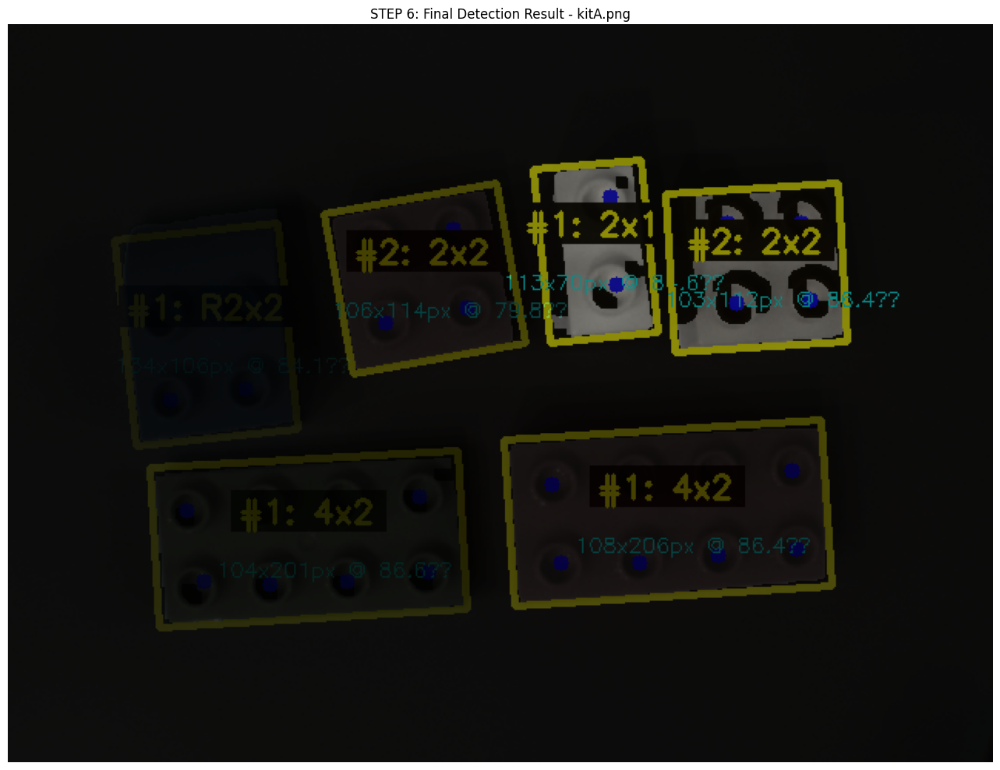

KitA: 1x blue/R2x2, 1x green/4x2, 1x red/2x2, 1x red/4x2, 1x yellow/2x1, 1x yellow/2x2
   ✓ Brick #1: R2x2 - blue (4 studs)
   ✓ Brick #1: 4x2 - green (8 studs)
   ✓ Brick #1: 2x2 - red (4 studs)
   ✓ Brick #1: 4x2 - yellow (8 studs)
   ✓ Brick #2: 2x1 - yellow (2 studs)
   ✓ Brick #3: 2x2 - yellow (4 studs)
   ⚠ No studs detected for white


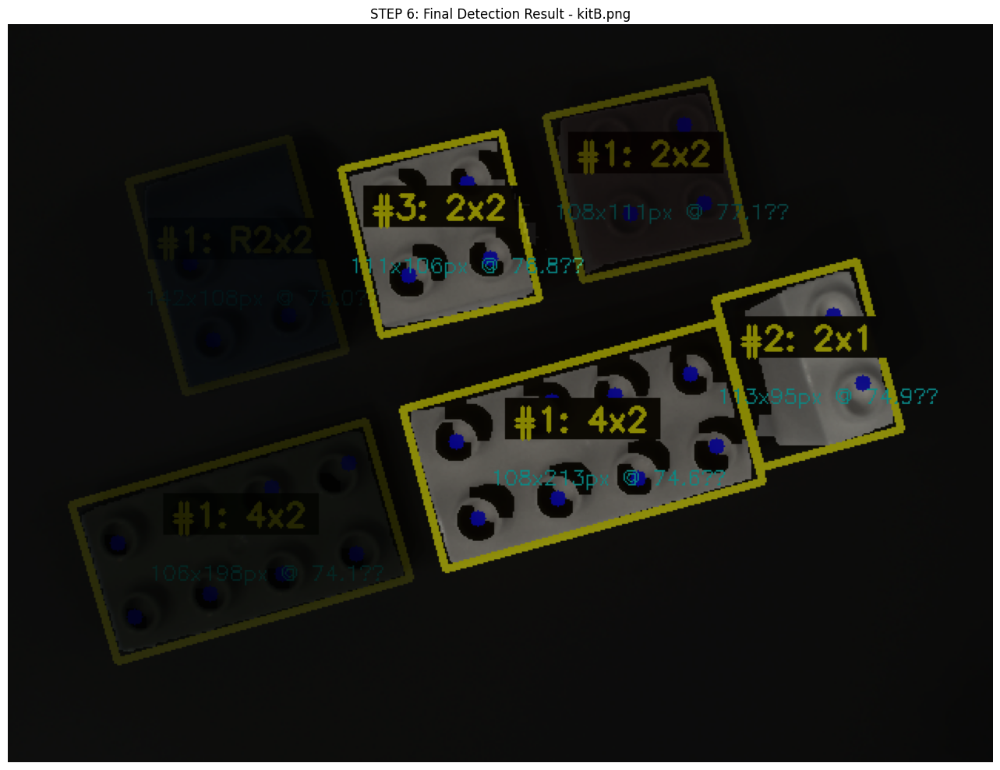

KitB: 1x blue/R2x2, 1x green/4x2, 1x red/2x2, 1x yellow/2x1, 1x yellow/2x2, 1x yellow/4x2
   ✓ Brick #1: 4x2 - blue (8 studs)
   ✓ Brick #2: 6x2 - blue (12 studs)
   ✓ Brick #1: 4x2 - green (8 studs)
   ✓ Brick #1: 4x2 - red (8 studs)
   ✓ Brick #1: 4x2 - yellow (8 studs)
   ✓ Brick #2: 2x2 - yellow (4 studs)


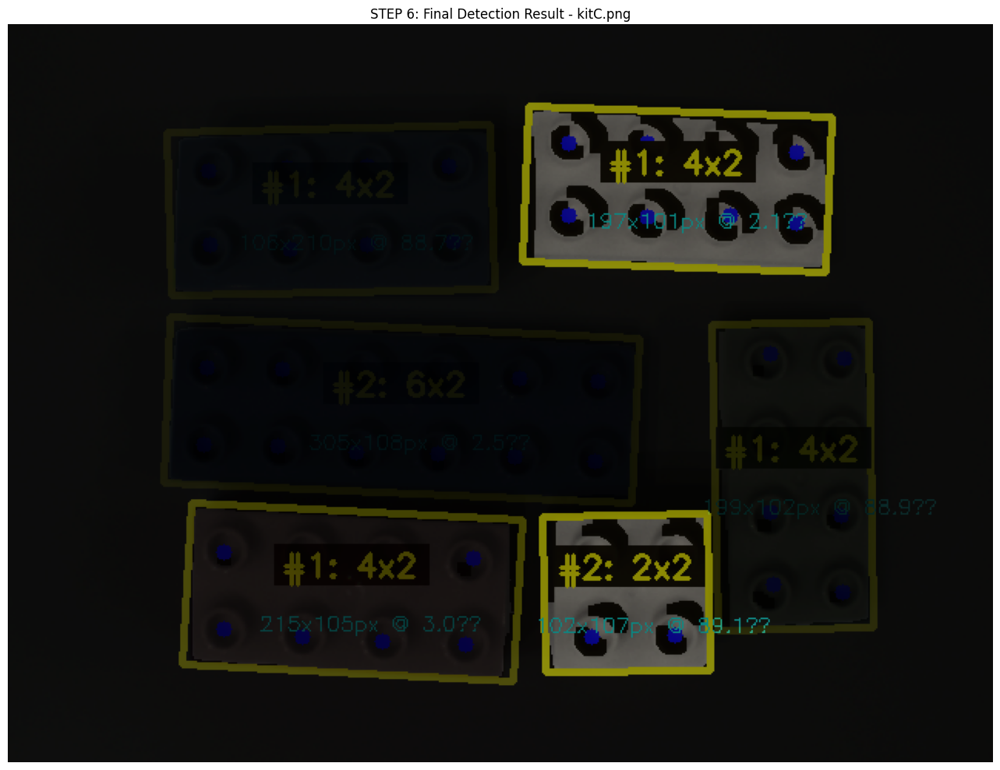

KitC: 1x blue/4x2, 1x blue/6x2, 1x green/4x2, 1x red/4x2, 1x yellow/2x2, 1x yellow/4x2

=== Classifying fault images ===
   ⚠ No studs detected for blue
   ✓ Brick #1: 4x2 - green (8 studs)
   ✓ Brick #1: 2x2 - red (4 studs)
   ✓ Brick #1: 4x2 - yellow (8 studs)
   ✓ Brick #2: 2x1 - yellow (2 studs)
   ✓ Brick #3: 2x2 - yellow (4 studs)
  Found 6 contours from interior mask
   ✓ Brick #1: R2x2 - white (5 studs)


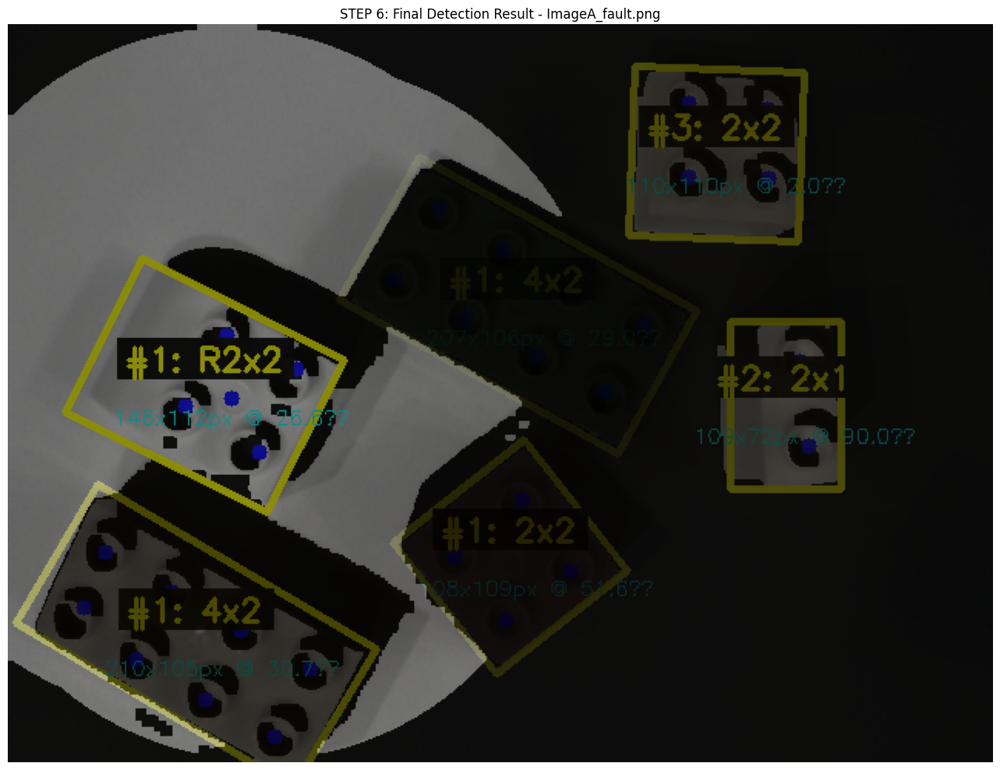

⚠ ImageA_fault.png: Faulty kit (closest: KitB)
   - Missing parts: 1x blue/R2x2
   - Unexpected parts (not in kit): 1x white/R2x2
   ✓ Brick #1: R2x2 - blue (4 studs)
   ✓ Brick #1: 4x2 - green (8 studs)
   ✓ Brick #1: 2x2 - red (4 studs)
   ✓ Brick #2: 4x2 - red (8 studs)
   ✓ Brick #1: 2x2 - yellow (4 studs)
   ✓ Brick #2: 2x1 - yellow (2 studs)


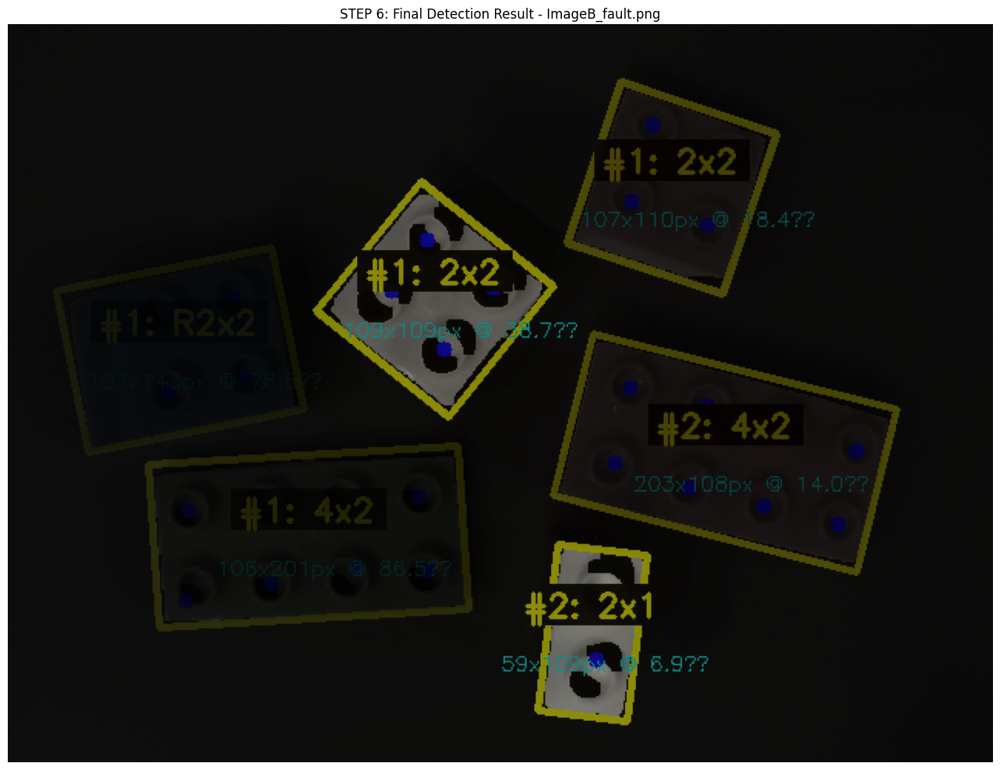

✓ ImageB_fault.png: Assigned to KitA
   ✓ Brick #1: 2x2 - blue (4 studs)
   ✓ Brick #2: 4x2 - blue (8 studs)
   ✓ Brick #3: 2x2 - blue (4 studs)
   ✓ Brick #1: 4x2 - green (8 studs)
   ✓ Brick #1: 4x2 - red (8 studs)
   ✓ Brick #1: 4x2 - yellow (8 studs)
   ✓ Brick #2: 2x2 - yellow (4 studs)


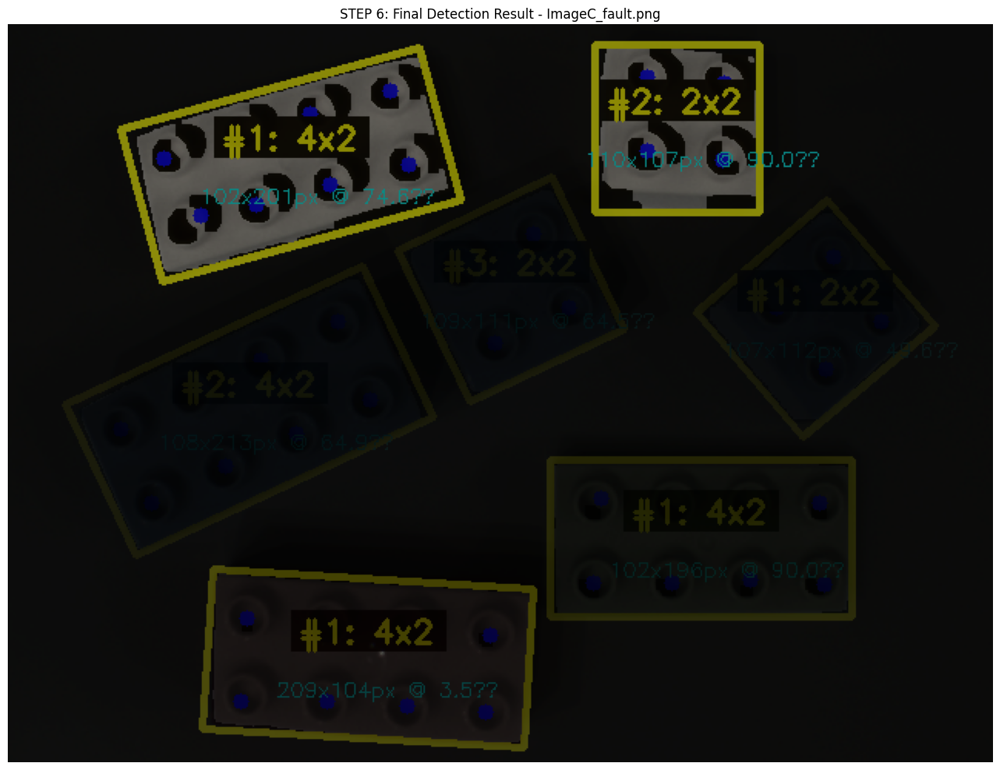

⚠ ImageC_fault.png: Faulty kit (closest: KitC)
   - Missing parts: 1x blue/6x2
   - Unexpected parts (not in kit): 2x blue/2x2
   ✓ Brick #1: 4x2 - blue (8 studs)
   ✓ Brick #2: 6x2 - blue (12 studs)
   ✓ Brick #1: 4x2 - green (8 studs)
   ✓ Brick #1: 4x2 - red (8 studs)
   ✓ Brick #1: 2x2 - yellow (4 studs)
   ✓ Brick #2: 4x2 - yellow (8 studs)


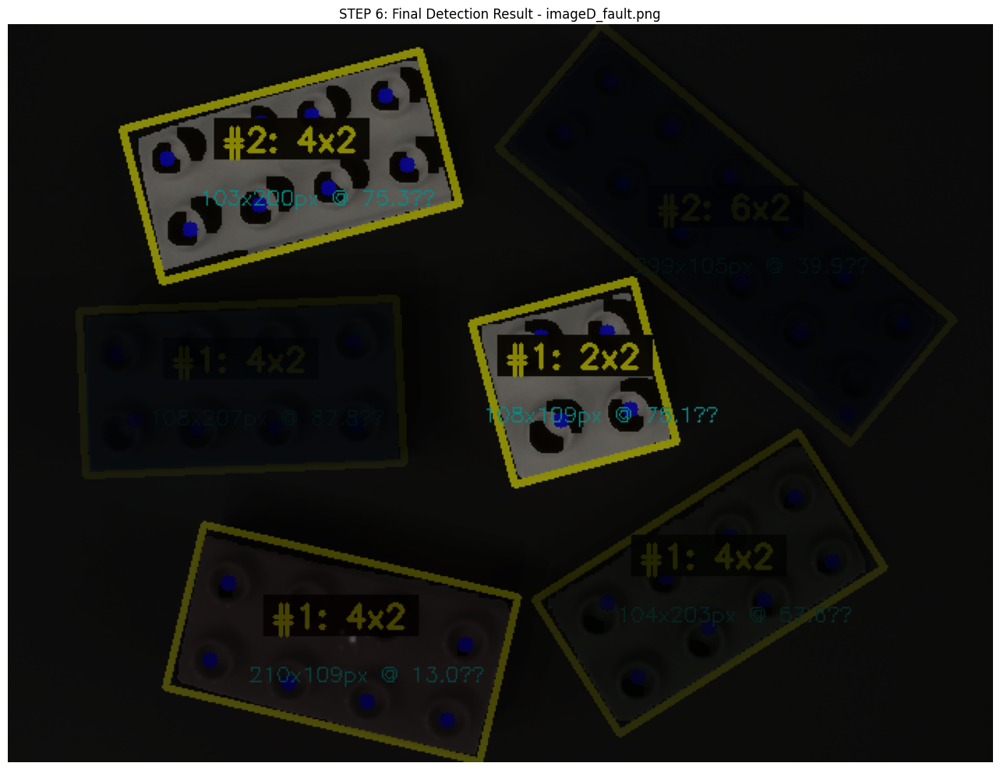

✓ imageD_fault.png: Assigned to KitC
   ✓ Brick #1: R2x2 - blue (4 studs)
   ✓ Brick #1: 4x2 - green (8 studs)
   ✓ Brick #1: 2x2 - red (4 studs)
   ✓ Brick #1: 4x2 - yellow (8 studs)
   ✓ Brick #2: 2x1 - yellow (2 studs)
   ✓ Brick #3: 2x2 - yellow (4 studs)


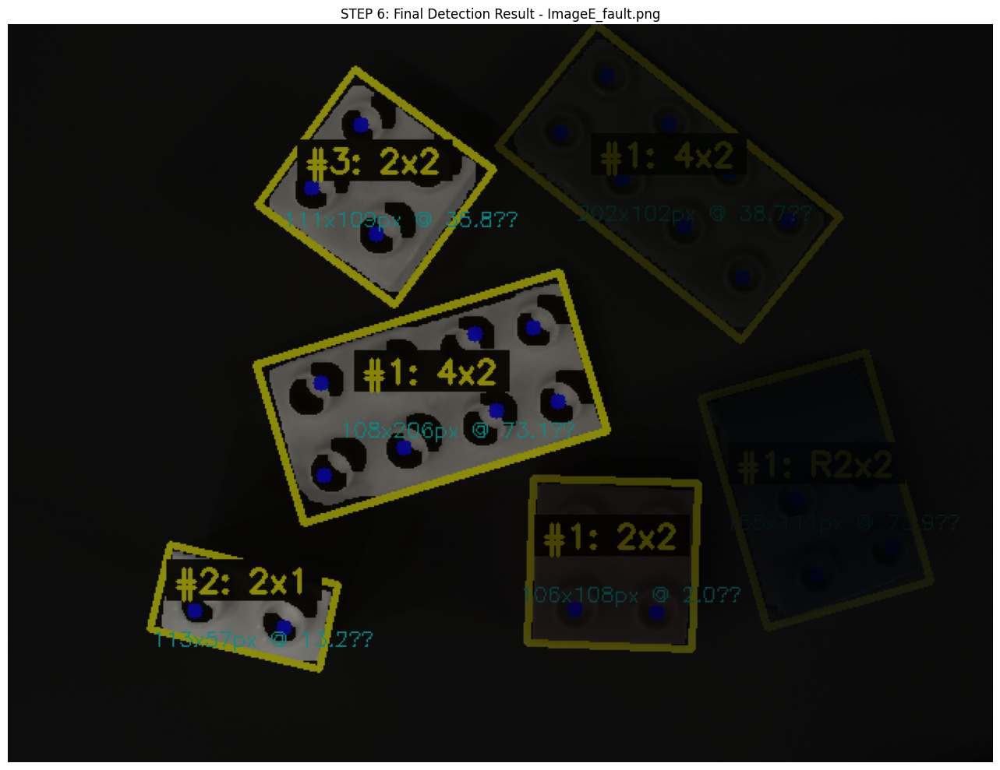

✓ ImageE_fault.png: Assigned to KitB
   ✓ Brick #1: 2x1 - blue (2 studs)
   ✓ Brick #2: R2x2 - blue (4 studs)
   ✓ Brick #1: 4x2 - green (8 studs)
   ✓ Brick #1: 2x2 - red (4 studs)
   ✓ Brick #2: 4x2 - red (8 studs)
   ✓ Brick #1: 2x2 - yellow (4 studs)
   ⚠ No studs detected for white


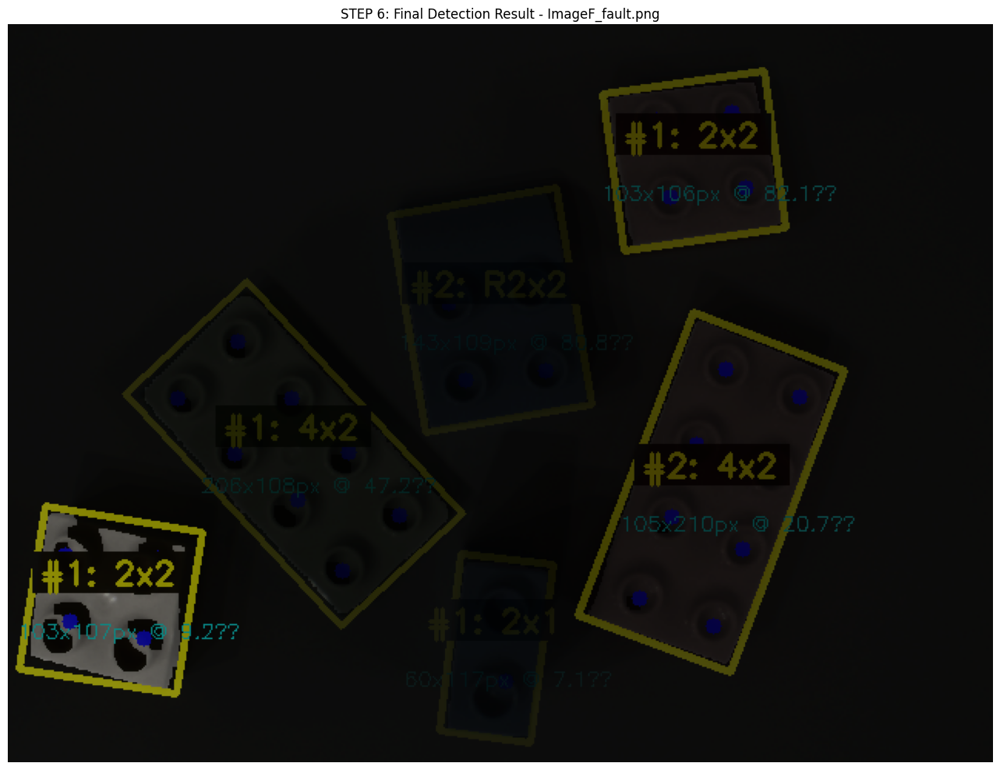

⚠ ImageF_fault.png: Faulty kit (closest: KitA)
   - Missing parts: 1x yellow/2x1
   - Unexpected parts (not in kit): 1x blue/2x1

=== FINAL SUMMARY ===
+------------------+------------------+--------------+---------------------------------------------------------------------------+--------------------------------------------------------------------------------------+
| Image            | Classification   | MatchedKit   | Causes                                                                    | Inventory                                                                            |
+==================+==================+==============+===========================================================================+======================================================================================+
| KitA             | Kit              | KitA         |                                                                           | 1x blue/R2x2, 1x green/4x2, 1x red/2x2, 1x red/4x2, 1x yellow/2

In [27]:
import os
import glob
import shutil
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA
from scipy.spatial import cKDTree
from collections import defaultdict
from collections import deque
from collections import Counter
from tabulate import tabulate



# ======= CONFIG =======
VALID_STUD_COUNTS = {"2x1": 2, "2x2": 4, "R2x2": 4, "4x2": 8, "6x2": 12}
STUD_MISS_TOL = 1
COLORS = ['blue', 'green', 'red', 'yellow', 'white']

# Clustering parameters
EPS_VALUE = 70
MIN_SAMPLES = 2
ROI_PADDING = 40
ASPECT_RATIO_THRESHOLD = 1.2

# Gradient filter parameters for yellow
GRADIENT_THRESHOLD = 3
GRAY_TOLERANCE = 15
MIN_REGION_SIZE = 300

# Distance-based filter parameters for white
GRADIENT_THRESHOLD_WHITE = 2
MAX_DISTANCE_FROM_STUD = 200  # Maximum distance in pixels from nearest stud
MIN_REGION_SIZE_WHITE = 500


# ======= STEP 0: SETUP =======
def reset_results():
    """Create fresh results directories"""
    base = "results/exercise_4"
    if os.path.exists(base):
        shutil.rmtree(base)
    os.makedirs("results/exercise_4/step1_color_masks", exist_ok=True)
    os.makedirs("results/exercise_4/step2_studs_detected", exist_ok=True)
    os.makedirs("results/exercise_4/step3_clusters", exist_ok=True)
    os.makedirs("results/exercise_4/step4_oriented_rois", exist_ok=True)
    os.makedirs("results/exercise_4/step5_refined_rois", exist_ok=True)
    os.makedirs("results/exercise_4/step6_final", exist_ok=True)

# ======= GLOBAL: Load background mask once =======
BACKGROUND_MASK = None

background_path = 'data/Calibration/background.png'
if not os.path.exists(background_path):
    print(f"Error: Background image not found at {background_path}")
    background_bgr = None
else:
    background_bgr = cv2.imread(background_path)
    if background_bgr is None:
        print(f"Error: Could not load background image from {background_path}")

def get_background_bgr(image_shape):
    global background_bgr
    if background_bgr is None:
        return np.zeros(image_shape[:2], dtype=np.uint8)

    if background_bgr.shape[:2] != image_shape[:2]:
        print(f"Warning: Background image shape {background_bgr.shape[:2]} does not match current image shape {image_shape[:2]}. Resizing background.")
        background_bgr_resized = cv2.resize(background_bgr, (image_shape[1], image_shape[0]))
    else:
        background_bgr_resized = background_bgr

    return background_bgr_resized


def apply_gradient_mask_yellow(gray_img, mask):
    """
    Apply gradient-based filtering to remove background regions.
    Detects sharp transitions, identifies low-value regions, and removes pixels
    until encountering another gradient edge.
    """
    masked_gray = cv2.bitwise_and(gray_img, gray_img, mask=mask)

    grad_x = cv2.Sobel(masked_gray, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(masked_gray, cv2.CV_64F, 0, 1, ksize=3)

    gradient_magnitude = np.sqrt(grad_x**2 + grad_y**2)
    gradient_magnitude = np.uint8(gradient_magnitude)

    high_gradient_mask = gradient_magnitude > GRADIENT_THRESHOLD

    h, w = gray_img.shape

    removal_candidates = np.zeros_like(mask, dtype=np.uint8)

    for y in range(1, h-1):
        for x in range(1, w-1):
            if high_gradient_mask[y, x] and mask[y, x] > 0:
                neighborhood = masked_gray[y-1:y+2, x-1:x+2]
                min_val = np.min(neighborhood[neighborhood > 0]) if np.any(neighborhood > 0) else 0

                if masked_gray[y, x] - min_val > GRADIENT_THRESHOLD:
                    removal_candidates[y, x] = 255

    kernel = np.ones((5, 5), np.uint8)
    removal_candidates = cv2.dilate(removal_candidates, kernel, iterations=2)

    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(
        removal_candidates, connectivity=8
    )

    removal_mask = np.zeros_like(mask, dtype=np.uint8)

    for label in range(1, num_labels):
        area = stats[label, cv2.CC_STAT_AREA]
        #print(f"Patch {label}: Area = {area} pixels")

        if area < MIN_REGION_SIZE:
            #print(f"  → Skipped (too small)")
            continue

        patch_mask = (labels == label).astype(np.uint8) * 255
        patch_pixels = masked_gray[patch_mask > 0]

        if len(patch_pixels) == 0:
            continue

        sorted_vals = np.sort(patch_pixels)
        low_threshold = sorted_vals[int(len(sorted_vals) * 0.25)]

        #print(f"  → Low threshold for this patch: {low_threshold}")

        x_patch, y_patch, w_patch, h_patch = stats[label, cv2.CC_STAT_LEFT:cv2.CC_STAT_LEFT+4]

        margin = 20
        y1 = max(0, y_patch - margin)
        y2 = min(h, y_patch + h_patch + margin)
        x1 = max(0, x_patch - margin)
        x2 = min(w, x_patch + w_patch + margin)

        local_gray = masked_gray[y1:y2, x1:x2]
        local_mask = mask[y1:y2, x1:x2]
        local_gradient = gradient_magnitude[y1:y2, x1:x2]

        seed_pixels = np.argwhere((local_gray > 0) & (local_gray <= low_threshold + GRAY_TOLERANCE) & (local_mask > 0))

        flood_mask = np.zeros(local_gray.shape, dtype=np.uint8)

        for seed_y, seed_x in seed_pixels:
            if flood_mask[seed_y, seed_x] > 0:
                continue

            queue = [(seed_y, seed_x)]
            flood_mask[seed_y, seed_x] = 255

            while queue:
                cy, cx = queue.pop(0)

                for dy in [-1, 0, 1]:
                    for dx in [-1, 0, 1]:
                        if dy == 0 and dx == 0:
                            continue

                        ny, nx = cy + dy, cx + dx

                        if ny < 0 or ny >= local_gray.shape[0] or nx < 0 or nx >= local_gray.shape[1]:
                            continue

                        if flood_mask[ny, nx] > 0 or local_mask[ny, nx] == 0:
                            continue

                        if local_gradient[ny, nx] > GRADIENT_THRESHOLD:
                            continue

                        if local_gray[ny, nx] > 0 and abs(int(local_gray[ny, nx]) - int(local_gray[cy, cx])) < GRAY_TOLERANCE * 2:
                            flood_mask[ny, nx] = 255
                            queue.append((ny, nx))

        removal_mask[y1:y2, x1:x2] = cv2.bitwise_or(
            removal_mask[y1:y2, x1:x2],
            flood_mask
        )

        #print(f"  → Removed {np.sum(flood_mask > 0)} pixels via flood-fill")

    enhanced_mask = cv2.bitwise_and(mask, cv2.bitwise_not(removal_mask))

    kernel_small = np.ones((3, 3), np.uint8)
    enhanced_mask = cv2.morphologyEx(enhanced_mask, cv2.MORPH_OPEN, kernel_small)
    enhanced_mask = cv2.morphologyEx(enhanced_mask, cv2.MORPH_CLOSE, np.ones((7, 7), np.uint8))

    return enhanced_mask


def apply_distance_based_white_filter(v_channel, mask, studs, filename_base):
    """
    NEW: Distance-based filtering for white bricks.
    Removes pixels that are far from detected studs, using gradient edges as boundaries.

    Args:
        v_channel: V channel from HSV (brightness)
        mask: Initial color mask for white
        studs: Detected stud positions (Nx2 array)
        filename_base: Base filename for debug output

    Returns:
        enhanced_mask: Filtered mask
        removal_candidates: Visualization of removed regions
    """
    #print(f"\n[WHITE FILTER] Applying distance-based filtering with {len(studs)} studs")

    if len(studs) == 0:
        #print("  → No studs detected, skipping distance filter")
        return mask, np.zeros_like(mask)

    # Apply initial mask to V channel
    masked_v = cv2.bitwise_and(v_channel, v_channel, mask=mask)

    # Apply bilateral filter to reduce noise
    v_filtered = cv2.bilateralFilter(masked_v, 9, 75, 75)

    # Compute gradients
    grad_v_x = cv2.Sobel(v_filtered, cv2.CV_64F, 1, 0, ksize=5)
    grad_v_y = cv2.Sobel(v_filtered, cv2.CV_64F, 0, 1, ksize=5)
    gradient_v = np.sqrt(grad_v_x**2 + grad_v_y**2)

    gradient_magnitude = cv2.normalize(gradient_v, None, 0, 255, cv2.NORM_MINMAX)
    gradient_magnitude = np.uint8(gradient_magnitude)

    high_gradient_mask = gradient_magnitude > GRADIENT_THRESHOLD_WHITE

    h, w = mask.shape

    # Build KD-tree for efficient distance queries to studs
    if len(studs) > 0:
        stud_tree = cKDTree(studs)
    else:
        return mask, np.zeros_like(mask)

    # Create distance map: for each pixel, find distance to nearest stud
    #print("  → Computing distance map to studs...")
    y_coords, x_coords = np.mgrid[0:h, 0:w]
    all_pixels = np.column_stack([x_coords.ravel(), y_coords.ravel()])

    # Only compute distances for masked pixels (efficiency)
    masked_indices = np.where(mask.ravel() > 0)[0]
    masked_pixels = all_pixels[masked_indices]

    if len(masked_pixels) == 0:
        return mask, np.zeros_like(mask)

    distances, _ = stud_tree.query(masked_pixels)

    # Create full distance map
    distance_map = np.full(h * w, np.inf)
    distance_map[masked_indices] = distances
    distance_map = distance_map.reshape(h, w)

    # Identify far pixels as removal candidates
    far_from_studs = distance_map > MAX_DISTANCE_FROM_STUD
    removal_candidates = (far_from_studs & (mask > 0)).astype(np.uint8) * 255

    #print(f"  → Found {np.sum(removal_candidates > 0)} pixels far from studs (>{MAX_DISTANCE_FROM_STUD}px)")

    # Find connected components in removal candidates
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(
        removal_candidates, connectivity=8
    )

    removal_mask = np.zeros_like(mask, dtype=np.uint8)

    #print(f"  → Processing {num_labels-1} distant regions...")

    for label in range(1, num_labels):
        area = stats[label, cv2.CC_STAT_AREA]

        if area < MIN_REGION_SIZE_WHITE:
            continue

        #print(f"    Region {label}: {area} pixels")

        patch_mask = (labels == label).astype(np.uint8) * 255

        x_patch, y_patch, w_patch, h_patch = stats[label, cv2.CC_STAT_LEFT:cv2.CC_STAT_LEFT+4]

        margin = 20
        y1 = max(0, y_patch - margin)
        y2 = min(h, y_patch + h_patch + margin)
        x1 = max(0, x_patch - margin)
        x2 = min(w, x_patch + w_patch + margin)

        local_v = v_filtered[y1:y2, x1:x2]
        local_mask = mask[y1:y2, x1:x2]
        local_gradient = gradient_magnitude[y1:y2, x1:x2]
        local_distance = distance_map[y1:y2, x1:x2]

        # Seed from pixels that are far from studs
        seed_pixels = np.argwhere(
            (local_distance > MAX_DISTANCE_FROM_STUD) &
            (local_mask > 0)
        )

        flood_mask = np.zeros(local_v.shape, dtype=np.uint8)

        for seed_y, seed_x in seed_pixels:
            if flood_mask[seed_y, seed_x] > 0:
                continue

            queue = [(seed_y, seed_x)]
            flood_mask[seed_y, seed_x] = 255

            while queue:
                cy, cx = queue.pop(0)

                for dy in [-1, 0, 1]:
                    for dx in [-1, 0, 1]:
                        if dy == 0 and dx == 0:
                            continue

                        ny, nx = cy + dy, cx + dx

                        if ny < 0 or ny >= local_v.shape[0] or nx < 0 or nx >= local_v.shape[1]:
                            continue

                        if flood_mask[ny, nx] > 0 or local_mask[ny, nx] == 0:
                            continue

                        # Stop at gradient edges
                        if local_gradient[ny, nx] > GRADIENT_THRESHOLD_WHITE:
                            continue

                        # Only expand to pixels also far from studs
                        if local_distance[ny, nx] > MAX_DISTANCE_FROM_STUD:
                            flood_mask[ny, nx] = 255
                            queue.append((ny, nx))

        removal_mask[y1:y2, x1:x2] = cv2.bitwise_or(
            removal_mask[y1:y2, x1:x2],
            flood_mask
        )

        #print(f"    → Removed {np.sum(flood_mask > 0)} pixels via distance-based flood-fill")

    enhanced_mask = cv2.bitwise_and(mask, cv2.bitwise_not(removal_mask))

    kernel_small = np.ones((3, 3), np.uint8)
    enhanced_mask = cv2.morphologyEx(enhanced_mask, cv2.MORPH_OPEN, kernel_small)
    enhanced_mask = cv2.morphologyEx(enhanced_mask, cv2.MORPH_CLOSE, np.ones((7, 7), np.uint8))

    # Save distance map visualization
    distance_map_vis = np.copy(distance_map)
    distance_map_vis[distance_map_vis == np.inf] = 0
    distance_map_vis = cv2.normalize(distance_map_vis, None, 0, 255, cv2.NORM_MINMAX)
    distance_map_vis = np.uint8(distance_map_vis)
    distance_map_colored = cv2.applyColorMap(distance_map_vis, cv2.COLORMAP_JET)

    # Overlay studs on distance map
    for (x, y) in studs:
        cv2.circle(distance_map_colored, (int(x), int(y)), 8, (255, 255, 255), 2)
        cv2.circle(distance_map_colored, (int(x), int(y)), 2, (0, 0, 0), -1)

    cv2.imwrite(f"results/exercise_4/step1_color_masks/white_distance_map_{filename_base}.png", distance_map_colored)
    #print(f"  ℹ️ Distance map saved: results/exercise_4/step1_color_masks/white_distance_map_{filename_base}.png")

    return enhanced_mask, removal_candidates


# ======= STEP 1: COLOR FILTERING =======

def create_color_mask(img_bgr, color, filename=None, studs=None):
    """Create HSV-based mask for each LEGO color"""
    hsv = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2HSV)

    if color == 'yellow':
        lower, upper = (15, 100, 120), (35, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))
        kernel = np.ones((7, 7), np.uint8)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)


        gray_img = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
        erode_kernel = np.ones((5,5), np.uint8)
        gray_img = cv2.erode(gray_img, erode_kernel, iterations=1)
        mask = apply_gradient_mask_yellow(gray_img, mask)
        return mask

    elif color == 'red':
        lower1, upper1 = (0, 120, 70), (10, 255, 255)
        lower2, upper2 = (170, 120, 70), (180, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower1), np.array(upper1)) | \
        cv2.inRange(hsv, np.array(lower2), np.array(upper2))
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, np.ones((7, 7), np.uint8))
        return mask

    elif color == 'blue':
        lower, upper = (90, 80, 50), (130, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))
        kernel = np.ones((7, 7), np.uint8)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
        return mask

    elif color == 'green':
        lower, upper = (40, 60, 50), (85, 255, 255)
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))
        kernel = np.ones((7, 7), np.uint8)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
        return mask

    elif color == 'white':
        lower, upper = (0, 0, 160), (180, 50, 220)
        mask = cv2.inRange(hsv, np.array(lower), np.array(upper))

        kernel = np.ones((3, 3), np.uint8)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
        mask_initial = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

        if filename:
            filename_base = filename.replace('.png', '').replace('.jpg', '')
        else:
            filename_base = "unknown_file"

        h_channel, s_channel, v_channel = cv2.split(hsv)

        # Apply distance-based filter if studs are provided
        if studs is not None and len(studs) > 0:
            final_mask, removal_candidates = apply_distance_based_white_filter(
                v_channel, mask_initial.copy(), studs, filename_base
            )
        else:
            #print("  ⚠ No studs provided for white filter, using initial mask")
            final_mask = mask_initial
            removal_candidates = np.zeros_like(mask_initial)

        # Save debug images
        cv2.imwrite(f"results/exercise_4/step1_color_masks/white_first_filter_{filename_base}.png", mask_initial)
        cv2.imwrite(f"results/exercise_4/step1_color_masks/white_removal_candidates_{filename_base}.png", removal_candidates)
        cv2.imwrite(f"results/exercise_4/step1_color_masks/white_final_gradient_mask_{filename_base}.png", final_mask)

        return final_mask


# ======= STEP 2: STUD DETECTION =======
def detect_studs_in_mask(gray_img, mask):
    """Detect circular studs within masked region using HoughCircles"""
    masked_gray = cv2.bitwise_and(gray_img, gray_img, mask=mask)
    masked_gray = cv2.medianBlur(masked_gray, 5)

    # Detect circles (studs)
    circles = cv2.HoughCircles(
        masked_gray,
        cv2.HOUGH_GRADIENT,
        dp=1.2,
        minDist=25,
        param1=90,
        param2=16,
        minRadius=6,
        maxRadius=20
    )

    if circles is None:
        return np.empty((0, 2), dtype=np.float32)

    circles = np.uint16(np.around(circles[0, :]))
    studs = circles[:, :2].astype(np.float32)
    valid_studs = studs.tolist()

    return np.array(valid_studs, dtype=np.float32) if valid_studs else np.empty((0, 2), dtype=np.float32)


def remove_duplicate_studs(studs, min_dist=8):
    """Remove studs that are too close together"""
    if len(studs) < 2:
        return studs

    keep = []
    used = np.zeros(len(studs), dtype=bool)

    for i in range(len(studs)):
        if used[i]:
            continue
        keep.append(studs[i])
        for j in range(i + 1, len(studs)):
            if np.linalg.norm(studs[i] - studs[j]) < min_dist:
                used[j] = True

    return np.array(keep, dtype=np.float32)


# ======= STEP 3: CLUSTERING =======
def cluster_studs_dbscan(studs):
    """Group studs into brick clusters using DBSCAN"""
    if len(studs) < 2:
        return np.array([-1] * len(studs))

    clustering = DBSCAN(eps=EPS_VALUE, min_samples=MIN_SAMPLES).fit(studs)
    labels = clustering.labels_

    n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
    #print(f"   → DBSCAN with eps={EPS_VALUE}, min_samples={MIN_SAMPLES}")
    #print(f"   → Found {n_clusters} clusters from {len(studs)} studs")

    return labels


# ======= STEP 4: STUD-BASED ORIENTATION =======
def get_stud_orientation(studs):
    """Determine the principal orientation of studs using PCA."""
    if len(studs) < 2:
        return 0.0, cv2.minAreaRect(studs)

    pca = PCA(n_components=2)
    pca.fit(studs)

    pc1 = pca.components_[0]
    angle_rad = np.arctan2(pc1[1], pc1[0])
    angle_deg = np.degrees(angle_rad)

    rect = cv2.minAreaRect(studs)

    return angle_deg, rect


def create_oriented_roi(studs, mask, padding=ROI_PADDING):
    """Create an oriented ROI based on stud alignment."""
    if len(studs) < 2:
        return None

    angle, rect = get_stud_orientation(studs)
    center, size, rect_angle = rect

    expanded_size = (size[0] + 2*padding, size[1] + 2*padding)
    expanded_rect = (center, expanded_size, rect_angle)

    box = cv2.boxPoints(expanded_rect)
    box = np.intp(box)

    return {
        'rect': expanded_rect,
        'box': box,
        'angle': rect_angle,
        'center': center,
        'size': expanded_size
    }


# ======= STEP 5: REFINED CONTOUR DETECTION =======
# Helper function to find the true edge near a corner
def flood_fill_from_borders(dilated_edges, debug_save_fn=None):
    """
    Masks pixels starting from ALL border pixels (entire perimeter), filling inward until hitting edge pixels.
    This creates a mask where the interior (brick) is preserved and background is removed.

    Args:
        dilated_edges: Binary edge image (255 = edge, 0 = non-edge)
        debug_save_fn: Optional function to save debug images

    Returns:
        Binary mask where 255 = interior region (brick), 0 = background
    """
    h, w = dilated_edges.shape

    # Create a mask for visited pixels (background)
    background_mask = np.zeros((h, w), dtype=np.uint8)

    # Create a copy to track what we've processed
    visited = np.zeros((h, w), dtype=bool)

    # Queue for flood fill (BFS approach)
    queue = deque()

    # Add ALL border pixels to the queue (entire perimeter)
    # Top border (all pixels in first row)
    for x in range(w):
        if dilated_edges[0, x] == 0:  # Not an edge pixel
            queue.append((0, x))
            visited[0, x] = True
            background_mask[0, x] = 255

    # Bottom border (all pixels in last row)
    for x in range(w):
        if dilated_edges[h-1, x] == 0:
            queue.append((h-1, x))
            visited[h-1, x] = True
            background_mask[h-1, x] = 255

    # Left border (all pixels in first column, excluding corners already done)
    for y in range(1, h-1):
        if dilated_edges[y, 0] == 0:
            queue.append((y, 0))
            visited[y, 0] = True
            background_mask[y, 0] = 255

    # Right border (all pixels in last column, excluding corners already done)
    for y in range(1, h-1):
        if dilated_edges[y, w-1] == 0:
            queue.append((y, w-1))
            visited[y, w-1] = True
            background_mask[y, w-1] = 255

    # Flood fill from all border pixels inward until we hit edge pixels
    directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]  # 4-connectivity

    while queue:
        y, x = queue.popleft()

        # Check all 4 neighbors
        for dy, dx in directions:
            ny, nx = y + dy, x + dx

            # Check bounds
            if 0 <= ny < h and 0 <= nx < w:
                # If not visited and not an edge pixel, add to queue
                if not visited[ny, nx] and dilated_edges[ny, nx] == 0:
                    visited[ny, nx] = True
                    background_mask[ny, nx] = 255
                    queue.append((ny, nx))

    if debug_save_fn:
        debug_save_fn("5a_background_mask", background_mask)

    # Invert to get the interior mask (brick region)
    interior_mask = cv2.bitwise_not(background_mask)

    if debug_save_fn:
        debug_save_fn("5b_interior_mask", interior_mask)


    return interior_mask


def find_rectangular_roi_candidates(roi_gray, min_area=500, max_area=50000, debug_save_fn=None):
    """
    Finds rectangular ROI candidates using Canny edge detection and flood fill masking.

    Args:
        roi_gray: Grayscale ROI image
        min_area: Minimum contour area to consider
        max_area: Maximum contour area to consider
        debug_save_fn: Optional function to save debug images

    Returns:
        List of candidate rectangles as dictionaries with 'rect', 'box', 'score' keys
    """
    candidates = []

    if debug_save_fn:
        debug_save_fn("2_input_roi", roi_gray)

    # Apply Canny edge detection with specified parameters
    edges = cv2.Canny(roi_gray, 20, 90, apertureSize=3, L2gradient=True)
    if debug_save_fn:
        debug_save_fn("3_canny_edges", edges)

    # Dilate edges with 2 iterations
    kernel = np.ones((3, 3), np.uint8)
    dilated_edges = cv2.dilate(edges, kernel, iterations=2)
    if debug_save_fn:
        debug_save_fn("4_dilated_edges", dilated_edges)

    # Flood fill from borders to mask background
    interior_mask = flood_fill_from_borders(dilated_edges, debug_save_fn)

    # Apply the interior mask to the original grayscale image
    masked_roi = cv2.bitwise_and(roi_gray, roi_gray, mask=interior_mask)
    if debug_save_fn:
        debug_save_fn("5d_masked_roi", masked_roi)

    masked_roi = cv2.erode(masked_roi, kernel, iterations=2)
    if debug_save_fn:
        debug_save_fn("5e_masked_roi_eroded", masked_roi)

    # Find contours from the interior mask
    contours, _ = cv2.findContours(masked_roi, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    print(f"  Found {len(contours)} contours from interior mask")

    # Visualize all found contours
    if debug_save_fn:
        contour_vis = cv2.cvtColor(roi_gray, cv2.COLOR_GRAY2BGR)
        cv2.drawContours(contour_vis, contours, -1, (0, 255, 0), 2)
        debug_save_fn("6_all_contours", contour_vis)

    # Process each contour
    for idx, contour in enumerate(contours):
        area = cv2.contourArea(contour)

        # Filter by area
        if area < min_area or area > max_area:
            #print(f"  Contour {idx}: area={area:.0f} - REJECTED (area out of range [{min_area}, {max_area}])")
            continue

        # Get the minimum area rectangle
        rect = cv2.minAreaRect(contour)
        box = cv2.boxPoints(rect)
        box = np.intp(box)

        # Calculate rectangularity score (how close to a perfect rectangle)
        rect_area = rect[1][0] * rect[1][1]
        rectangularity = area / rect_area if rect_area > 0 else 0

        # Calculate aspect ratio (should be reasonable for LEGO bricks)
        width, height = rect[1]
        aspect_ratio = max(width, height) / min(width, height) if min(width, height) > 0 else 0

        # Filter by rectangularity and aspect ratio
        if rectangularity > 0.2 and aspect_ratio < 5:  # Reasonable rectangle shape
            candidates.append({
                'rect': rect,
                'box': box,
                'score': rectangularity,
                'area': area,
                'aspect_ratio': aspect_ratio,
                'method': 'canny_edge_flood_fill'
            })
            #print(f"  Contour {idx}: area={area:.0f}, rectangularity={rectangularity:.3f}, aspect_ratio={aspect_ratio:.2f} - ACCEPTED")
        #else:
            #print(f"  Contour {idx}: area={area:.0f}, rectangularity={rectangularity:.3f}, aspect_ratio={aspect_ratio:.2f} - REJECTED (shape criteria)")

    #print(f"  Total candidates accepted: {len(candidates)}")

    return candidates


def refine_rectangle_edges(roi_gray, initial_rect, search_range=30):
    """
    Refines rectangle edges by searching for the strongest gradients along each edge.

    Args:
        roi_gray: Grayscale ROI image
        initial_rect: Initial rectangle ((center_x, center_y), (width, height), angle)
        search_range: Number of pixels to search inward/outward from each edge

    Returns:
        Refined rectangle in same format as initial_rect
    """
    # Get initial box points
    box_points = cv2.boxPoints(initial_rect)
    center = initial_rect[0]
    angle = initial_rect[2]
    width, height = initial_rect[1]

    # Compute gradients once for the entire image
    sobelx = cv2.Sobel(roi_gray, cv2.CV_64F, 1, 0, ksize=3)
    sobely = cv2.Sobel(roi_gray, cv2.CV_64F, 0, 1, ksize=3)
    gradient_mag = np.sqrt(sobelx**2 + sobely**2)

    # Refine each edge
    refined_edges = []

    for i in range(4):
        # Get edge endpoints
        p1 = box_points[i]
        p2 = box_points[(i + 1) % 4]

        # Edge direction vector
        edge_vec = p2 - p1
        edge_length = np.linalg.norm(edge_vec)
        edge_dir = edge_vec / edge_length if edge_length > 0 else edge_vec

        # Perpendicular vector (points inward)
        perp_vec = np.array([-edge_dir[1], edge_dir[0]])

        # Sample points along the edge
        num_samples = int(edge_length)
        best_offset = 0
        max_avg_gradient = -1

        # Search along the perpendicular direction
        for offset in range(-search_range, search_range + 1):
            gradients = []

            for j in range(num_samples):
                # Point along the edge
                t = j / num_samples
                point_on_edge = p1 + t * edge_vec

                # Offset point perpendicular to edge
                search_point = point_on_edge + offset * perp_vec

                x, y = int(search_point[0]), int(search_point[1])

                # Check bounds
                if 0 <= x < roi_gray.shape[1] and 0 <= y < roi_gray.shape[0]:
                    gradients.append(gradient_mag[y, x])

            # Average gradient along this offset line
            if gradients:
                avg_gradient = np.mean(gradients)
                if avg_gradient > max_avg_gradient:
                    max_avg_gradient = avg_gradient
                    best_offset = offset

        # Store refined edge with best offset
        refined_p1 = p1 + best_offset * perp_vec
        refined_p2 = p2 + best_offset * perp_vec
        refined_edges.append((refined_p1, refined_p2))

    # Reconstruct rectangle from refined edges
    # Use the refined corner points
    refined_corners = []
    for i in range(4):
        # Intersection of edge i and edge i-1
        corner = refined_edges[i][0]  # Start point of current edge
        refined_corners.append(corner)

    refined_corners = np.array(refined_corners, dtype=np.float32)

    # Fit minimum area rectangle to refined corners
    refined_rect = cv2.minAreaRect(refined_corners)

    return refined_rect


def refine_roi_with_contours_improved(img_bgr, gray_img, mask, roi_info, color, debug_id="", save_path="results/exercise_4/white_debug_images"):
    """
    Enhanced ROI refinement - uses advanced rectangle detection for white bricks,
    standard contour refinement for other colors.

    Args:
        img_bgr: Input BGR image
        gray_img: Grayscale image
        mask: Binary mask
        roi_info: Initial ROI information (can be None for white bricks)
        color: Color of brick ('white' or other)
        debug_id: Identifier for debug files
        save_path: Directory to save debug images

    Returns:
        Dictionary with 'rect', 'box', 'angle', 'center', 'size' or None if not found
    """
    os.makedirs(save_path, exist_ok=True)

    def debug_save(name, img):
        if color == 'white':
            filename = f"{save_path}/{debug_id}_{name.replace(' ', '_')}.png"
            if len(img.shape) == 2:
                img_to_save = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
            else:
                img_to_save = img.copy()
            cv2.imwrite(filename, img_to_save)

    # ====================================================================================
    # WHITE BRICK PROCESSING - Use Canny edge detection on roi_gray
    # ====================================================================================
    if color == 'white':
        #print(f"Refining white ROI {debug_id} with Canny edge detection.")

        # If roi_info is provided, use it to crop a focused ROI
        if roi_info is not None:
            # Use initial bounding box coordinates for cropping
            box = roi_info['box']
            x_init, y_init, w_init, h_init = cv2.boundingRect(box)

            # Safely crop coordinates with some padding
            padding = 5
            x_init = max(0, x_init - padding)
            y_init = max(0, y_init - padding)
            w_init = min(w_init + 2*padding, gray_img.shape[1] - x_init)
            h_init = min(h_init + 2*padding, gray_img.shape[0] - y_init)

            if w_init <= 0 or h_init <= 0:
                return roi_info

            roi_gray = gray_img[y_init:y_init+h_init, x_init:x_init+w_init]
            offset_x, offset_y = x_init, y_init
        else:
            # No initial roi_info, use the entire masked image
            if mask is not None:
                roi_gray = cv2.bitwise_and(gray_img, gray_img, mask=mask)
            else:
                roi_gray = gray_img
            offset_x, offset_y = 0, 0

        if roi_gray.size == 0:
            return roi_info

        debug_save("1_roi_gray_input", roi_gray)

        # Find candidate rectangles using Canny edge detection
        candidates = find_rectangular_roi_candidates(roi_gray, debug_save_fn=debug_save)

        if not candidates:
            print(f"No rectangular candidates found for {debug_id}")
            return roi_info  # Return original if available

        # Sort candidates by score (rectangularity)
        candidates.sort(key=lambda x: x['score'], reverse=True)

        # Visualize top candidates
        candidate_vis = cv2.cvtColor(roi_gray, cv2.COLOR_GRAY2BGR)
        for idx, candidate in enumerate(candidates[:5]):  # Show top 5
            color_vis = (0, 255, 0) if idx == 0 else (0, 165, 255)  # Green for best, orange for others
            cv2.drawContours(candidate_vis, [candidate['box']], 0, color_vis, 2)
            cv2.putText(candidate_vis, f"{candidate['score']:.2f}",
                       tuple(candidate['box'][0]), cv2.FONT_HERSHEY_SIMPLEX,
                       0.5, (255, 255, 255), 1)
        debug_save("7_top_candidates", candidate_vis)

        # Take the best candidate
        best_candidate = candidates[0]
        initial_rect_local = best_candidate['rect']

        # Refine edges using gradient search
        refined_rect_local = refine_rectangle_edges(roi_gray, initial_rect_local)

        # Visualize refined result
        refined_vis = cv2.cvtColor(roi_gray, cv2.COLOR_GRAY2BGR)
        refined_box = cv2.boxPoints(refined_rect_local)
        refined_box = np.intp(refined_box)
        cv2.drawContours(refined_vis, [refined_box], 0, (0, 255, 255), 3)
        debug_save("8_refined_rectangle", refined_vis)

        # Convert back to global coordinates
        refined_rect = (
            (refined_rect_local[0][0] + offset_x, refined_rect_local[0][1] + offset_y),
            refined_rect_local[1],
            refined_rect_local[2]
        )

        refined_box = cv2.boxPoints(refined_rect)
        refined_box = np.intp(refined_box)

        #print(f"✓ White brick detected: center={refined_rect[0]}, size={refined_rect[1]}, angle={refined_rect[2]:.1f}°")

        return {
            'rect': refined_rect,
            'box': refined_box,
            'angle': refined_rect[2],
            'center': refined_rect[0],
            'size': refined_rect[1]
        }

    # ====================================================================================
    # NON-WHITE BRICK PROCESSING - Use standard contour-based refinement
    # ====================================================================================
    if roi_info is None:
        return None

    # Use initial bounding box coordinates for cropping
    box = roi_info['box']
    x_init, y_init, w_init, h_init = cv2.boundingRect(box)

    # Safely crop coordinates
    x_init = max(0, x_init)
    y_init = max(0, y_init)
    w_init = min(w_init, gray_img.shape[1] - x_init)
    h_init = min(h_init, gray_img.shape[0] - y_init)

    if w_init <= 0 or h_init <= 0:
        return roi_info

    roi_gray = gray_img[y_init:y_init+h_init, x_init:x_init+w_init]
    roi_mask = mask[y_init:y_init+h_init, x_init:x_init+w_init]

    if roi_gray.size == 0:
        return roi_info

    # Standard processing for non-white bricks
    x, y, w, h = x_init, y_init, w_init, h_init

    kernel = np.ones((5, 5), np.uint8)
    enhanced_mask = cv2.morphologyEx(roi_mask, cv2.MORPH_CLOSE, kernel)
    enhanced_mask = cv2.morphologyEx(enhanced_mask, cv2.MORPH_DILATE, kernel, iterations=1)

    contours, _ = cv2.findContours(enhanced_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if not contours:
        return roi_info

    largest_contour = max(contours, key=cv2.contourArea)

    if cv2.contourArea(largest_contour) < 100:
        return roi_info

    refined_rect = cv2.minAreaRect(largest_contour)
    refined_box = cv2.boxPoints(refined_rect)
    refined_box[:, 0] += x
    refined_box[:, 1] += y
    refined_box = np.intp(refined_box)

    center = (refined_rect[0][0] + x, refined_rect[0][1] + y)

    return {
        'rect': (center, refined_rect[1], refined_rect[2]),
        'box': refined_box,
        'angle': refined_rect[2],
        'center': center,
        'size': refined_rect[1]
    }

def classify_brick_by_studs(n_studs, rect_size):
    """Classify brick type based on stud count and dimensions."""
    valid_counts = [2, 4, 8, 12]
    closest = min(valid_counts, key=lambda x: abs(x - n_studs))

    if abs(closest - n_studs) > STUD_MISS_TOL:
        return "unknown"

    if closest == 2:
        return "2x1"
    elif closest == 4:
        width, height = rect_size
        if width == 0 or height == 0:
            return "2x2"

        aspect_ratio = max(width, height) / min(width, height)

        if aspect_ratio > ASPECT_RATIO_THRESHOLD:
            return "R2x2"
        else:
            return "2x2"
    elif closest == 8:
        return "4x2"
    elif closest == 12:
        return "6x2"

    return "unknown"


# ======= STEP 6: MAIN PIPELINE =======
def process_image(img_path, color):
    """Process single image for one color"""
    img = cv2.imread(img_path)
    if img is None:
        return None

    filename = os.path.basename(img_path)
    results = {
        'bricks': [],
        'visualizations': {},
        'studs': None
    }

    # print(f"\n{'='*60}")
    # print(f"Processing: {filename} - Color: {color.upper()}")
    # print(f"{'='*60}")

    # # STEP 1: Initial Color Masking (without studs for white)
    # print(f"\n[STEP 1] Creating initial {color} color mask...")

    # For white, we'll create initial mask without studs, then refine after detecting studs
    if color == 'white':
        hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        lower, upper = (0, 0, 140), (180, 50, 220)
        mask_initial = cv2.inRange(hsv, np.array(lower), np.array(upper))
        kernel = np.ones((3, 3), np.uint8)
        mask = cv2.morphologyEx(mask_initial, cv2.MORPH_CLOSE, kernel)
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    else:
        mask = create_color_mask(img, color, filename)

    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray_filtered = cv2.bitwise_and(gray_img, gray_img, mask=mask)

    mask_vis = cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR)
    overlay = cv2.addWeighted(img, 0.7, mask_vis, 0.3, 0)
    results['visualizations']['mask'] = overlay

    cv2.imwrite(f"results/exercise_4/step1_color_masks/{color}_{filename}", overlay)

    # plt.figure(figsize=(16, 6))
    # plt.subplot(1, 3, 1)
    # plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    # plt.title(f'Original Image', fontsize=12, fontweight='bold')
    # plt.axis('off')

    # plt.subplot(1, 3, 2)
    # plt.imshow(mask, cmap='gray')
    # plt.title(f'STEP 1: {color.upper()} Color Mask', fontsize=12, fontweight='bold')
    # plt.axis('off')

    # plt.subplot(1, 3, 3)
    # plt.imshow(gray_filtered, cmap='gray')
    # plt.title(f'Masked Grayscale', fontsize=12, fontweight='bold')
    # plt.axis('off')

    # plt.tight_layout()
    # plt.savefig(f"results/step1_color_masks/plot_{color}_{filename}")
    # plt.show()

    # STEP 2: Stud Detection
    # print(f"\n[STEP 2] Detecting studs in {color} regions...")
    studs = detect_studs_in_mask(gray_filtered, mask)
    studs = remove_duplicate_studs(studs, min_dist=10)

    if len(studs) == 0:
        print(f"   ⚠ No studs detected for {color}")
        return results

    # print(f"   ✓ Detected {len(studs)} circular studs")
    results['studs'] = studs

    # For white color, NOW apply the distance-based filter with detected studs
    if color == 'white':
        # print(f"\n[STEP 2.5] Refining white mask with distance-based filter...")
        mask = create_color_mask(img, color, filename, studs=studs)
        gray_filtered = cv2.bitwise_and(gray_img, gray_img, mask=mask)

        # Update visualization
        mask_vis = cv2.cvtColor(mask, cv2.COLOR_GRAY2BGR)
        overlay = cv2.addWeighted(img, 0.7, mask_vis, 0.3, 0)
        cv2.imwrite(f"results/exercise_4/step1_color_masks/{color}_refined_{filename}", overlay)

    # Visualize studs
    stud_vis = cv2.cvtColor(gray_filtered, cv2.COLOR_GRAY2BGR)
    for (x, y) in studs:
        cv2.circle(stud_vis, (int(x), int(y)), 8, (0, 255, 0), 2)
        cv2.circle(stud_vis, (int(x), int(y)), 2, (0, 0, 255), 3)

    results['visualizations']['studs'] = stud_vis
    cv2.imwrite(f"results/exercise_4/step2_studs_detected/{color}_{filename}", stud_vis)

    # plt.figure(figsize=(10, 8))
    # plt.imshow(cv2.cvtColor(stud_vis, cv2.COLOR_BGR2RGB))
    # plt.title(f'STEP 2: Detected {len(studs)} Studs', fontsize=13, fontweight='bold')
    # plt.axis('off')
    # plt.tight_layout()
    # plt.savefig(f"results/step2_studs_detected/plot_{color}_{filename}")
    # plt.show()

    # STEP 3: Clustering
    # print(f"\n[STEP 3] Clustering studs into bricks...")
    labels = cluster_studs_dbscan(studs)
    unique_labels = set(labels)
    unique_labels.discard(-1)
    n_clusters = len(unique_labels)

    #print(f"   ✓ Identified {n_clusters} potential bricks")

    # Visualize clusters
    cluster_vis = cv2.cvtColor(gray_filtered, cv2.COLOR_GRAY2BGR)
    colors_palette = [
        (255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0),
        (255, 0, 255), (0, 255, 255), (255, 128, 0), (128, 0, 255)
    ]

    for idx, label in enumerate(sorted(unique_labels)):
        cluster_studs = studs[labels == label]
        vis_color = colors_palette[idx % len(colors_palette)]

        for (x, y) in cluster_studs:
            cv2.circle(cluster_vis, (int(x), int(y)), 8, vis_color, -1)
            cv2.circle(cluster_vis, (int(x), int(y)), 10, (255, 255, 255), 2)

    cv2.imwrite(f"results/exercise_4/step3_clusters/{color}_{filename}", cluster_vis)

    # plt.figure(figsize=(12, 9))
    # plt.imshow(cv2.cvtColor(cluster_vis, cv2.COLOR_BGR2RGB))
    # plt.title(f'STEP 3: {n_clusters} Clusters', fontsize=13, fontweight='bold')
    # plt.axis('off')
    # plt.tight_layout()
    # plt.savefig(f"results/step3_clusters/plot_{color}_{filename}")
    # plt.show()

    # STEP 4: Create Oriented ROIs
    # print(f"\n[STEP 4] Creating oriented ROIs based on stud alignment...")
    oriented_roi_vis = cv2.cvtColor(gray_filtered, cv2.COLOR_GRAY2BGR)

    brick_rois = []
    for idx, label in enumerate(sorted(unique_labels)):
        cluster_studs = studs[labels == label]
        n_studs_in_cluster = len(cluster_studs)

        if n_studs_in_cluster < 2:
            continue

        roi_info = create_oriented_roi(cluster_studs, mask, padding=ROI_PADDING)

        if roi_info is None:
            continue

        brick_rois.append((label, cluster_studs, roi_info, n_studs_in_cluster))

        cv2.drawContours(oriented_roi_vis, [roi_info['box']], 0, (255, 0, 255), 2)
        cv2.putText(oriented_roi_vis, f'ROI #{idx+1}',
                   tuple(roi_info['box'][0]),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 255), 2)

        for (x, y) in cluster_studs:
            cv2.circle(oriented_roi_vis, (int(x), int(y)), 5, (0, 255, 255), -1)

    cv2.imwrite(f"results/exercise_4/step4_oriented_rois/{color}_{filename}", oriented_roi_vis)

    # plt.figure(figsize=(12, 9))
    # plt.imshow(cv2.cvtColor(oriented_roi_vis, cv2.COLOR_BGR2RGB))
    # plt.title(f'STEP 4: Stud-Aligned Oriented ROIs', fontsize=13, fontweight='bold')
    # plt.axis('off')
    # plt.tight_layout()
    # plt.savefig(f"results/step4_oriented_rois/plot_{color}_{filename}")
    # plt.show()

    # STEP 5: Refine ROIs
    # print(f"\n[STEP 5] Refining ROIs with contour detection...")
    final_roi_vis = cv2.cvtColor(gray_filtered, cv2.COLOR_GRAY2BGR)

    brick_counter = 0
    for label, cluster_studs, roi_info, n_studs in brick_rois:
        refined_roi = refine_roi_with_contours_improved(img, gray_filtered, mask, roi_info, color)

        if refined_roi is None:
            continue

        brick_counter += 1

        width, height = refined_roi['size']
        brick_type = classify_brick_by_studs(n_studs, refined_roi['size'])

        cv2.drawContours(final_roi_vis, [refined_roi['box']], 0, (0, 255, 255), 3)

        for (x, y) in cluster_studs:
            cv2.circle(final_roi_vis, (int(x), int(y)), 5, (255, 0, 0), -1)

        center = tuple(map(int, refined_roi['center']))
        label_text = f"#{brick_counter}: {brick_type}"

        text_size = cv2.getTextSize(label_text, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2)[0]
        cv2.rectangle(final_roi_vis,
                     (center[0]-text_size[0]//2-5, center[1]-text_size[1]-15),
                     (center[0]+text_size[0]//2+5, center[1]-5),
                     (0, 0, 0), -1)

        cv2.putText(final_roi_vis, label_text,
                   (center[0]-text_size[0]//2, center[1]-10),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 255), 2)

        angle = refined_roi['angle']
        aspect_ratio = max(width, height) / min(width, height)
        dim_text = f"{width:.0f}x{height:.0f}px @ {angle:.1f}°"
        cv2.putText(final_roi_vis, dim_text,
                   (center[0]-60, center[1]+25),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.45, (255, 255, 0), 1)

        results['bricks'].append({
            'color': color,
            'type': brick_type,
            'studs': n_studs,
            'center': refined_roi['center'],
            'size': refined_roi['size'],
            'angle': angle,
            'aspect_ratio': aspect_ratio
        })

        print(f"   ✓ Brick #{brick_counter}: {brick_type} - {color} ({n_studs} studs)")

    results['visualizations']['rois'] = final_roi_vis
    cv2.imwrite(f"results/exercise_4/step5_refined_rois/{color}_{filename}", final_roi_vis)

    # plt.figure(figsize=(14, 10))
    # plt.imshow(cv2.cvtColor(final_roi_vis, cv2.COLOR_BGR2RGB))
    # plt.title(f'STEP 5: Refined ROIs', fontsize=14, fontweight='bold')
    # plt.axis('off')
    # plt.tight_layout()
    # plt.savefig(f"results/step5_refined_rois/plot_{color}_{filename}")
    # plt.show()

    return results


def process_single_image(img_path):
    """Process a single image for all colors"""
    reset_results()

    if not os.path.exists(img_path):
        print(f"❌ Error: Image not found at {img_path}")
        return

    filename = os.path.basename(img_path)
    print(f"\n\n{'#'*70}")
    print(f"# PROCESSING IMAGE: {filename}")
    print(f"{'#'*70}")

    img = cv2.imread(img_path)
    if img is None:
        print(f"❌ Error: Could not read image")
        return

    final_vis = img.copy()
    all_bricks = defaultdict(list)

    for color in COLORS:
        result = process_image(img_path, color)

        if result and result['bricks']:
            all_bricks[color].extend(result['bricks'])

            if 'rois' in result['visualizations']:
                roi_vis = result['visualizations']['rois']
                if len(roi_vis.shape) == 2:
                    roi_vis = cv2.cvtColor(roi_vis, cv2.COLOR_GRAY2BGR)
                final_vis = cv2.addWeighted(final_vis, 0.5, roi_vis, 0.5, 0)

    cv2.imwrite(f"results/exercise_4/step6_final/final_{filename}", final_vis)

    plt.figure(figsize=(14, 10))
    plt.imshow(cv2.cvtColor(final_vis, cv2.COLOR_BGR2RGB))
    plt.title(f"STEP 6: Final Detection Result - {filename}")
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(f"results/step6_final/plot_{filename}")
    plt.show()

    # Print summary
    print(f"\n\n{'='*70}")
    print("DETECTION SUMMARY")
    print(f"{'='*70}\n")

    summary_data = []
    total_bricks = 0

    for color in COLORS:
        bricks = all_bricks[color]
        if not bricks:
            continue

        print(f"\n{color.upper()}:")
        print("-" * 40)

        type_counts = defaultdict(int)
        for brick in bricks:
            type_counts[brick['type']] += 1

        for brick_type, count in sorted(type_counts.items()):
            print(f"  {brick_type}: {count} pieces")
            summary_data.append({
                'Color': color,
                'Type': brick_type,
                'Count': count
            })

        color_total = len(bricks)
        print(f"  SUBTOTAL: {color_total} pieces")
        total_bricks += color_total

    print(f"\n{'='*70}")
    print(f"TOTAL BRICKS DETECTED: {total_bricks}")
    print(f"{'='*70}")

    if summary_data:
        df_summary = pd.DataFrame(summary_data)
        pivot = df_summary.pivot_table(
            index='Type',
            columns='Color',
            values='Count',
            fill_value=0
        )
        pivot['TOTAL'] = pivot.sum(axis=1)

        print(f"\n\nSUMMARY TABLE:")
        print("-" * 70)
        print(pivot.to_string())

        pivot.to_csv("results/summary.csv")
        print(f"\n✅ Summary saved to results/summary.csv")

    print(f"\n✅ All results saved to results/ folder")

def results_to_inventory(results_by_color):
    """
    Converte a saída de detecção por cor em um inventário no formato:
    Counter({(color, type): count})
    """
    inv = Counter()
    for color, bricks in results_by_color.items():
        for b in bricks:
            # ignora 'unknown' (podes remover esta linha se quiseres contar mesmo assim)
            if b['type'] == 'unknown':
                continue
            inv[(color, b['type'])] += 1
    return inv


def detect_inventory(img_path, visualize=False):
    """
    Roda a pipeline por cor, devolve:
      - inventory: Counter((color, type) -> count)
      - raw: dict(color -> list of brick dicts))
      - (if visualize=True) prints and saves the final step 6 visualization
    """
    if not os.path.exists(img_path):
        raise FileNotFoundError(img_path)

    filename = os.path.basename(img_path)
    img = cv2.imread(img_path)
    if img is None:
        raise IOError(f"Could not read image: {img_path}")

    all_bricks = defaultdict(list)
    final_vis = img.copy()

    for color in COLORS:
        # uso do teu process_image
        result = process_image(img_path, color)

        if result and result['bricks']:
            all_bricks[color].extend(result['bricks'])

            # --- ADDED CODE BLOCK FOR VISUALIZATION ---
            if visualize and 'rois' in result['visualizations']:
                roi_vis = result['visualizations']['rois']
                if len(roi_vis.shape) == 2:
                    roi_vis = cv2.cvtColor(roi_vis, cv2.COLOR_GRAY2BGR)

                # Check if current visualization is of the same size, if not, resize (safeguard)
                if final_vis.shape[:2] != roi_vis.shape[:2]:
                     # This should not happen if the pipeline is consistent, but is a good practice
                     print(f"⚠️ Warning: Resizing visualization for {color}")
                     roi_vis = cv2.resize(roi_vis, (final_vis.shape[1], final_vis.shape[0]))

                # Blend the visualization for the current color
                final_vis = cv2.addWeighted(final_vis, 0.5, roi_vis, 0.5, 0)
            # --- END ADDED CODE BLOCK ---

    # --- ADDED CODE BLOCK FOR FINAL VISUALIZATION SAVE/SHOW ---
    if visualize:
        # Ensure results/exercise_4/step6_final exists before saving
        os.makedirs("results/exercise_4/step6_final", exist_ok=True)

        # Save the OpenCV image
        cv2.imwrite(f"results/exercise_4/step6_final/final_{filename}", final_vis)

        # Plot the image using Matplotlib and save the plot
        plt.figure(figsize=(14, 10))
        # OpenCV reads as BGR, Matplotlib shows as RGB
        plt.imshow(cv2.cvtColor(final_vis, cv2.COLOR_BGR2RGB))
        plt.title(f"STEP 6: Final Detection Result - {filename}")
        plt.axis('off')
        plt.tight_layout()

        # Ensure results/exercise_4/step6_final exists before saving the plot
        os.makedirs("results/exercise_4/step6_final", exist_ok=True)
        plt.savefig(f"results/exercise_4/step6_final/plot_{filename}")
        plt.show()

    # --- END ADDED CODE BLOCK ---

    inventory = results_to_inventory(all_bricks)
    return inventory, all_bricks


def compare_inventories(fault_inv, kit_inv):
    """
    Compara inventário da imagem Fault com o inventário do Kit.
    Retorna:
      - is_perfect_match: bool
      - diff: Counter (fault - kit) por (color, type)
      - causes: lista de strings descrevendo as falhas
    """
    # diferença (positiva = a mais na fault; negativa = falta na fault)
    diff = fault_inv.copy()
    for key, v in kit_inv.items():
        diff[key] -= v
    # completar chaves do kit que não aparecem na fault_inv (ficam negativas)
    for key in kit_inv:
        if key not in fault_inv:
            diff[key] -= 0  # garante presença no Counter

    missing = []
    surplus = []
    unexpected = []  # peças não especificadas no kit

    kit_keys = set(kit_inv.keys())
    for key, d in diff.items():
        if d < 0:
            missing.append((key, -d))
        elif d > 0:
            if key in kit_keys:
                surplus.append((key, d))
            else:
                unexpected.append((key, d))

    causes = []
    if missing:
        parts = ", ".join([f"{n}x {c}/{t}" for (c, t), n in missing])
        causes.append(f"Missing parts: {parts}")
    if surplus:
        parts = ", ".join([f"{n}x {c}/{t}" for (c, t), n in surplus])
        causes.append(f"Surplus parts (specified type): {parts}")
    if unexpected:
        parts = ", ".join([f"{n}x {c}/{t}" for (c, t), n in unexpected])
        causes.append(f"Unexpected parts (not in kit): {parts}")

    is_perfect_match = (len(missing) == 0 and len(surplus) == 0 and len(unexpected) == 0)
    return is_perfect_match, diff, causes


def best_kit_match(fault_inv, kits):
    """
    Decide o melhor kit para a imagem de Fault.
    Regra:
      - Se match perfeito com algum kit -> classifica nesse kit.
      - Caso contrário -> Faulty kit e reporta causas do kit mais próximo (menor soma de abs(diff)).
    Retorna: classification, matched_kit_name_or_None, causes (lista)
    """
    # 1) procurar match perfeito
    for kit_name, kit_inv in kits.items():
        is_ok, diff, causes = compare_inventories(fault_inv, kit_inv)
        if is_ok:
            return "Assigned to Kit", kit_name, []

    # 2) escolher o mais “próximo”
    best = None
    best_score = float('inf')
    best_causes = None
    best_kit = None

    for kit_name, kit_inv in kits.items():
        _, diff, causes = compare_inventories(fault_inv, kit_inv)
        score = sum(abs(v) for v in diff.values())
        if score < best_score:
            best = diff
            best_score = score
            best_causes = causes
            best_kit = kit_name

    return "Faulty kit", best_kit, best_causes or ["Unspecified discrepancy"]


def inventory_to_string(inv):
    if not inv:
        return "(empty)"
    parts = [f"{n}x {c}/{t}" for (c, t), n in sorted(inv.items())]
    return ", ".join(parts)


if __name__ == "__main__":
    reset_results()

    # 1) Assinaturas dos kits
    kit_paths = {
        "KitA": "./data/Fault/kitA.png",
        "KitB": "./data/Fault/kitB.png",
        "KitC": "./data/Fault/kitC.png",
    }

    kits = {}
    print("\n=== Building kit signatures ===")
    for kname, path in kit_paths.items():
        inv, _ = detect_inventory(path, visualize=True)
        kits[kname] = inv
        print(f"{kname}: {inventory_to_string(inv)}")

    # Prepare rows and include kits in the summary
    rows = []
    for kname, inv in kits.items():
        rows.append({
            "Image": kname,
            "Classification": "Kit",           # or "Reference kit"
            "MatchedKit": kname,
            "Causes": "",
            "Inventory": inventory_to_string(inv)
        })

    # 2) Classificar imagens Fault A..F
    fault_images = [
        "./data/Fault/ImageA_fault.png",
        "./data/Fault/ImageB_fault.png",
        "./data/Fault/ImageC_fault.png",
        "./data/Fault/imageD_fault.png",
        "./data/Fault/ImageE_fault.png",
        "./data/Fault/ImageF_fault.png",
    ]

    print("\n=== Classifying fault images ===")
    for fpath in fault_images:
        fname = os.path.basename(fpath)
        try:
            finv, _ = detect_inventory(fpath, visualize=True)
        except FileNotFoundError:
            print(f"❌ Not found: {fpath}")
            rows.append({
                "Image": fname,
                "Classification": "Error",
                "MatchedKit": "",
                "Causes": "File not found",
                "Inventory": ""
            })
            continue

        classification, matched_kit, causes = best_kit_match(finv, kits)
        if classification == "Assigned to Kit":
            print(f"✓ {fname}: Assigned to {matched_kit}")
        else:
            print(f"⚠ {fname}: Faulty kit (closest: {matched_kit})")
            if causes:
                for c in causes:
                    print(f"   - {c}")

        rows.append({
            "Image": fname,
            "Classification": classification if classification == "Assigned to Kit" else "Faulty kit",
            "MatchedKit": matched_kit if classification == "Assigned to Kit" else matched_kit + "_faulty",
            "Causes": "; ".join(causes) if causes else "",
            "Inventory": inventory_to_string(finv)
        })

    # 3) Tabela final
    df = pd.DataFrame(rows, columns=["Image", "Classification", "MatchedKit", "Causes", "Inventory"])

    # opcional: ordenar para mostrar KitA, KitB, KitC primeiro
    order = {"KitA": 0, "KitB": 1, "KitC": 2}
    df["__order__"] = df["Image"].map(order).fillna(1000)
    df = df.sort_values(["__order__", "Image"]).drop(columns="__order__")

    os.makedirs("results/exercise_4", exist_ok=True)
    out_csv = "results/exercise_4/fault_classification_summary.csv"
    df.to_csv(out_csv, index=False, encoding="utf-8")
    print(f"\n=== FINAL SUMMARY ===")
    print(df.to_markdown(index=False, tablefmt="grid"))
    print(f"\n✅ Saved: {out_csv}")
